<a href="https://colab.research.google.com/github/TAFFI98/Real2Sim_ROS_Doosan/blob/main/cvae_burr_to_contour.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Convolutional Variational Autoencoder

## Setup

In [ ]:
import glob
import imageio
import numpy as np
from sklearn.decomposition import PCA
import cv2
from IPython.display import display, clear_output, HTML, Image as Image_display
import base64
import PIL
from PIL import Image
import tensorflow as tf
from tensorflow.keras.layers import (InputLayer, Conv2D, Conv2DTranspose,
            BatchNormalization,ReLU, LeakyReLU, Dropout, MaxPooling2D, UpSampling2D,
            Reshape, GlobalAveragePooling2D, Layer, Conv2D, Dense, Flatten)
from tensorflow.keras.models import Model
from tensorflow.keras.losses import binary_crossentropy
from tensorflow.keras import backend as K
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import plot_model
from tensorflow.keras.callbacks import ModelCheckpoint
import matplotlib.pyplot as plt
import time
import gc
import os
import io
from functools import reduce
import ipywidgets as widgets


## Loading the datasets

In [ ]:
# Mount drive
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


### Loading functions and datset management

In [ ]:
def parse_tfrecord_fn(example_proto):
    feature_description = {
        'image1': tf.io.FixedLenFeature([], tf.string),
        'image2': tf.io.FixedLenFeature([], tf.string),
    }
    example = tf.io.parse_single_example(example_proto, feature_description)

    # Decode the JPEG images
    image1 = tf.io.decode_jpeg(example['image1'], channels=1)  # Assuming grayscale images
    image2 = tf.io.decode_jpeg(example['image2'], channels=1)  # Assuming grayscale images

    # Normalize the images if needed
    image1 = tf.cast(image1, tf.float32) / 255.0
    image2 = tf.cast(image2, tf.float32) / 255.0

    # Expand the dimensions
    image1 = tf.expand_dims(image1, axis=0)
    image2 = tf.expand_dims(image2, axis=0)

    return image1, image2
def parse_tfrecord_fn_cgan(example_proto):
    feature_description = {
        'image1': tf.io.FixedLenFeature([], tf.string),
        'image2': tf.io.FixedLenFeature([], tf.string),
    }
    example = tf.io.parse_single_example(example_proto, feature_description)

    # Decode the JPEG images
    image1 = tf.io.decode_jpeg(example['image1'], channels=3)  # Assuming rgb images
    image2 = tf.io.decode_jpeg(example['image2'], channels=1)  # Assuming grayscale images

    # Normalize the images if needed
    image1 = tf.cast(image1, tf.float32) / 255.0
    image2 = tf.cast(image2, tf.float32) / 255.0

    # Expand the dimensions
    image1 = tf.expand_dims(image1, axis=0)
    image2 = tf.expand_dims(image2, axis=0)

    return image1, image2
def load_dataset_from_tfrecord(filename, type):
    dataset = tf.data.TFRecordDataset(filename)
    if type == 'cgan':
      dataset = dataset.map(parse_tfrecord_fn_cgan, num_parallel_calls=tf.data.AUTOTUNE)
    elif type == 'vae':
      dataset = dataset.map(parse_tfrecord_fn, num_parallel_calls=tf.data.AUTOTUNE)
    return dataset

In [ ]:
# Check dataset info
def check_dataset_info(dataset, name_dataset, return_length=False):
  dataset_length = dataset.reduce(0, lambda x, _: x + 1) # to avoid long time due to iteration
  dataset_length = dataset_length.numpy()
  # Get image resolution
  for input, tar in dataset.take(1):
    image_h = input[0].shape[0]
    image_w = input[0].shape[1]
    image_resol = (image_h, image_w)
  # Get the element spec of the dataset
  element_spec = dataset.element_spec
  # Extract the shape information from the element spec
  batch_size = element_spec[0].shape[0]
  print(f'\033[1mDataset\033[0m:\033[4m{name_dataset}\033[0m | Size: {dataset_length}, Image resol.:{image_resol}, Batch_size: {batch_size}')
  print('____________________________________________________________________________________________________________')
  if return_length:
    return dataset_length

### Load the original dataset for cGAN
This dataset was created for the cGAN that proficiently segmented the burrs form the rgb soles of the image.

In [ ]:
#512x512 images
# Simulation images datasets
cgan_train_dataset_sim = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/cgan/sim/cgan_train_dataset_sim.tfrecord', type='cgan') # 20000 (rgb sole images, ground-truth binary burr images), batch_size=1
cgan_val_dataset_sim = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/cgan/sim/cgan_val_dataset_sim.tfrecord', type='cgan') # 500 (rgb sole images, ground-truth binary burr images), batch_size=1
cgan_test_dataset_sim = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/cgan/sim/cgan_test_dataset_sim.tfrecord', type='cgan') # 40 (rgb sole images, ground-truth binary burr images), batch_size=1
cgan_test_dataset_sim_from_gazebo = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/cgan/sim/cgan_test_dataset_sim_from_gazebo.tfrecord', type='cgan') # 50 (rgb sole images, ground-truth binary burr images), batch_size=1, taken directly from gazebo camera

# Real images datasets
cgan_train_dataset_real = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/cgan/real/cgan_train_dataset_real.tfrecord', type='cgan') # 500 (rgb sole images, ground-truth binary burr images), batch_size=1
cgan_test_dataset_real = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/cgan/real/cgan_test_dataset_real.tfrecord', type='cgan') # 46 (rgb sole images, ground-truth binary burr images), batch_size=1


In [ ]:
# Check loaded cgan datasets info
check_dataset_info(cgan_train_dataset_sim, 'Training sim dataset for CGAN (cgan_train_dataset_sim)')
check_dataset_info(cgan_val_dataset_sim, 'Validation sim dataset for CGAN (cgan_val_dataset_sim)')
check_dataset_info(cgan_test_dataset_sim, 'Test sim dataset for CGAN (cgan_test_dataset_sim)')
check_dataset_info(cgan_test_dataset_sim_from_gazebo, 'Test sim from gazebo dataset for CGAN (cgan_test_dataset_sim_from_gazebo)')

check_dataset_info(cgan_train_dataset_real, 'Training real dataset for CGAN (cgan_train_dataset_real)')
check_dataset_info(cgan_test_dataset_real, 'Test real dataset for CGAN (cgan_test_dataset_real)')

Dataset:Training sim dataset for CGAN (cgan_train_dataset_sim) | Size: 20000, Image resol.:(512, 512), Batch_size: 1
____________________________________________________________________________________________________________
Dataset:Validation sim dataset for CGAN (cgan_val_dataset_sim) | Size: 500, Image resol.:(512, 512), Batch_size: 1
____________________________________________________________________________________________________________
Dataset:Test sim dataset for CGAN (cgan_test_dataset_sim) | Size: 40, Image resol.:(512, 512), Batch_size: 1
____________________________________________________________________________________________________________
Dataset:Test sim from gazebo dataset for CGAN (cgan_test_dataset_sim_from_gazebo) | Size: 50, Image resol.:(512, 512), Batch_size: 1
____________________________________________________________________________________________________________
Dataset:Training real dataset for CGAN (cgan_train_dataset_real) | Size: 500, Image resol.

### Collect the processed dataset for vae

This dataset was created from procesing with the cGAN that proficiently segmented the burrs form the rgb soles of the image. In this context the input images will be the predicted one with the trained cGAN (processed binary burrs). While the ground truth will be the external edges of these burrs obtained through image processing.

In [ ]:
#240x320 images
# Simulation images datasets
vae_train_dataset_sim = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/vae/sim/vae_train_dataset_sim.tfrecord', type='vae') # 20000 (processed binary burr images, ground-truth extracted burr contour binary images), batch_size=1
vae_val_dataset_sim = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/vae/sim/vae_val_dataset_sim.tfrecord', type='vae') # 500 (processed binary burr images, ground-truth extracted burr contour binary images), batch_size=1
vae_test_dataset_sim = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/vae/sim/vae_test_dataset_sim.tfrecord', type='vae') # 40 (processed binary burr images, ground-truth extracted burr contour binary images), batch_size=1
vae_test_dataset_sim_from_gazebo = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/vae/sim/vae_test_dataset_sim_from_gazebo.tfrecord', type='vae') # 50 (processed binary burr images, ground-truth extracted burr contour binary images), batch_size=1, taken directly from gazebo camera

# Real images datasets
vae_train_dataset_real = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/vae/real/vae_train_dataset_real.tfrecord', type='vae') # 500 (processed binary burr images, ground-truth extracted burr contour binary images), batch_size=1
vae_test_dataset_real = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/vae/real/vae_test_dataset_real.tfrecord', type='vae') # 46 (processed binary burr images, ground-truth extracted burr contour binary images), batch_size=1


Concatenate simulation and real vae datasets for training

In [ ]:
vae_val_dataset = vae_val_dataset_sim # 500 sim images processed
vae_train_dataset = tf.data.Dataset.concatenate(vae_train_dataset_sim, vae_train_dataset_real) # overall dtrainig datset with processed images (sim+real)

In [ ]:
# Check loaded cvae datasets info
dataset_length = check_dataset_info(vae_train_dataset, 'Training dataset for CVAE (vae_train_dataset)', return_length=True)
check_dataset_info(vae_val_dataset, 'Validation (sim) dataset for CVAE (vae_val_dataset)')
check_dataset_info(vae_test_dataset_sim, 'Test sim dataset for CVAE (vae_test_dataset_sim)')
check_dataset_info(vae_test_dataset_sim_from_gazebo, 'Test sim from gazebo dataset for CVAE (vae_test_dataset_sim_from_gazebo)')
check_dataset_info(vae_test_dataset_real, 'Test real dataset for CVAE (vae_test_dataset_real)')

Dataset:Training dataset for CVAE (vae_train_dataset) | Size: 20500, Image resol.:(240, 320), Batch_size: 1
____________________________________________________________________________________________________________
Dataset:Validation (sim) dataset for CVAE (vae_val_dataset) | Size: 500, Image resol.:(240, 320), Batch_size: 1
____________________________________________________________________________________________________________
Dataset:Test sim dataset for CVAE (vae_test_dataset_sim) | Size: 40, Image resol.:(240, 320), Batch_size: 1
____________________________________________________________________________________________________________
Dataset:Test sim from gazebo dataset for CVAE (vae_test_dataset_sim_from_gazebo) | Size: 50, Image resol.:(240, 320), Batch_size: 1
____________________________________________________________________________________________________________
Dataset:Test real dataset for CVAE (vae_test_dataset_real) | Size: 46, Image resol.:(240, 320), Batch_si

Create combined dataset for test plots

In [ ]:
combined_test_sim = tf.data.Dataset.zip((cgan_test_dataset_sim, vae_test_dataset_sim))
combined_test_sim_from_gazebo =  tf.data.Dataset.zip((cgan_test_dataset_sim_from_gazebo, vae_test_dataset_sim_from_gazebo))
combined_test_real =  tf.data.Dataset.zip((cgan_test_dataset_real, vae_test_dataset_real))

Test the loaded dataset (processed images)

Input_shape (1, 240, 320, 1)
Gt shape (1, 240, 320, 1)


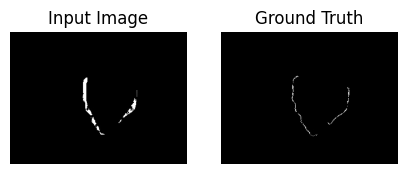

Input_shape (1, 240, 320, 1)
Gt shape (1, 240, 320, 1)


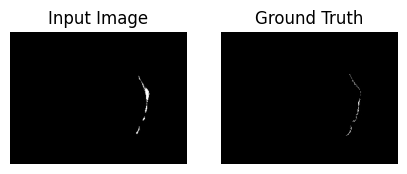

Input_shape (1, 240, 320, 1)
Gt shape (1, 240, 320, 1)


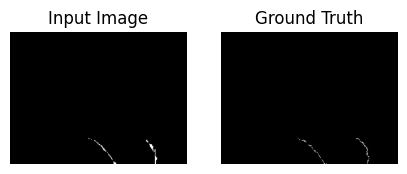

Input_shape (1, 240, 320, 1)
Gt shape (1, 240, 320, 1)


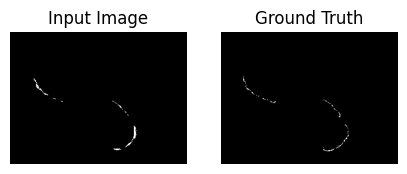

Input_shape (1, 240, 320, 1)
Gt shape (1, 240, 320, 1)


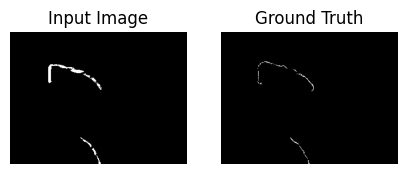

In [ ]:
for test_input, tar in vae_train_dataset.take(5):
  plt.figure(figsize=(5,5))
  print('Input_shape', test_input.shape)
  print('Gt shape',tar.shape)
  display_list = [test_input[0], tar[0]]

  title = ['Input Image', 'Ground Truth']
  for i in range(2):
    plt.subplot(1, 2, i+1)
    plt.title(title[i])
    # Getting the pixel values in the [0, 1] range to plot.
    plt.imshow(display_list[i], cmap='gray')
    plt.axis('off')
  plt.show()

## CVAE

### Define the encoder and decoder networks with *tf.keras.Sequential*

In this VAE example, use two small ConvNets for the encoder and decoder networks. In the literature, these networks are also referred to as inference/recognition and generative models respectively. Use `tf.keras.Sequential` to simplify implementation. Let $x$ and $z$ denote the observation and latent variable respectively in the following descriptions.

### Encoder network
This defines the approximate posterior distribution $q(z|x)$, which takes as input an observation and outputs a set of parameters for specifying the conditional distribution of the latent representation $z$.
In this example, simply model the distribution as a diagonal Gaussian, and the network outputs the mean and log-variance parameters of a factorized Gaussian.
Output log-variance instead of the variance directly for numerical stability.

### Decoder network
This defines the conditional distribution of the observation $p(x|z)$, which takes a latent sample $z$ as input and outputs the parameters for a conditional distribution of the observation.
Model the latent distribution prior $p(z)$ as a unit Gaussian.

### Reparameterization trick
To generate a sample $z$ for the decoder during training, you can sample from the latent distribution defined by the parameters outputted by the encoder, given an input observation $x$.
However, this sampling operation creates a bottleneck because backpropagation cannot flow through a random node.

To address this, use a reparameterization trick.
In our example, you approximate $z$ using the decoder parameters and another parameter $\epsilon$ as follows:

$$z = \mu + \sigma \odot \epsilon$$

where $\mu$ and $\sigma$ represent the mean and standard deviation of a Gaussian distribution respectively. They can be derived from the decoder output. The $\epsilon$ can be thought of as a random noise used to maintain stochasticity of $z$. Generate $\epsilon$ from a standard normal distribution.

The latent variable $z$ is now generated by a function of $\mu$, $\sigma$ and $\epsilon$, which would enable the model to backpropagate gradients in the encoder through $\mu$ and $\sigma$ respectively, while maintaining stochasticity through $\epsilon$.

### Network architecture
For the encoder network, use two convolutional layers followed by a fully-connected layer. In the decoder network, mirror this architecture by using a fully-connected layer followed by three convolution transpose layers (a.k.a. deconvolutional layers in some contexts). Note, it's common practice to avoid using batch normalization when training VAEs, since the additional stochasticity due to using mini-batches may aggravate instability on top of the stochasticity from sampling.


In [ ]:
IMG_HEIGHT_VAE = 240
IMG_WIDTH_VAE = 320
input_shape = (IMG_HEIGHT_VAE, IMG_WIDTH_VAE,  1)
def ConvLRelu(filters, kernelSize, strides=1):
    # Define Convolutional layer followed by LeakyReLU
    return tf.keras.Sequential([
        Conv2D(filters, kernelSize, strides=strides, padding='same'),
        LeakyReLU()
    ])
def ConvTranspose(filters, kernelSize, strides=1, dropout_rate=0.5, activation=None):
    # Define Convolutional Transpose layer followed by dropout
    return tf.keras.Sequential([
        tf.keras.layers.UpSampling2D(size=(2, 2)),
        tf.keras.layers.Conv2D(filters, kernelSize, strides=strides, padding='same', activation=activation),
        tf.keras.layers.Dropout(dropout_rate)
    ])

class CVAE(tf.keras.Model):
    """Convolutional variational autoencoder."""

    def __init__(self, latent_dim,  dropout_rate=0.5):
        super(CVAE, self).__init__()
        self.latent_dim = latent_dim
        self.dropout_rate = dropout_rate
        # Encoder structure
        self.encoder = tf.keras.Sequential(
            [
                tf.keras.layers.InputLayer(input_shape=input_shape),
                ConvLRelu(filters=32, kernelSize=7, strides=2), #( IMG_HEIGHT/2,IMG_WIDTH/2, 32) # Use at thebeginning big kernels, since the shapes are fine. White pixels at the strict center would give more weight and only zeros around it would give it more weight as well
                ConvLRelu(filters=64, kernelSize=7, strides=2), #(IMG_HEIGHT/4, IMG_WIDTH/4, 128)
                ConvLRelu(filters=128, kernelSize=5, strides=2), #(IMG_HEIGHT/8, IMG_WIDTH/8, 128)
                ConvLRelu(filters=64, kernelSize=3), #(IMG_HEIGHT/8, IMG_WIDTH/8, 64)
                ConvLRelu(filters=128, kernelSize=5), #(IMG_HEIGHT/8, IMG_WIDTH/8, 128)
                ConvLRelu(filters=256, kernelSize=5, strides=2), #(IMG_HEIGHT/16, IMG_WIDTH/16, 256)
                ConvLRelu(filters=128, kernelSize=3), #(IMG_HEIGHT/16, IMG_WIDTH/16, 128)
                ConvLRelu(filters=256, kernelSize=5), #(IMG_HEIGHT/16, IMG_WIDTH/16, 256)
                tf.keras.layers.Flatten(),
                # No activation
                tf.keras.layers.Dense(latent_dim + latent_dim),
            ]

        )

        self.decoder = tf.keras.Sequential(
            [
              tf.keras.layers.InputLayer(input_shape=(latent_dim,)),
              tf.keras.layers.Dense(units=IMG_HEIGHT_VAE//16*IMG_WIDTH_VAE//16*256, activation='relu'),
              tf.keras.layers.Reshape(target_shape=(IMG_HEIGHT_VAE//16, IMG_WIDTH_VAE//16, 256)),
              ConvTranspose(filters=128, kernelSize=3, activation='relu'),
              ConvTranspose(filters=64, kernelSize=3, activation='relu'),
              ConvTranspose(filters=64, kernelSize=3, activation='relu'),
              ConvTranspose(filters=32, kernelSize=3, activation='relu'),
              tf.keras.layers.Conv2DTranspose(filters=1, kernel_size=3, strides=1, padding='same'),
          ]
        )

    @tf.function
    def sample(self, eps=None):
        if eps is None:
            eps = tf.random.normal(shape=(100, self.latent_dim))
        return self.decode(eps, apply_sigmoid=True)

    def encode(self, x):
        mean, logvar = tf.split(self.encoder(x), num_or_size_splits=2, axis=1)
        return mean, logvar

    def reparameterize(self, mean, logvar):
        eps = tf.random.normal(shape=mean.shape)
        return eps * tf.exp(logvar * .5) + mean

    def decode(self, z, apply_sigmoid=False):
        logits = self.decoder(z)
        if apply_sigmoid:
            probs = tf.sigmoid(logits)
            return probs
        return logits

### Define the loss function and the optimizer

VAEs train by maximizing the evidence lower bound (ELBO) on the marginal log-likelihood:

$$\log p(x) \ge \text{ELBO} = \mathbb{E}_{q(z|x)}\left[\log \frac{p(x, z)}{q(z|x)}\right].$$

In practice, optimize the single sample Monte Carlo estimate of this expectation:

$$\log p(x| z) + \log p(z) - \log q(z|x),$$
where $z$ is sampled from $q(z|x)$.

Note: You could also analytically compute the KL term, but here you incorporate all three terms in the Monte Carlo estimator for simplicity.

#### Log normal distribution derivation




**Derivation of the Logarithm of the Probability Density Function (PDF) of a Normal Distribution**

Given the provided code expression:
$$
\text{log_normal_pdf}(x, \mu, \log(\sigma^2)) = -\frac{1}{2} \left( (x - \mu)^2 \cdot e^{-\log(\sigma^2)} + \log(\sigma^2) + \log(2\pi) \right)
$$

And the standard normal probability density function (PDF):
$$
f(x \mid \mu, \sigma^2) = \frac{1}{\sqrt{2\pi\sigma^2}} \cdot e^{-\frac{(x - \mu)^2}{2\sigma^2}}
$$

First, let's express:
$$
e^{-\log(\sigma^2)} = \frac{1}{e^{\log(\sigma^2)}} = \frac{1}{\sigma^2}
$$

Substituting this back into our expression, we get:
$$
\text{log_normal_pdf}(x, \mu, \log(\sigma^2)) = -\frac{1}{2} \left( (x - \mu)^2 \cdot \frac{1}{\sigma^2} + \log(\sigma^2) + \log(2\pi) \right)
$$

Now, let's simplify this expression step by step:

1. Expand the first term:
$$
(x - \mu)^2 \cdot \frac{1}{\sigma^2} = \frac{(x - \mu)^2}{\sigma^2}
$$

2. Distribute the negative sign:
$$
-\frac{1}{2} \cdot \frac{(x - \mu)^2}{\sigma^2} = -\frac{1}{2} \cdot \frac{(x - \mu)^2}{\sigma^2}
$$

3. Combine terms:
$$
-\frac{1}{2} \cdot \frac{(x - \mu)^2}{\sigma^2} + \log(\sigma^2) + \log(2\pi)
$$

This matches the formula derived earlier from the standard normal PDF formula:
$$
\log f(x \mid \mu, \sigma^2) = -\frac{1}{2} \left( \frac{(x - \mu)^2}{\sigma^2} + \log(\sigma^2) + \log(2\pi) \right)
$$

So, we have derived the formula of the code from the standard normal distribution.



In [ ]:
# Learning rate decay schedule
optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4)

def log_normal_pdf(sample, mean, logvar, raxis=1):
  log2pi = tf.math.log(2. * np.pi)
  return tf.reduce_sum(
      -.5 * ((sample - mean) ** 2. * tf.exp(-logvar) + logvar + log2pi),
      axis=raxis)

# Gradient-based sharpness loss function
def compute_gradient_loss(y_true, y_pred):
    true_gradients_x = tf.abs(tf.image.sobel_edges(y_true)[..., 0])
    true_gradients_y = tf.abs(tf.image.sobel_edges(y_true)[..., 1])
    pred_gradients_x = tf.abs(tf.image.sobel_edges(y_pred)[..., 0])
    pred_gradients_y = tf.abs(tf.image.sobel_edges(y_pred)[..., 1])
    true_gradients = true_gradients_x + true_gradients_y
    pred_gradients = pred_gradients_x + pred_gradients_y
    return tf.reduce_mean(tf.abs(true_gradients - pred_gradients))


def compute_mmd_loss(z, mean, logvar):
    batch_size = tf.shape(z)[0]
    noise = tf.random.normal(tf.shape(z))

    # Sample from the prior
    p_samples = noise

    # Sample from the posterior
    q_samples = z

    # Compute squared distances in feature space
    p_dist = tf.reduce_sum(tf.square(p_samples), axis=1)
    q_dist = tf.reduce_sum(tf.square(q_samples), axis=1)
    pq_dist = tf.reduce_sum(tf.square(p_samples - q_samples), axis=1)

    # Compute MMD
    sigma2_p = tf.reduce_mean(p_dist)
    sigma2_q = tf.reduce_mean(q_dist)
    scale = tf.maximum(1e-5, sigma2_p + sigma2_q)
    mmd = tf.reduce_mean(tf.exp(-pq_dist / scale))

    return mmd

def compute_elbo(z, y, y_pred, mean, logvar):
    cross_ent = tf.nn.sigmoid_cross_entropy_with_logits(logits=y_pred, labels=y)
    logpx_z = -tf.reduce_sum(cross_ent, axis=[1, 2, 3])
    logpz = log_normal_pdf(z, 0., 0.)
    logqz_x = log_normal_pdf(z, mean, logvar)
    return -tf.reduce_mean(logpx_z + logpz - logqz_x) # Elbo [to maximize, therefore the -]


# Loss for the encoder-decoder (CVAE)
def compute_loss(model, x, y):
    mean, logvar = model.encode(x)
    z = model.reparameterize(mean, logvar)
    y_pred = model.decode(z)
    cross_ent = tf.nn.sigmoid_cross_entropy_with_logits(logits=y_pred, labels=y)
    logpx_z = -tf.reduce_sum(cross_ent, axis=[1, 2, 3])
    logpz = log_normal_pdf(z, 0., 0.)
    logqz_x = log_normal_pdf(z, mean, logvar)
    elbo = compute_elbo(z, y, y_pred, mean, logvar) # Elbo [to maximize]
    #mmd_loss = compute_mmd_loss(z, mean, logvar)*1e4  # Compute MMD loss [to minimize]
    #gradient_loss = compute_gradient_loss(y, y_pred)*1e5  # Compute edge gradient loss [to minimize]
    return  elbo

@tf.function
def train_step(model, x, y, optimizer):
  """Executes one training step and returns the loss.

  This function computes the loss and gradients, and uses the latter to
  update the model's parameters.
  """
  with tf.GradientTape() as tape:
    loss = compute_loss(model, x, y)
  gradients = tape.gradient(loss, model.trainable_variables)
  #optimizer.apply_gradients(zip(gradients, model.trainable_variables))
  # Apply gradient clipping
  clipped_gradients, _ = tf.clip_by_global_norm(gradients, clip_norm=1.0)

  optimizer.apply_gradients(zip(clipped_gradients, model.trainable_variables))


### Build model

In [ ]:
# set the dimensionality of the latent space
latent_dim = 50

# model
model = CVAE(latent_dim)


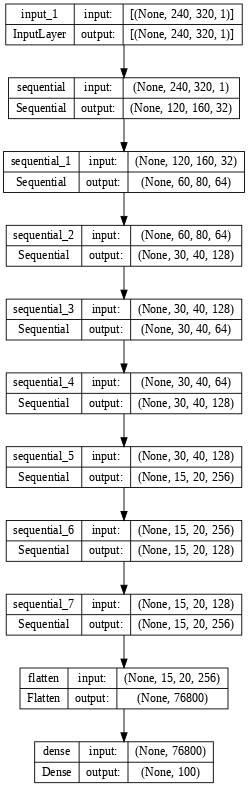

In [ ]:
encoder = model.encoder
tf.keras.utils.plot_model(encoder, show_shapes=True, dpi=64)

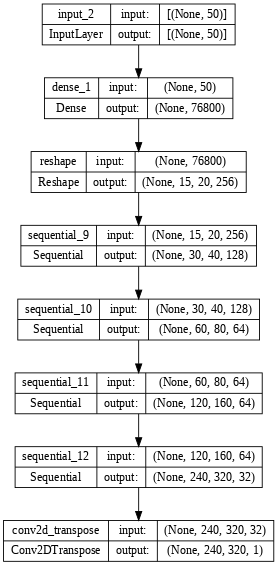

In [ ]:
decoder = model.decoder
tf.keras.utils.plot_model(decoder, show_shapes=True, dpi=64)

## TRAINING

### Training configuration

* Start by iterating over the dataset
* During each iteration, pass the image to the encoder to obtain a set of mean and log-variance parameters of the approximate posterior $q(z|x)$
* then apply the *reparameterization trick* to sample from $q(z|x)$
* Finally, pass the reparameterized samples to the decoder to obtain the logits of the generative distribution $p(x|z)$
* Note: Since you use the dataset loaded by keras with 60k datapoints in the training set and 10k datapoints in the test set, our resulting ELBO on the test set is slightly higher than reported results in the literature which uses dynamic binarization of Larochelle's MNIST.

### Generating images

* Start by sampling a set of latent vectors from the unit Gaussian prior distribution $p(z)$
* The generator will then convert the latent sample $z$ to logits of the observation, giving a distribution $p(x|z)$
* Here, plot the probabilities of Bernoulli distributions


In [ ]:
def generate_images(model,cgan_input_image, cgan_target, burr, cont):
  mean, logvar = model.encode(burr)
  z = model.reparameterize(mean, logvar)
  decoded_example = model.sample(z)


  # show the input of cgan (rgb image), the ground-truth binary burr area for cgan, the processed burr (input for vae), the ground truth contour for vae, the decoded image with trained vae
  plt.figure(figsize=(15, 15))
  display_list = [cgan_input_image[0], cgan_target[0], burr[0], cont[0], decoded_example[0]]
  title = ['Input cGAN image', 'GT cGAN', 'VAE Input Image', 'VAE Ground Truth', 'VAE Predicted Image']

  for i in range(5):
    plt.subplot(1, 5, i+1)
    plt.title(title[i])
    if i>0:
      plt.imshow(display_list[i], cmap='gray')
    else:
      plt.imshow(display_list[i] )
    plt.axis('off')
  plt.show()

def generate_composite_images(model,test_cgan_sim, test_vae_sim, test_cgan_sim_gaz, test_vae_sim_gaz,test_cgan_real, test_vae_real):

  cgan_input_image, cgan_target = test_cgan_sim
  burr, cont = test_vae_sim
  generate_images(model,cgan_input_image, cgan_target, burr, cont)
  cgan_input_image, cgan_target = test_cgan_sim_gaz
  burr, cont = test_vae_sim_gaz
  generate_images(model,cgan_input_image, cgan_target, burr, cont)
  cgan_input_image, cgan_target = test_cgan_real
  burr, cont = test_vae_real
  generate_images(model,cgan_input_image, cgan_target, burr, cont)

In [ ]:
def compute_losses(model, x, y):
    mean, logvar = model.encode(x)
    z = model.reparameterize(mean, logvar)
    y_pred = model.decode(z)
    cross_ent = tf.nn.sigmoid_cross_entropy_with_logits(logits=y_pred, labels=y)
    logpx_z = -tf.reduce_sum(cross_ent, axis=[1, 2, 3])
    logpz = log_normal_pdf(z, 0., 0.)
    logqz_x = log_normal_pdf(z, mean, logvar)
    elbo = compute_elbo(z, y, y_pred, mean, logvar) # Elbo [to maximize]
    mmd_loss = compute_mmd_loss(z, mean, logvar)*1e4  # Compute MMD loss [to minimize]
    gradient_loss = compute_gradient_loss(y, y_pred)*1e5  # Compute edge gradient loss [to minimize]
    return  elbo, mmd_loss, gradient_loss

def fit(train_ds, val_dataset, combined_test_sim, combined_test_sim_from_gazebo, combined_test_real, steps, epochs, checkpoint_dir, checkpoint_prefix):

  start = time.time()

  # Tests images for plotting
  test_cgan_sim, test_vae_sim = next(iter(combined_test_sim.take(1)))
  test_cgan_sim_gaz, test_vae_sim_gaz = next(iter(combined_test_sim_from_gazebo.take(1)))
  test_cgan_real, test_vae_real = next(iter(combined_test_real.take(1)))
  val_inp_img, val_target = next(iter(val_dataset.take(1)))
  train_losses = []
  val_losses = []
  gazebo_losses = []
  real_losses = []
  loss = tf.keras.metrics.Mean()
  loss_val = tf.keras.metrics.Mean()
  loss_gaz = tf.keras.metrics.Mean()
  loss_real = tf.keras.metrics.Mean()
  ds_len = steps//epochs
  for step, (input_image, target) in train_ds.repeat().take(tf.cast(steps, tf.int64)).enumerate():

    if (step) % 1000 == 0:
      #display.clear_output(wait=True)
      # Loss for training images
      loss(compute_loss(model, input_image, target))
      elbo = -loss.result()
      train_losses.append(-elbo)
      # Loss for validation images
      loss_val(compute_loss(model, val_inp_img, val_target))
      val_elbo = -loss_val.result()
      val_losses.append(-val_elbo)
      # Loss for sim gazebo images
      inp_gaz, tar_gaz = test_vae_sim_gaz
      loss_gaz(compute_loss(model, inp_gaz, tar_gaz))
      gaz_elbo = -loss_gaz.result()
      gazebo_losses.append(-gaz_elbo)
      # Loss for real images
      inp_real, tar_real = test_vae_real
      loss_real(compute_loss(model, inp_real, tar_real))
      real_elbo = -loss_real.result()
      real_losses.append(-real_elbo)

      if step != 0:
        print(f'Time taken for 1000 steps: {time.time()-start:.2f} sec\n')
      epoch = step//ds_len + 1
      print(f"[Epochs-interval: {epoch}/{epochs}]__Step: {step//1000}k/{steps//1000}k")
      # train loss components
      elbo, mmd_loss, gradient_loss = compute_losses(model, input_image, target)
      print('Train set ELBO: {}'.format(elbo))
      print('Train set MMD loss: {}'.format(mmd_loss))
      print('Train set GRADIENT loss: {}'.format(gradient_loss))
      generate_composite_images(model,test_cgan_sim, test_vae_sim, test_cgan_sim_gaz, test_vae_sim_gaz,test_cgan_real, test_vae_real) # plot some test images

      # SAVE MODEL AND PARTIAL LOSSES
      save_list_to_pickle(train_losses, checkpoint_dir+"/loss_tot.pickle")
      save_list_to_pickle(val_losses, checkpoint_dir+"/val_loss_tot.pickle")
      save_list_to_pickle(gazebo_losses, checkpoint_dir+"/gazebo_loss_tot.pickle")
      save_list_to_pickle(real_losses, checkpoint_dir+"/real_loss_tot.pickle")



      # Save weights and optimizer's state
      model.save_weights(checkpoint_prefix)

    train_step(model, input_image, target, optimizer)

    # Training step
    if (step+1) % 10 == 0:

      print('.', end='', flush=True)


  return train_losses, val_losses, gazebo_losses, real_losses


In [ ]:
import pickle

def save_list_to_pickle(my_list, filename):
    """
    Save a list to a pickle file.

    Parameters:
    my_list (list): The list to be saved.
    filename (str): The filename to save the pickle file.

    Returns:
    None
    """
    # Open the file in binary write mode
    with open(filename, 'wb') as file:
        # Dump the list into the file using pickle.dump()
        pickle.dump(my_list, file)

def load_list_from_pickle(file_path):
    with open(file_path, 'rb') as f:
        data = pickle.load(f)
    return data


In [ ]:
# TRAINING settings
epochs = 6
STEPS = dataset_length*epochs

# CHECKPOINTS
# =================
checkpoint_dir = 'drive/MyDrive/Colab_Notebooks/v8_extra/checkpoints_cvae/ckpt_cvae_latent50_diff_net12'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt"+"_cvae_epoch"+ str(epochs) + "_latent" + str(latent_dim))

### Run Training

[Epochs-interval: 1/6]__Step: 0k/123k
Train set ELBO: 52806.69140625
Train set MMD loss: 3287.5078125
Train set GRADIENT loss: 5807.20361328125


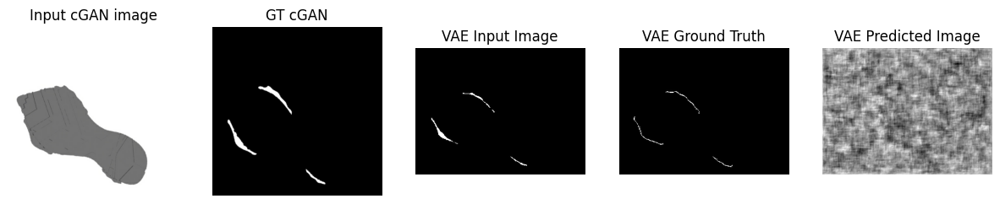

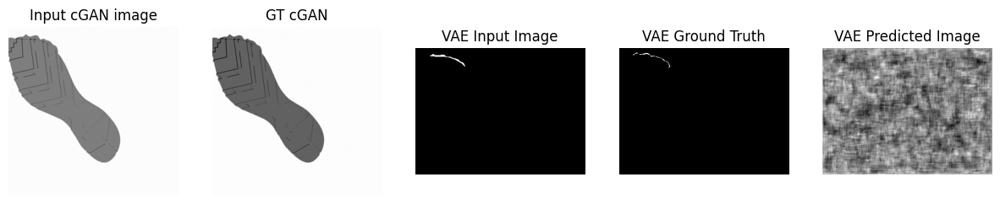

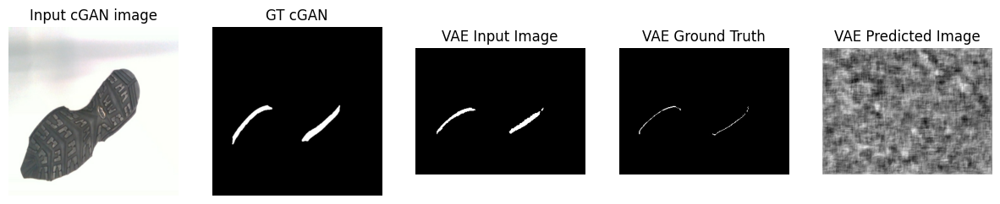

....................................................................................................Time taken for 1000 steps: 34.69 sec

[Epochs-interval: 1/6]__Step: 1k/123k
Train set ELBO: 1696.3280029296875
Train set MMD loss: 3535.24658203125
Train set GRADIENT loss: 176638.515625


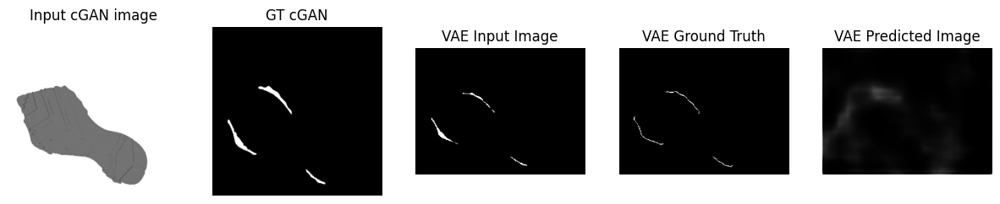

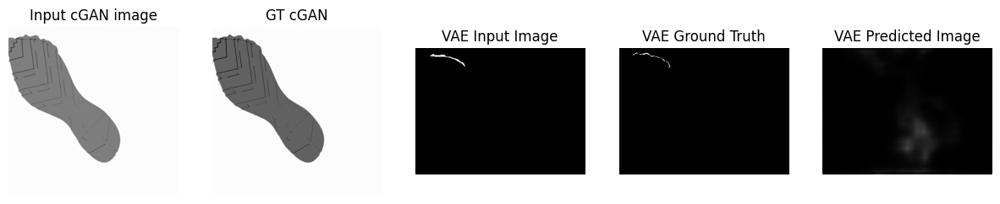

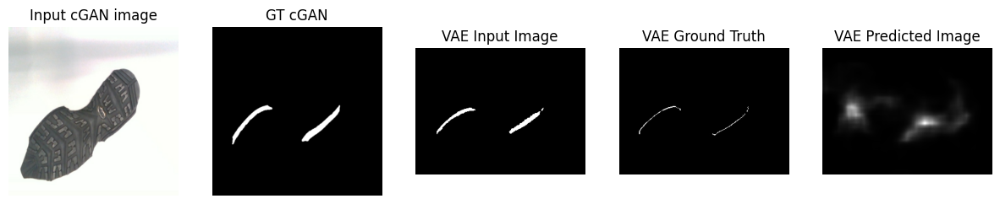

....................................................................................................Time taken for 1000 steps: 55.10 sec

[Epochs-interval: 1/6]__Step: 2k/123k
Train set ELBO: 633.2464599609375
Train set MMD loss: 3229.85595703125
Train set GRADIENT loss: 210802.65625


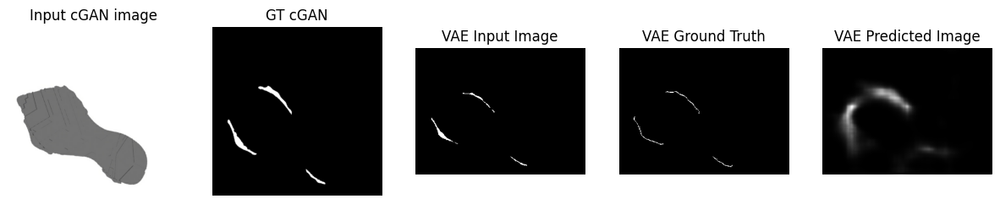

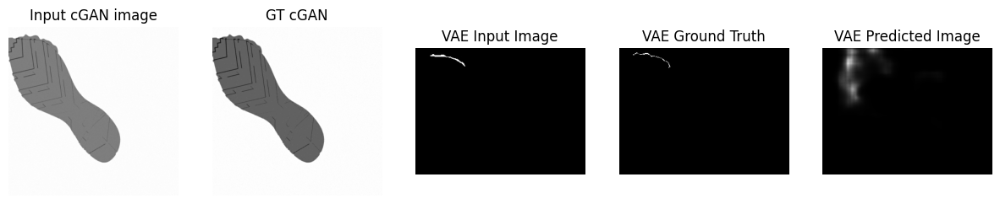

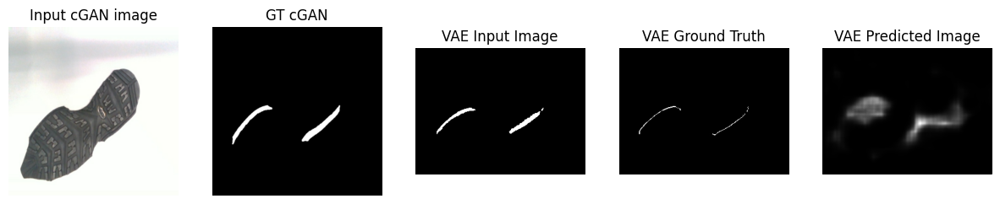

....................................................................................................Time taken for 1000 steps: 75.28 sec

[Epochs-interval: 1/6]__Step: 3k/123k
Train set ELBO: 887.349853515625
Train set MMD loss: 3528.92578125
Train set GRADIENT loss: 263948.71875


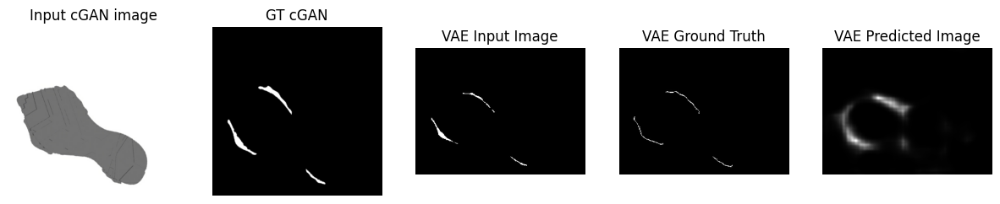

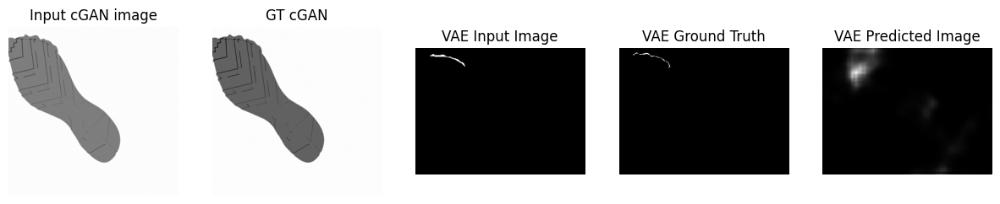

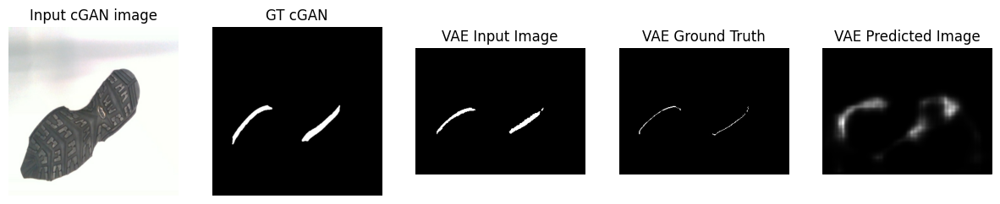

....................................................................................................Time taken for 1000 steps: 95.82 sec

[Epochs-interval: 1/6]__Step: 4k/123k
Train set ELBO: 209.5000457763672
Train set MMD loss: 3232.753662109375
Train set GRADIENT loss: 308591.0625


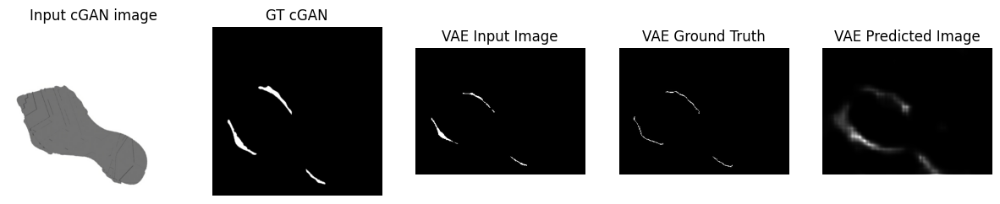

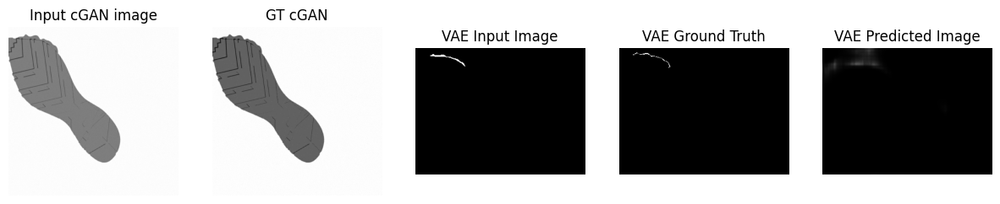

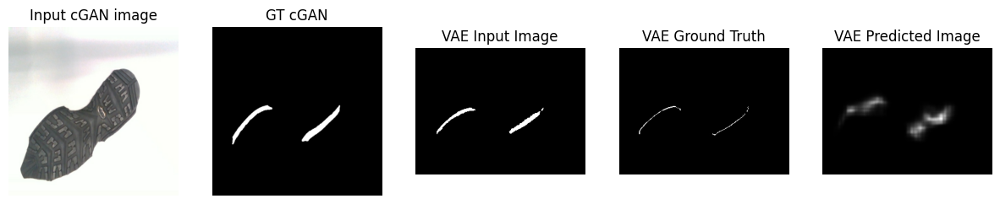

....................................................................................................Time taken for 1000 steps: 115.45 sec

[Epochs-interval: 1/6]__Step: 5k/123k
Train set ELBO: 587.4385375976562
Train set MMD loss: 3448.3388671875
Train set GRADIENT loss: 360888.03125


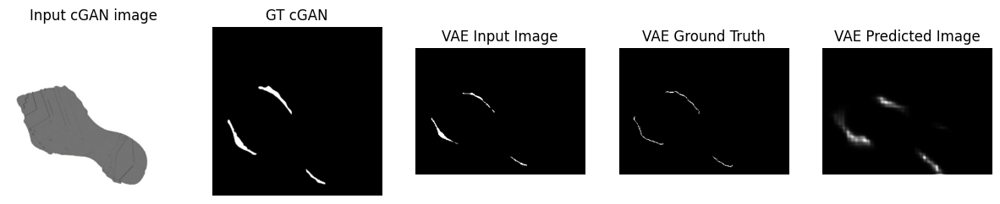

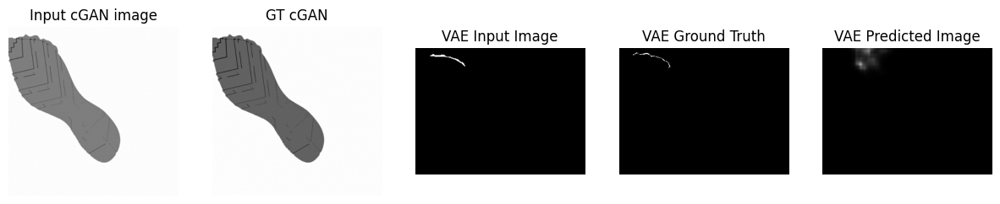

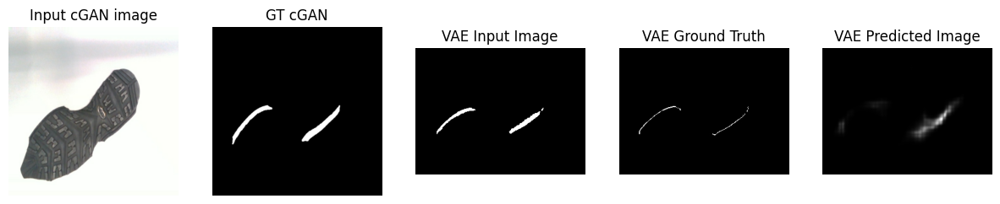

....................................................................................................Time taken for 1000 steps: 136.42 sec

[Epochs-interval: 1/6]__Step: 6k/123k
Train set ELBO: 739.7664184570312
Train set MMD loss: 4326.0966796875
Train set GRADIENT loss: 651307.6875


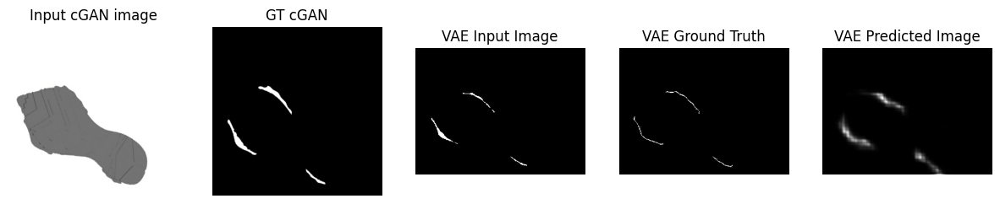

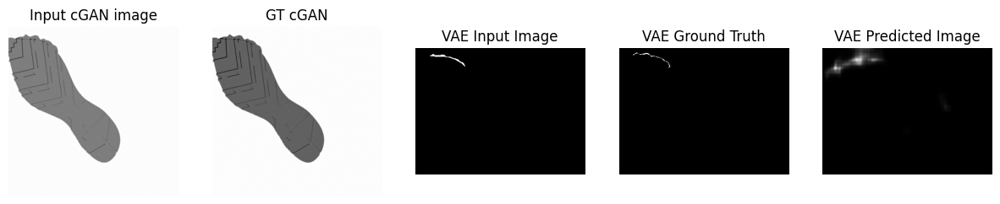

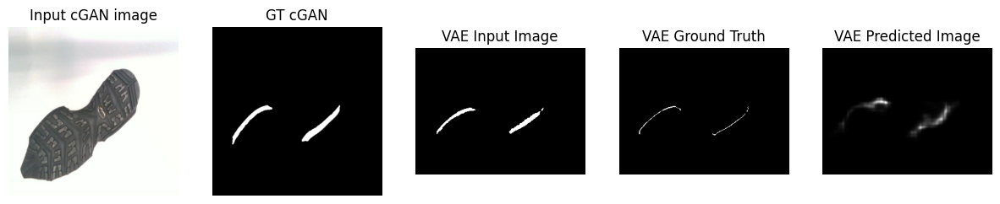

....................................................................................................Time taken for 1000 steps: 156.26 sec

[Epochs-interval: 1/6]__Step: 7k/123k
Train set ELBO: 483.77716064453125
Train set MMD loss: 4690.3701171875
Train set GRADIENT loss: 480693.28125


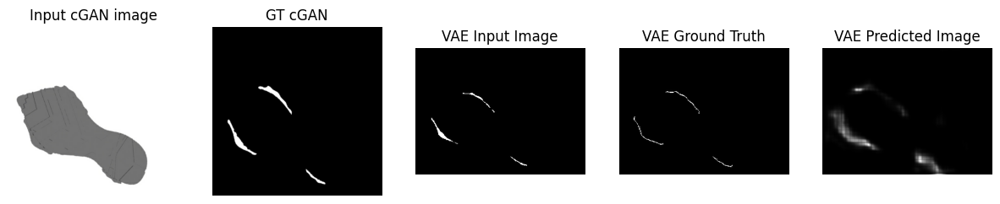

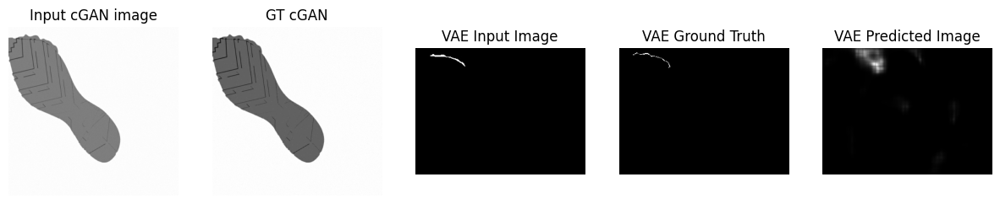

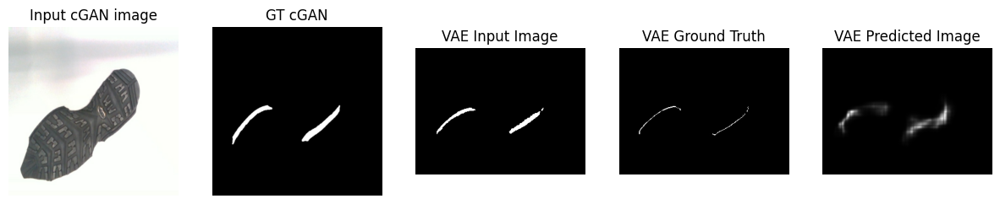

....................................................................................................Time taken for 1000 steps: 176.94 sec

[Epochs-interval: 1/6]__Step: 8k/123k
Train set ELBO: 6.753715515136719
Train set MMD loss: 3389.71533203125
Train set GRADIENT loss: 544726.875


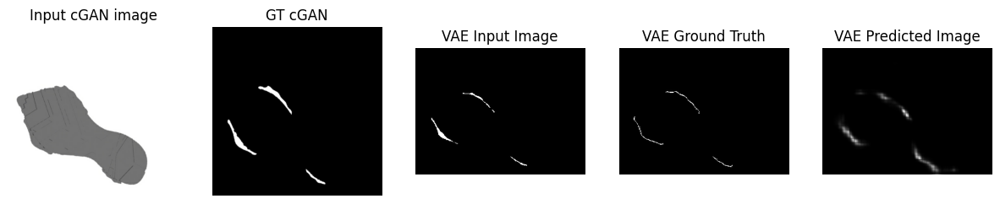

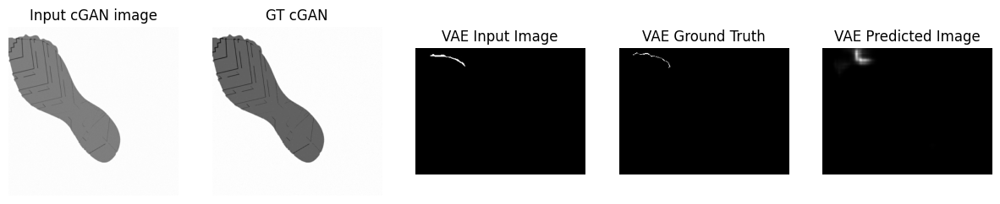

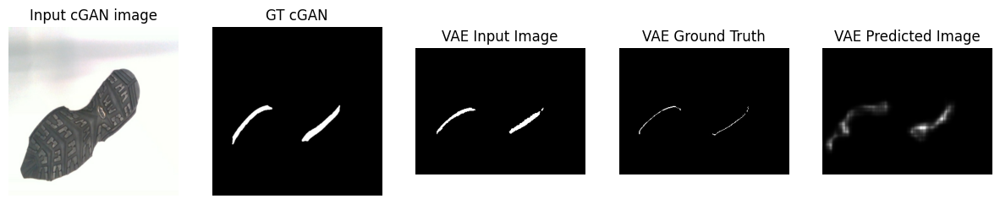

....................................................................................................Time taken for 1000 steps: 197.31 sec

[Epochs-interval: 1/6]__Step: 9k/123k
Train set ELBO: 324.06634521484375
Train set MMD loss: 3482.94873046875
Train set GRADIENT loss: 426181.3125


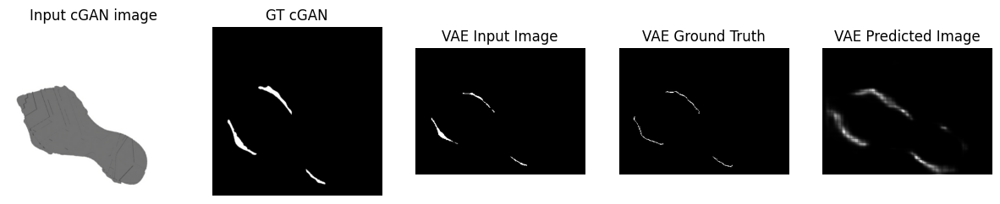

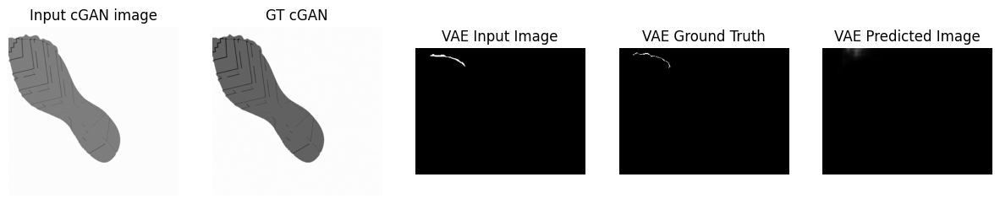

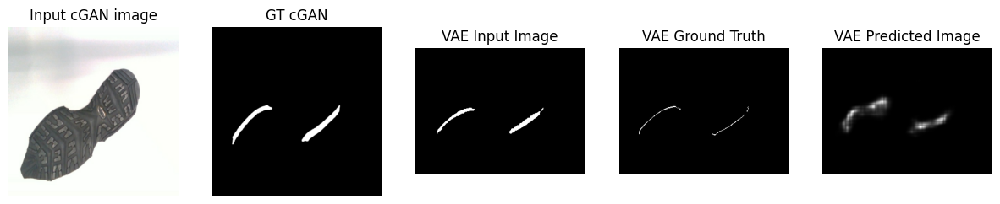

....................................................................................................Time taken for 1000 steps: 217.71 sec

[Epochs-interval: 1/6]__Step: 10k/123k
Train set ELBO: 821.0662231445312
Train set MMD loss: 3810.2373046875
Train set GRADIENT loss: 721101.3125


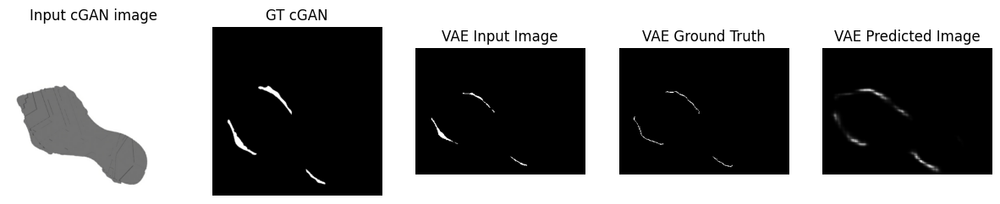

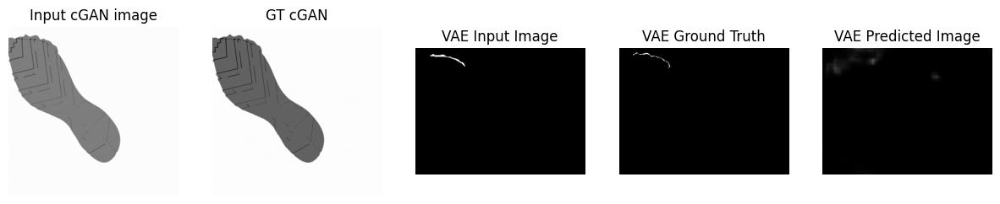

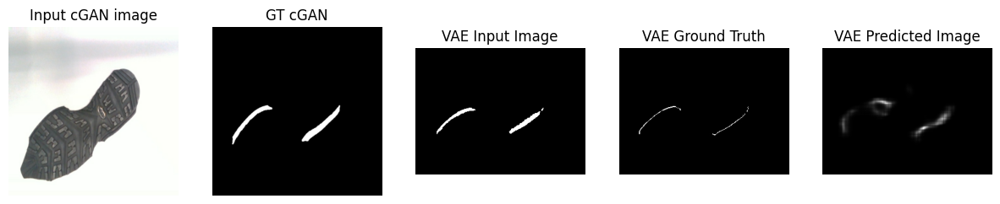

....................................................................................................Time taken for 1000 steps: 237.62 sec

[Epochs-interval: 1/6]__Step: 11k/123k
Train set ELBO: 843.566162109375
Train set MMD loss: 3151.358642578125
Train set GRADIENT loss: 544522.6875


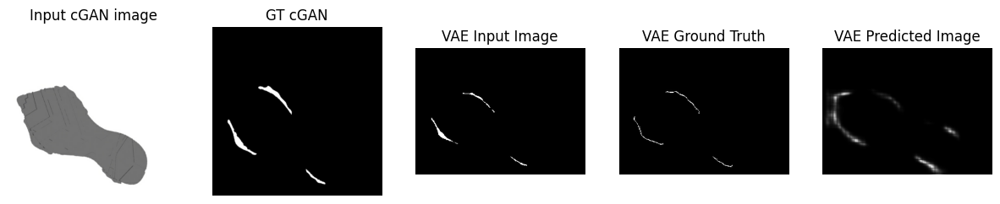

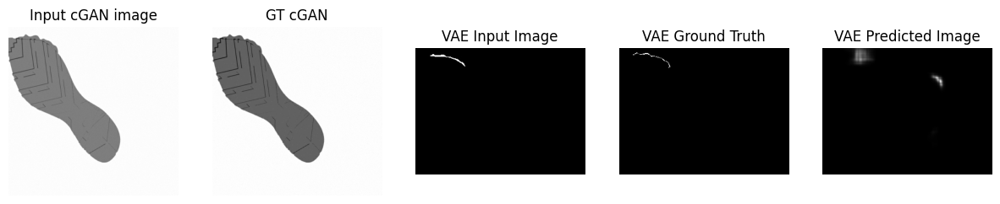

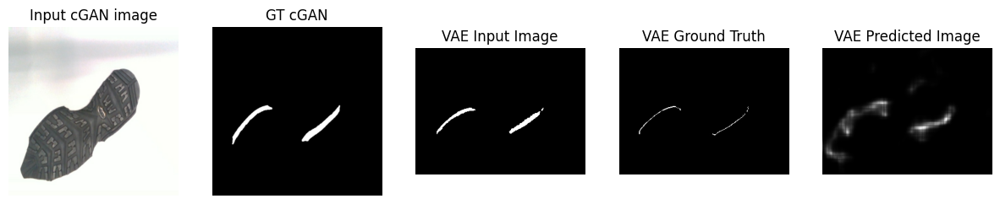

....................................................................................................Time taken for 1000 steps: 258.19 sec

[Epochs-interval: 1/6]__Step: 12k/123k
Train set ELBO: 275.3199768066406
Train set MMD loss: 3280.85009765625
Train set GRADIENT loss: 593851.5


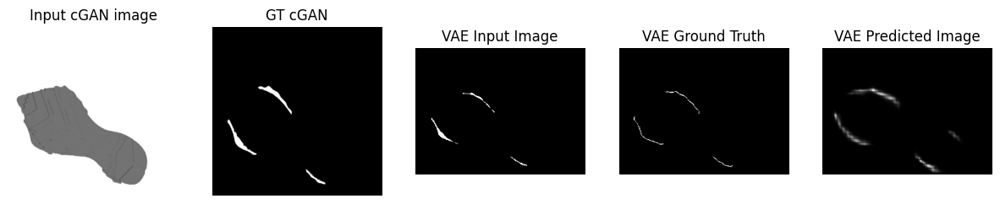

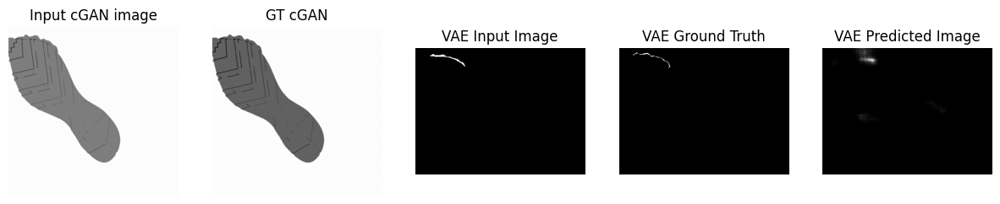

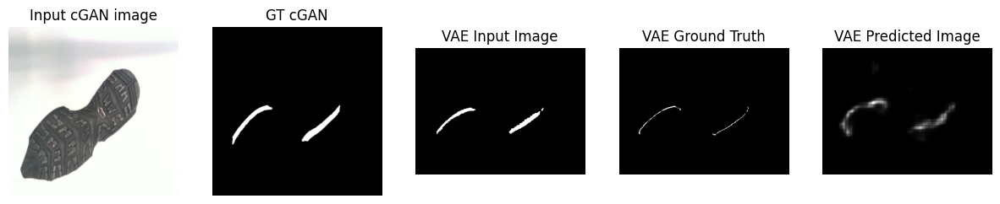

....................................................................................................Time taken for 1000 steps: 278.51 sec

[Epochs-interval: 1/6]__Step: 13k/123k
Train set ELBO: 952.8099365234375
Train set MMD loss: 3990.619384765625
Train set GRADIENT loss: 729287.5


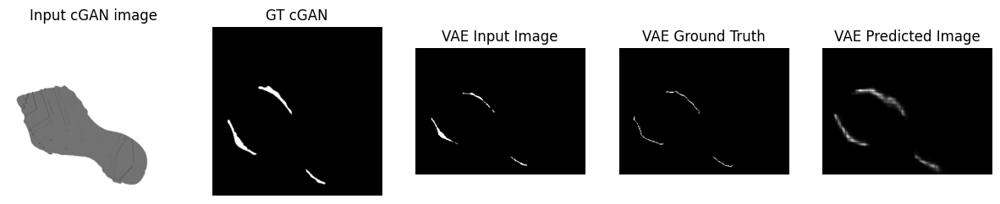

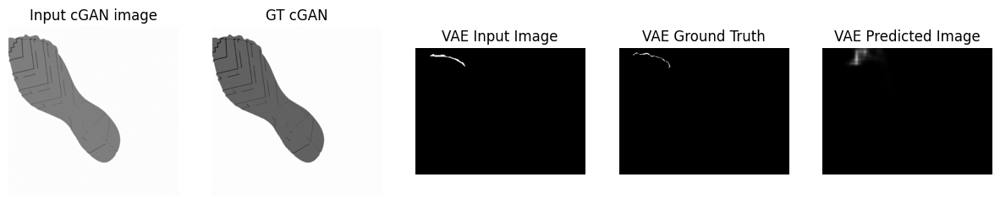

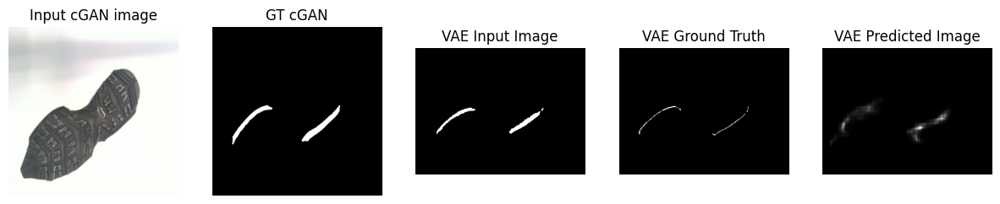

....................................................................................................Time taken for 1000 steps: 299.05 sec

[Epochs-interval: 1/6]__Step: 14k/123k
Train set ELBO: 969.0647583007812
Train set MMD loss: 3950.0634765625
Train set GRADIENT loss: 635593.875


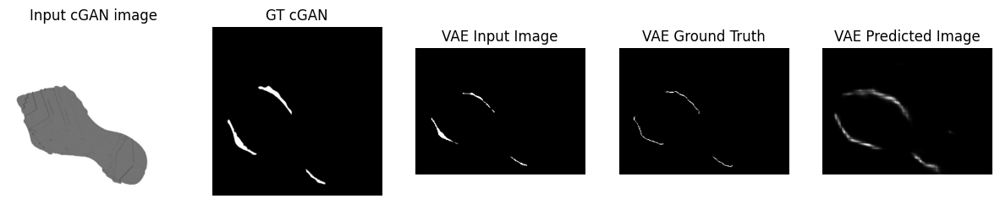

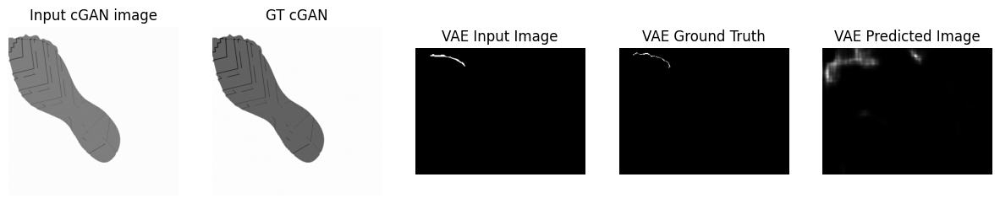

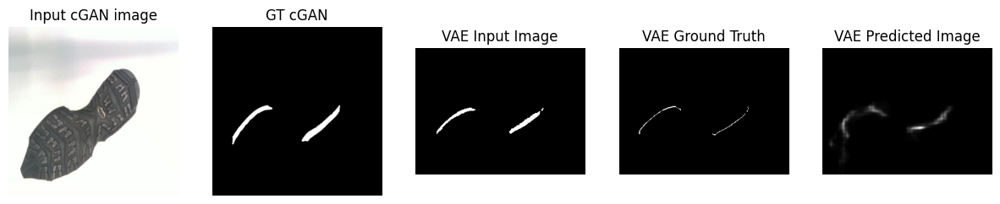

....................................................................................................Time taken for 1000 steps: 319.16 sec

[Epochs-interval: 1/6]__Step: 15k/123k
Train set ELBO: 352.568359375
Train set MMD loss: 3436.9384765625
Train set GRADIENT loss: 507745.125


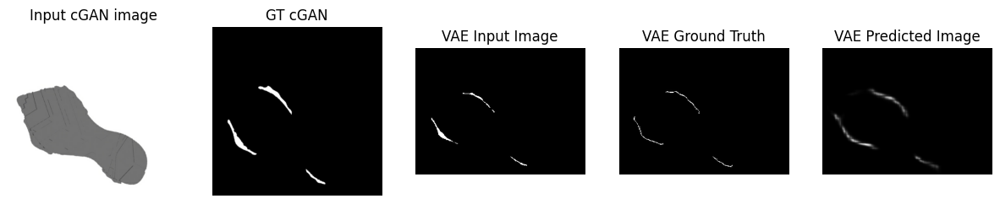

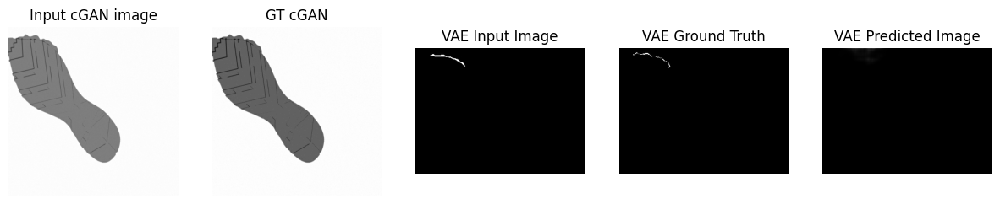

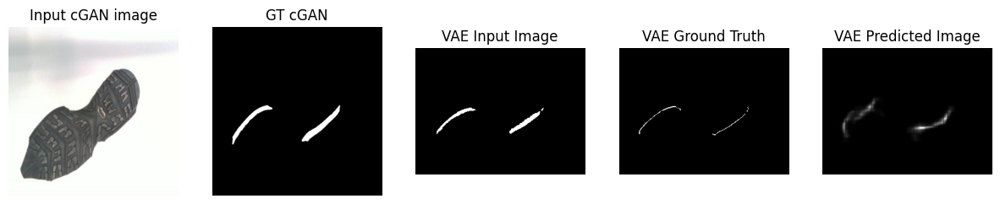

....................................................................................................Time taken for 1000 steps: 339.86 sec

[Epochs-interval: 1/6]__Step: 16k/123k
Train set ELBO: 484.9635314941406
Train set MMD loss: 3860.638427734375
Train set GRADIENT loss: 587170.4375


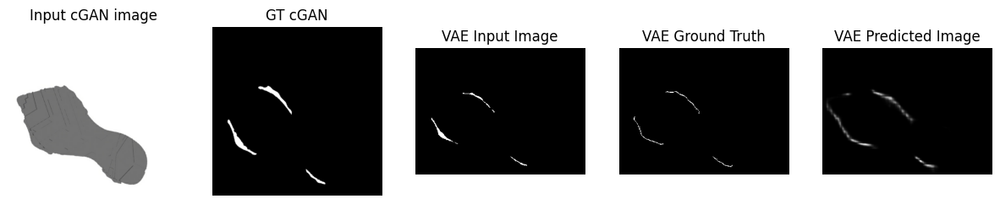

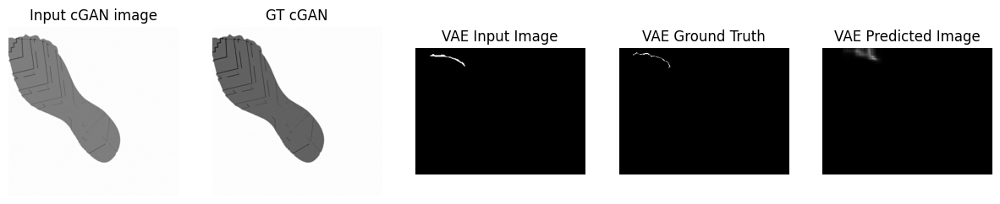

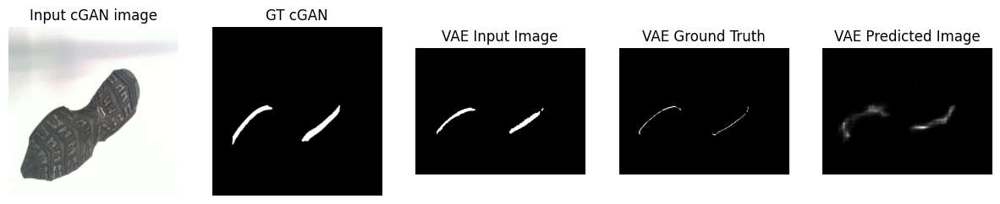

....................................................................................................Time taken for 1000 steps: 360.53 sec

[Epochs-interval: 1/6]__Step: 17k/123k
Train set ELBO: 373.0858459472656
Train set MMD loss: 3747.5068359375
Train set GRADIENT loss: 629373.0


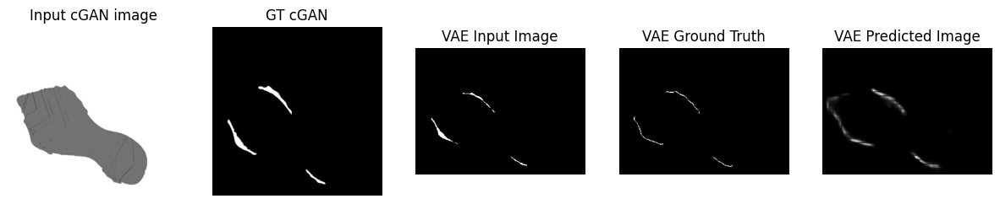

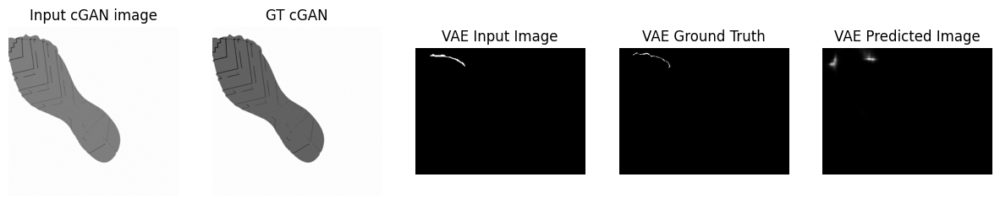

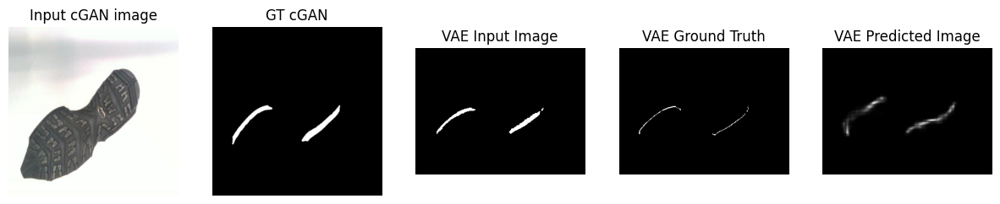

....................................................................................................Time taken for 1000 steps: 381.28 sec

[Epochs-interval: 1/6]__Step: 18k/123k
Train set ELBO: 731.5916137695312
Train set MMD loss: 2902.603759765625
Train set GRADIENT loss: 588580.3125


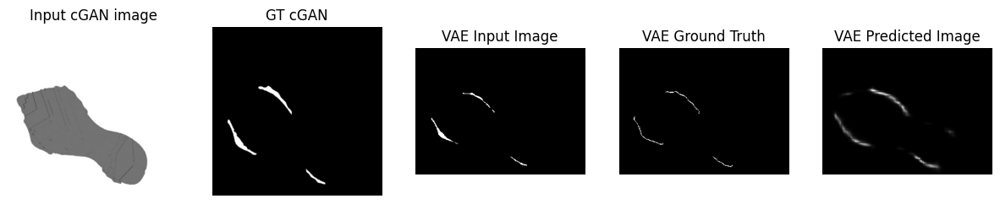

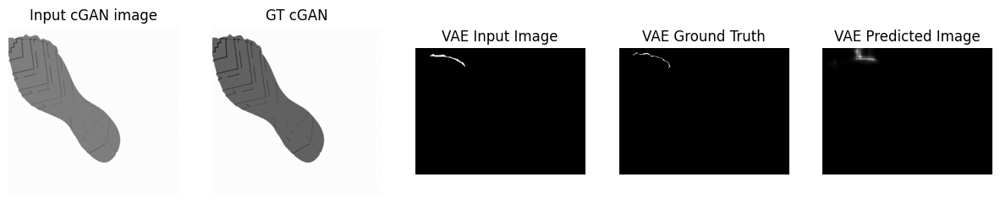

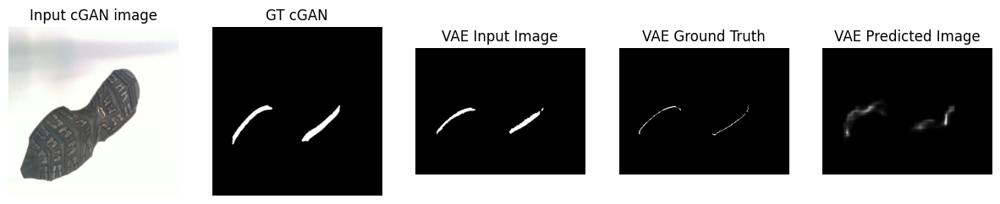

....................................................................................................Time taken for 1000 steps: 401.66 sec

[Epochs-interval: 1/6]__Step: 19k/123k
Train set ELBO: 746.511474609375
Train set MMD loss: 3046.203369140625
Train set GRADIENT loss: 661077.0


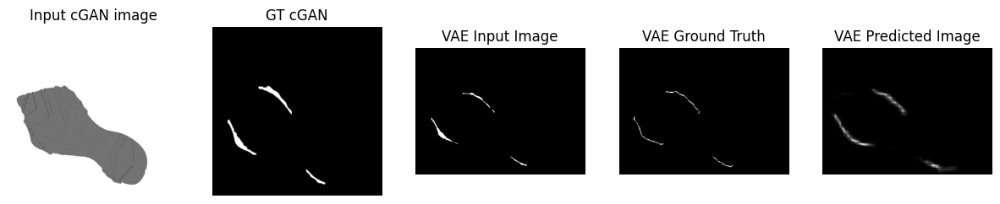

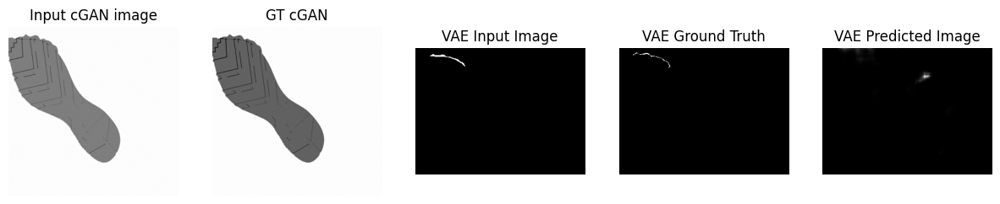

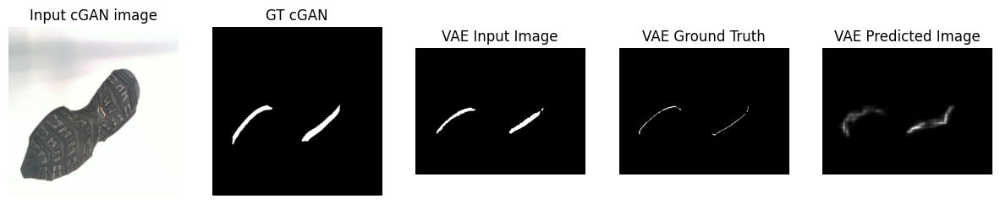

....................................................................................................Time taken for 1000 steps: 422.32 sec

[Epochs-interval: 1/6]__Step: 20k/123k
Train set ELBO: 1908.7996826171875
Train set MMD loss: 3993.862548828125
Train set GRADIENT loss: 558316.9375


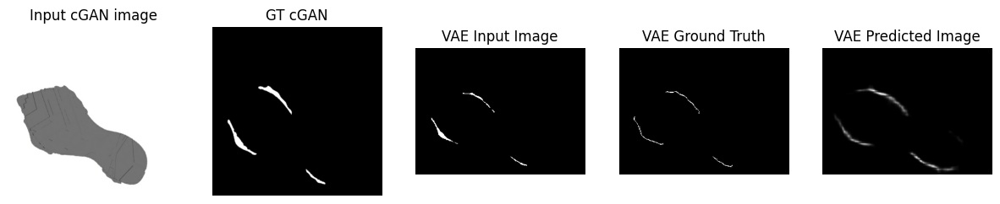

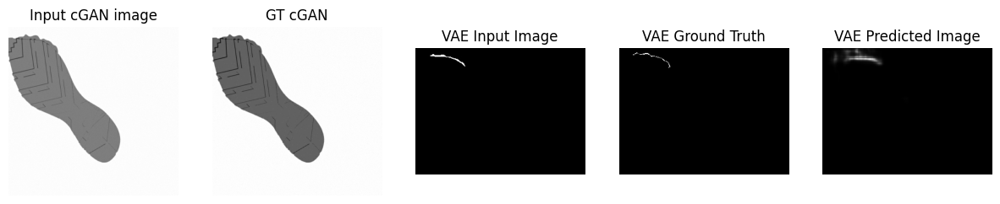

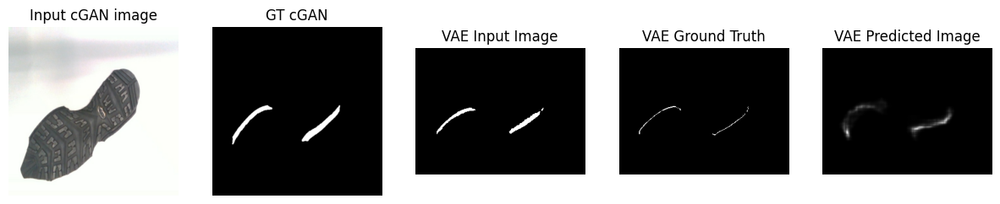

....................................................................................................Time taken for 1000 steps: 442.92 sec

[Epochs-interval: 2/6]__Step: 21k/123k
Train set ELBO: 45.606971740722656
Train set MMD loss: 4572.08642578125
Train set GRADIENT loss: 468613.53125


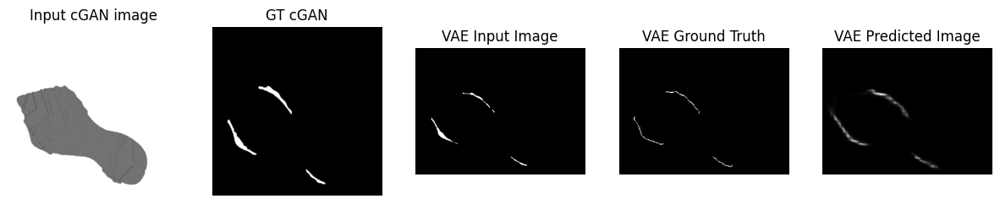

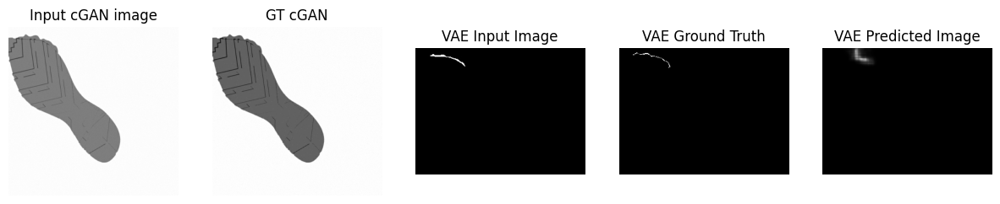

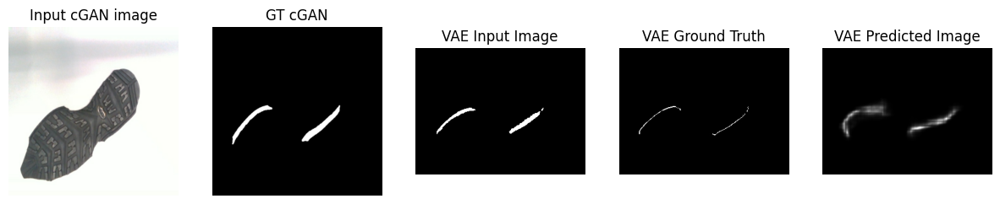

....................................................................................................Time taken for 1000 steps: 463.77 sec

[Epochs-interval: 2/6]__Step: 22k/123k
Train set ELBO: 650.9675903320312
Train set MMD loss: 3908.7509765625
Train set GRADIENT loss: 680563.0


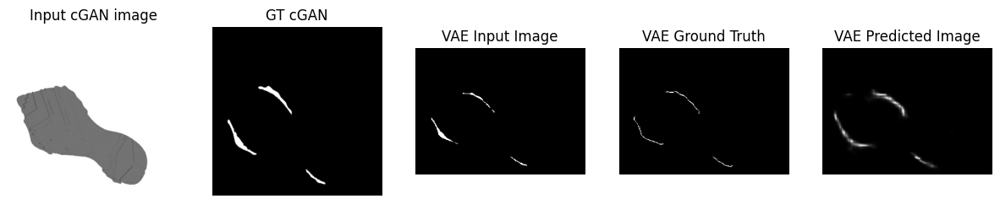

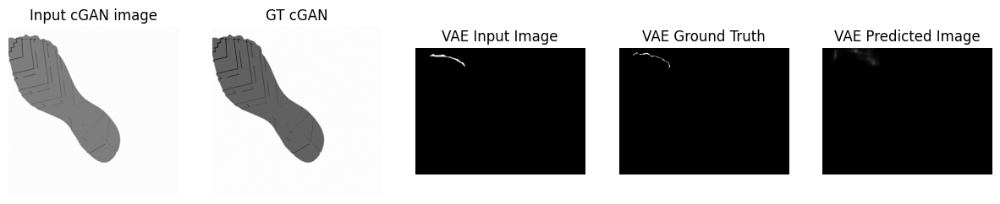

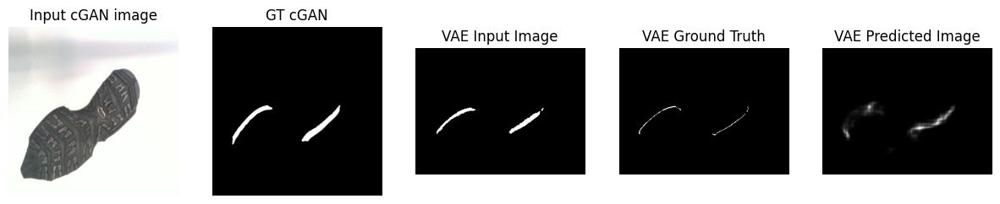

....................................................................................................Time taken for 1000 steps: 484.05 sec

[Epochs-interval: 2/6]__Step: 23k/123k
Train set ELBO: 6.565479278564453
Train set MMD loss: 3575.046630859375
Train set GRADIENT loss: 423352.625


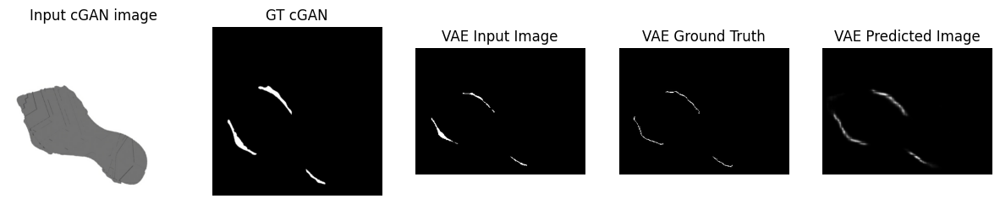

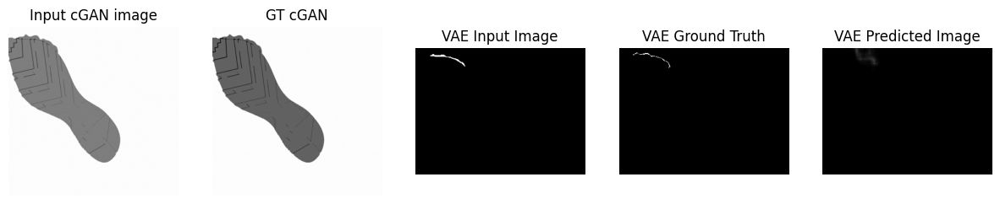

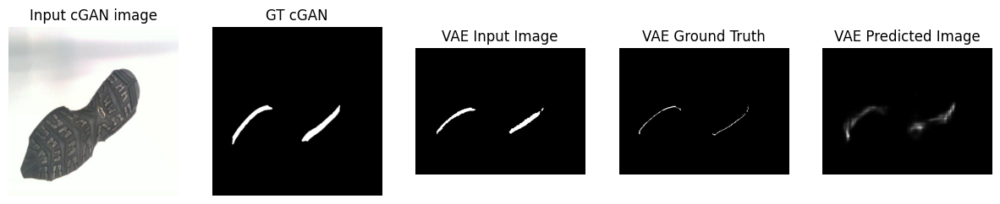

....................................................................................................Time taken for 1000 steps: 505.10 sec

[Epochs-interval: 2/6]__Step: 24k/123k
Train set ELBO: 390.5132751464844
Train set MMD loss: 3759.865966796875
Train set GRADIENT loss: 421636.5


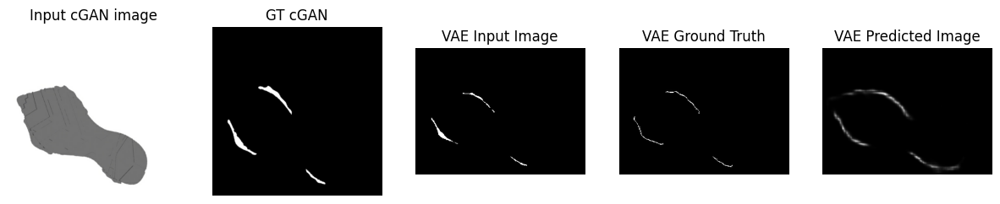

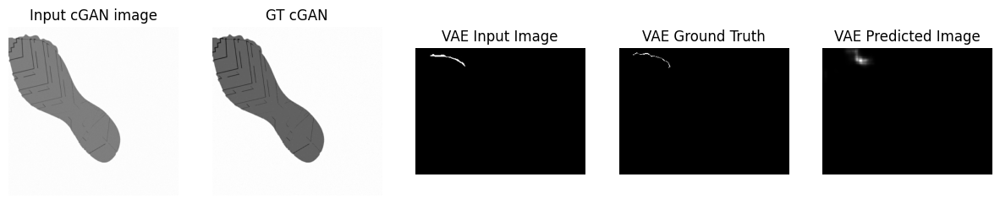

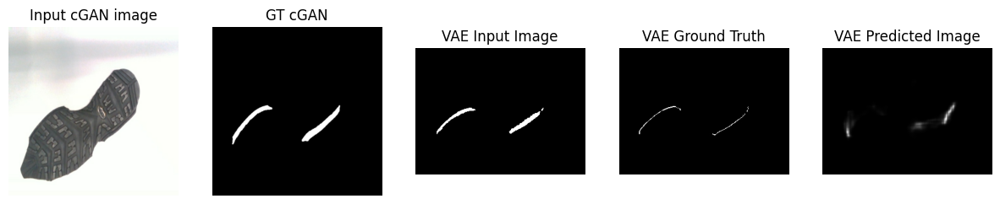

....................................................................................................Time taken for 1000 steps: 525.85 sec

[Epochs-interval: 2/6]__Step: 25k/123k
Train set ELBO: 38.20520782470703
Train set MMD loss: 3393.41796875
Train set GRADIENT loss: 502908.28125


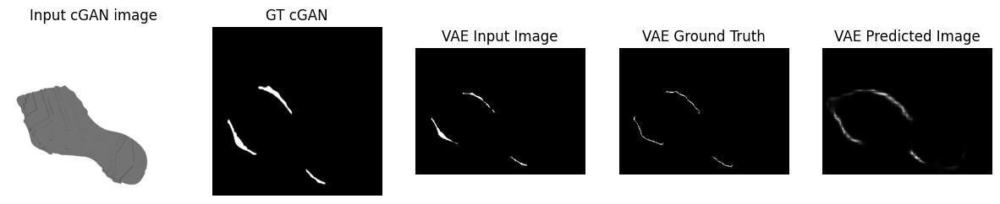

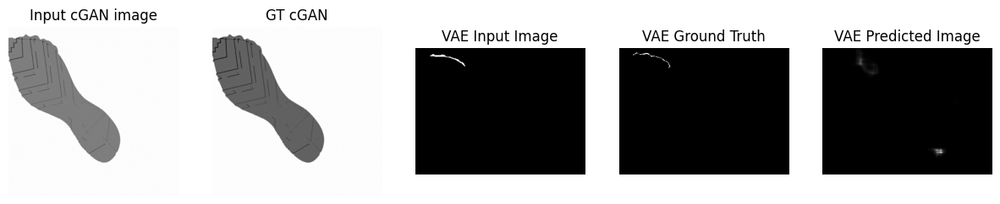

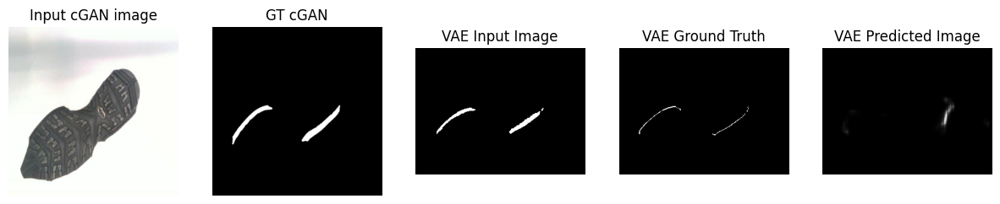

....................................................................................................Time taken for 1000 steps: 546.99 sec

[Epochs-interval: 2/6]__Step: 26k/123k
Train set ELBO: 166.61293029785156
Train set MMD loss: 4097.470703125
Train set GRADIENT loss: 449614.25


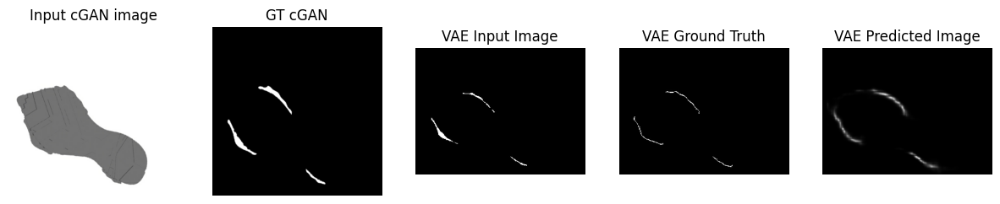

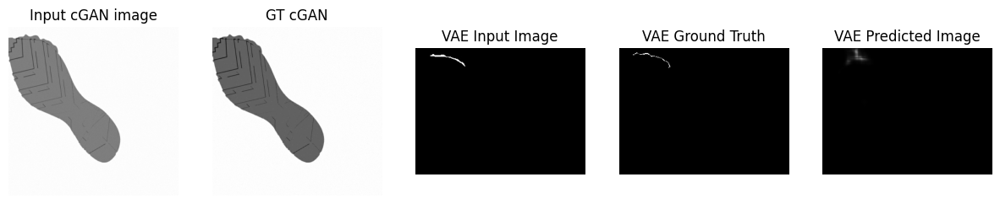

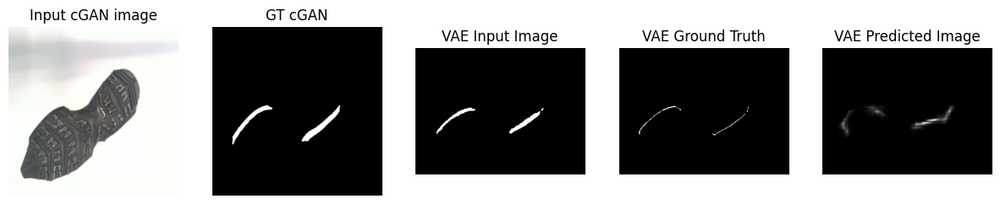

....................................................................................................Time taken for 1000 steps: 567.62 sec

[Epochs-interval: 2/6]__Step: 27k/123k
Train set ELBO: 816.9356689453125
Train set MMD loss: 3251.698974609375
Train set GRADIENT loss: 572321.375


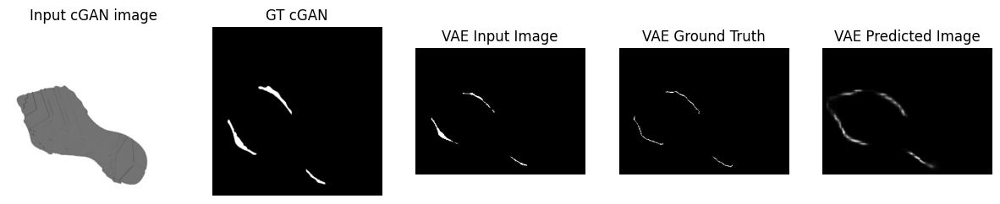

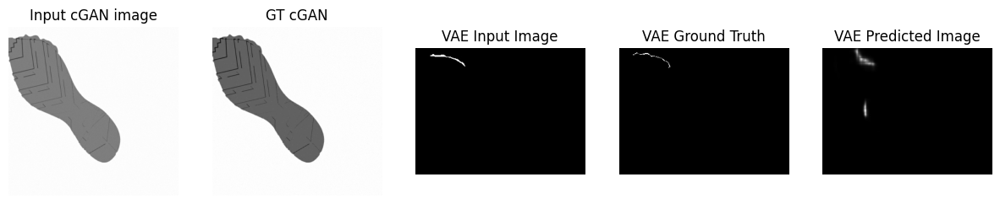

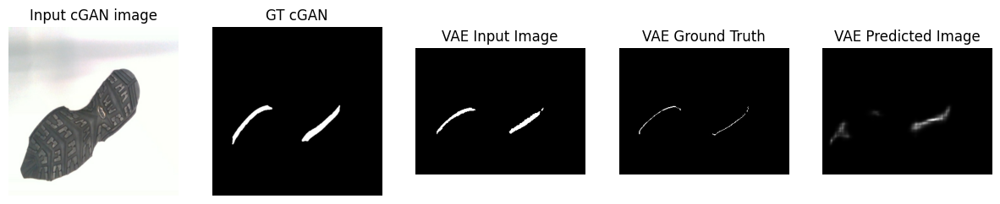

....................................................................................................Time taken for 1000 steps: 588.90 sec

[Epochs-interval: 2/6]__Step: 28k/123k
Train set ELBO: 798.4173583984375
Train set MMD loss: 4046.909423828125
Train set GRADIENT loss: 683502.4375


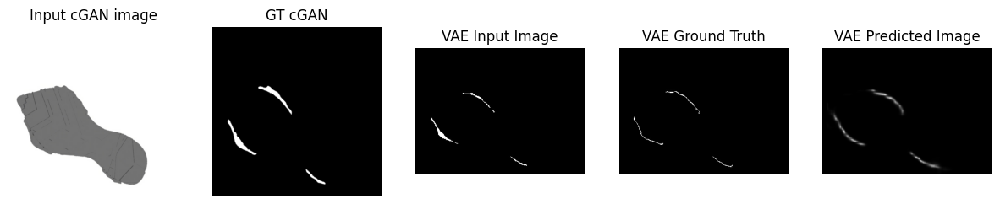

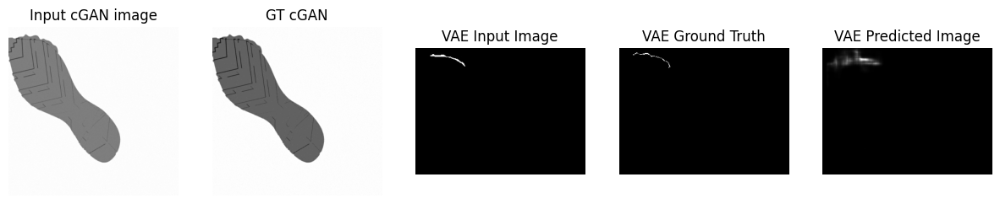

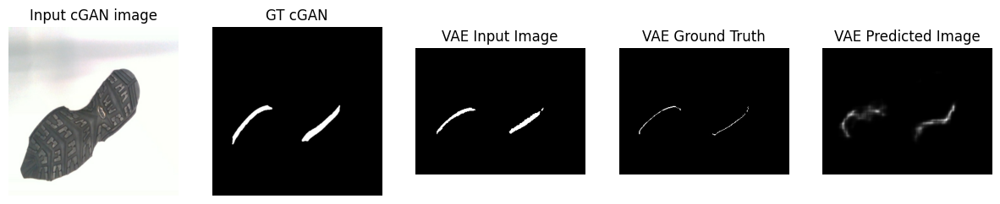

....................................................................................................Time taken for 1000 steps: 609.85 sec

[Epochs-interval: 2/6]__Step: 29k/123k
Train set ELBO: 1267.41748046875
Train set MMD loss: 2534.232666015625
Train set GRADIENT loss: 684199.3125


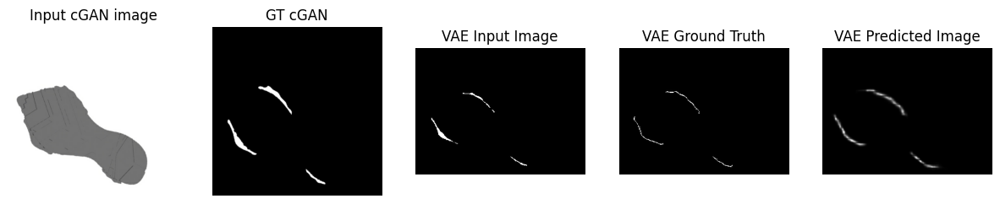

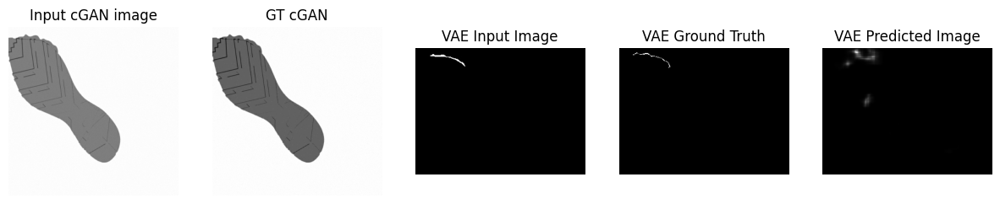

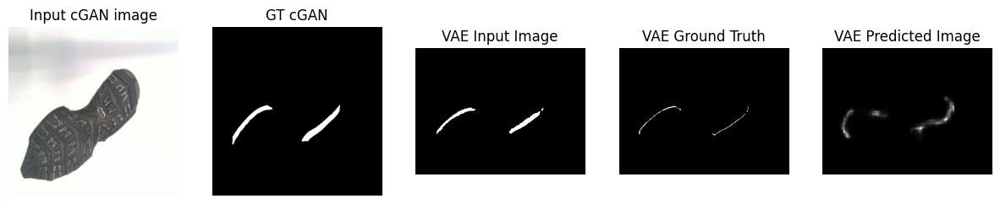

....................................................................................................Time taken for 1000 steps: 631.23 sec

[Epochs-interval: 2/6]__Step: 30k/123k
Train set ELBO: 324.62420654296875
Train set MMD loss: 2834.771484375
Train set GRADIENT loss: 525448.625


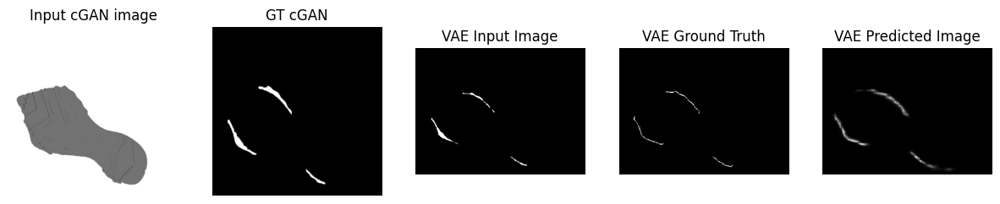

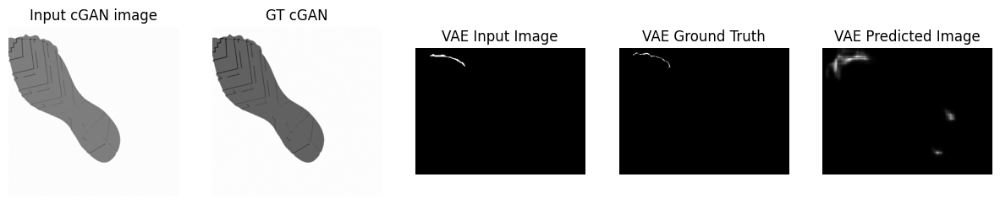

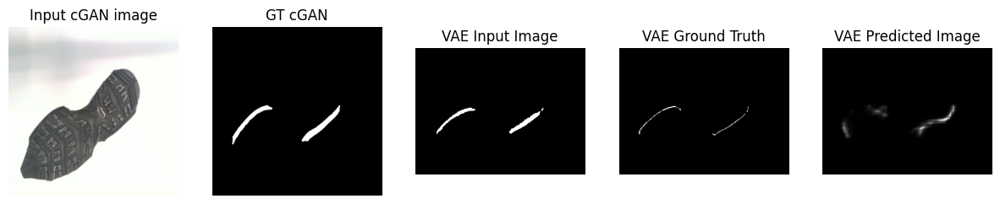

....................................................................................................Time taken for 1000 steps: 652.13 sec

[Epochs-interval: 2/6]__Step: 31k/123k
Train set ELBO: 975.7870483398438
Train set MMD loss: 4388.2470703125
Train set GRADIENT loss: 634444.0


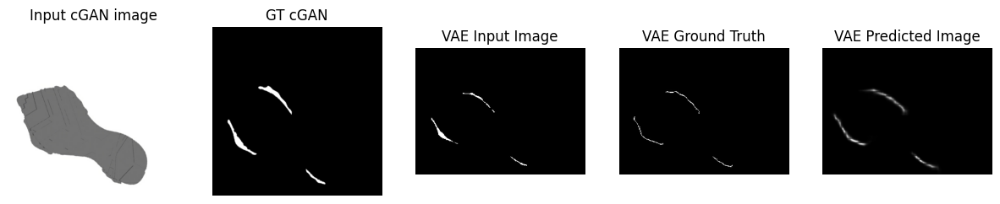

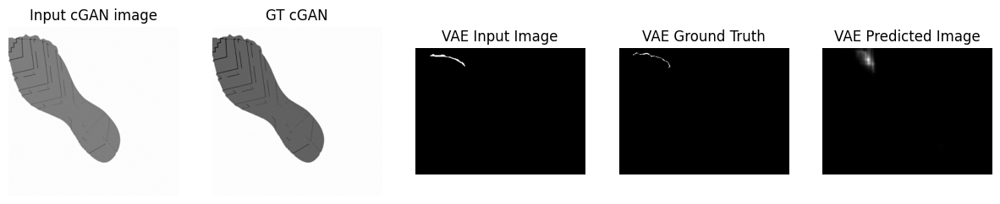

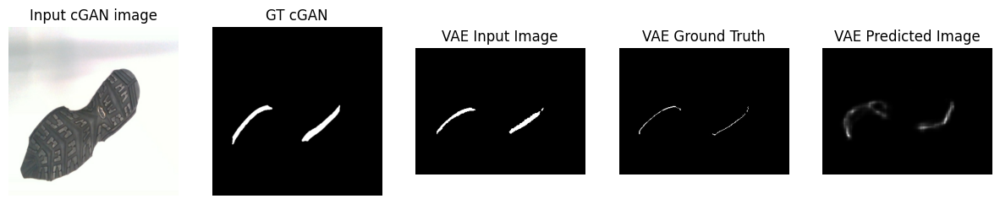

....................................................................................................Time taken for 1000 steps: 673.54 sec

[Epochs-interval: 2/6]__Step: 32k/123k
Train set ELBO: 502.4900817871094
Train set MMD loss: 4437.1240234375
Train set GRADIENT loss: 737714.5


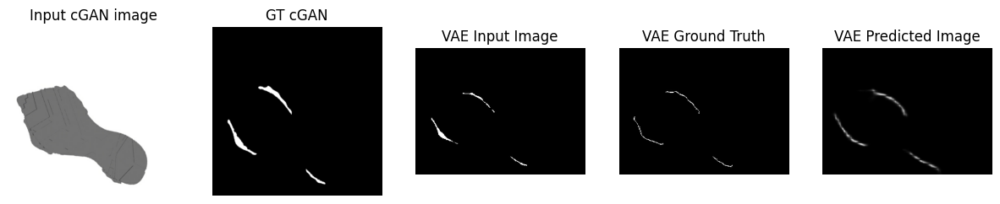

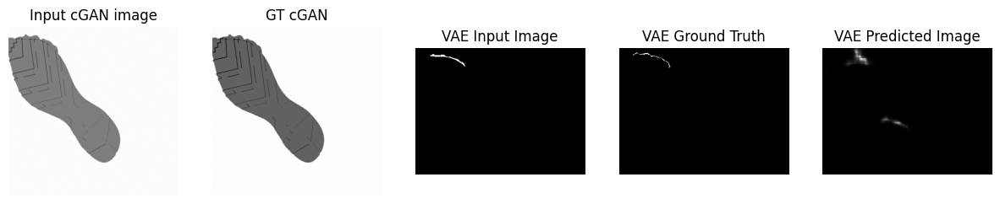

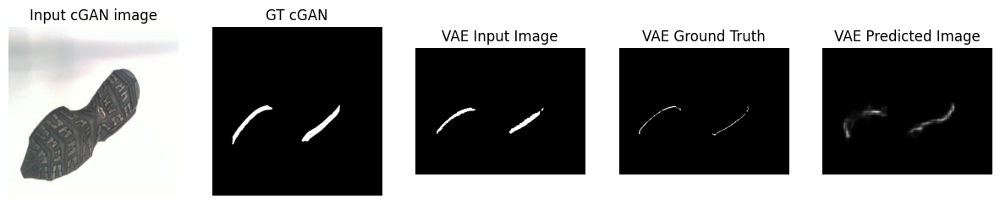

....................................................................................................Time taken for 1000 steps: 694.65 sec

[Epochs-interval: 2/6]__Step: 33k/123k
Train set ELBO: 3.7118263244628906
Train set MMD loss: 4030.16455078125
Train set GRADIENT loss: 424806.15625


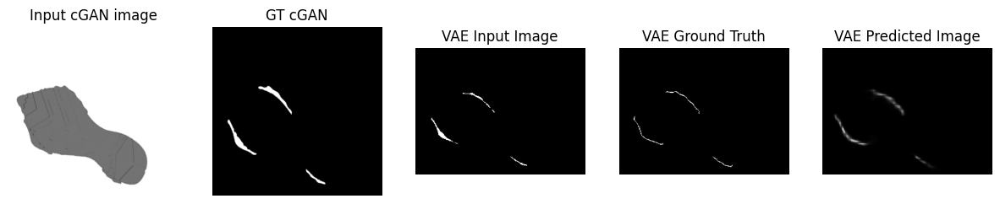

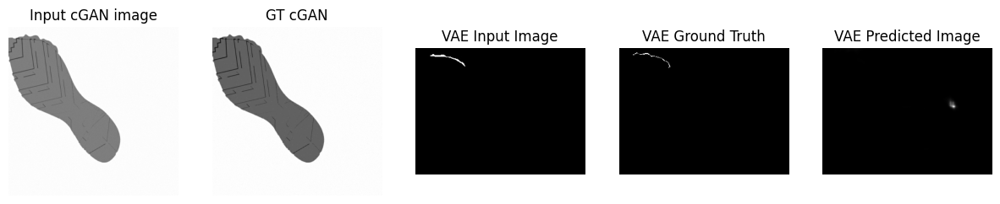

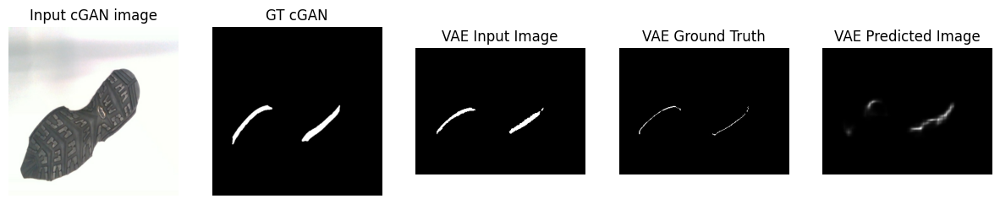

....................................................................................................Time taken for 1000 steps: 715.76 sec

[Epochs-interval: 2/6]__Step: 34k/123k
Train set ELBO: 783.1484985351562
Train set MMD loss: 4210.849609375
Train set GRADIENT loss: 672882.5


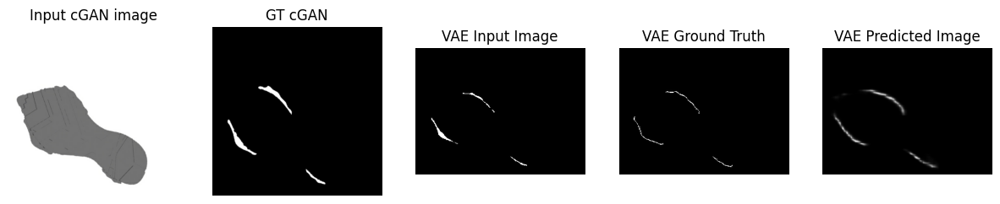

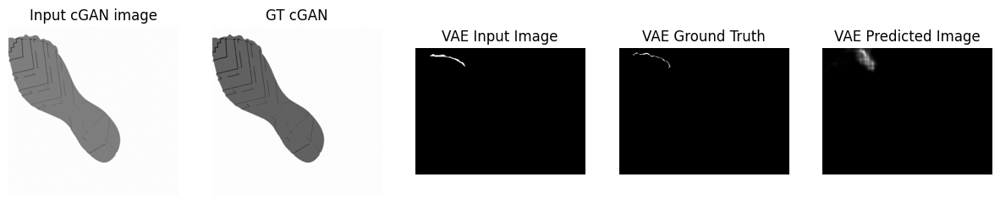

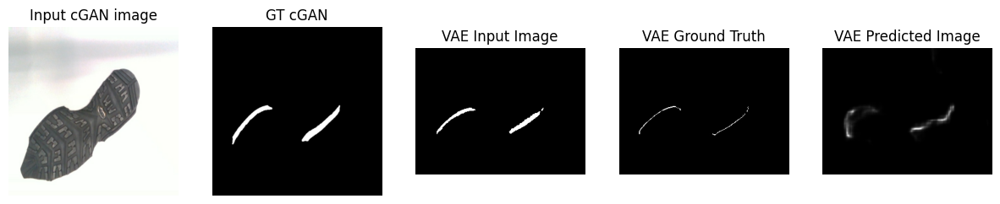

....................................................................................................Time taken for 1000 steps: 736.69 sec

[Epochs-interval: 2/6]__Step: 35k/123k
Train set ELBO: 9.944683074951172
Train set MMD loss: 3772.2685546875
Train set GRADIENT loss: 441703.3125


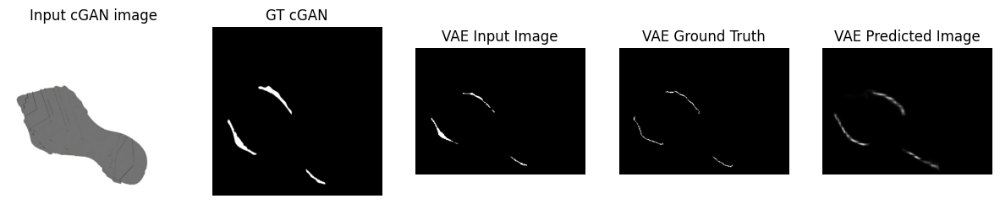

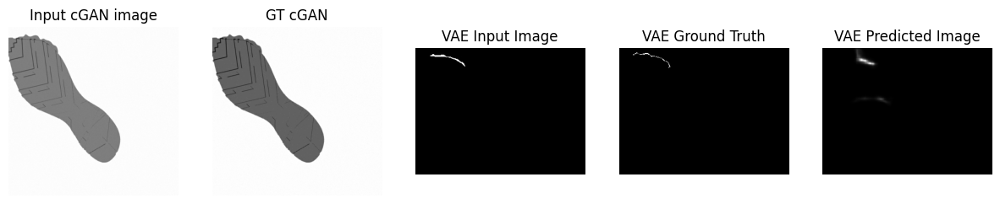

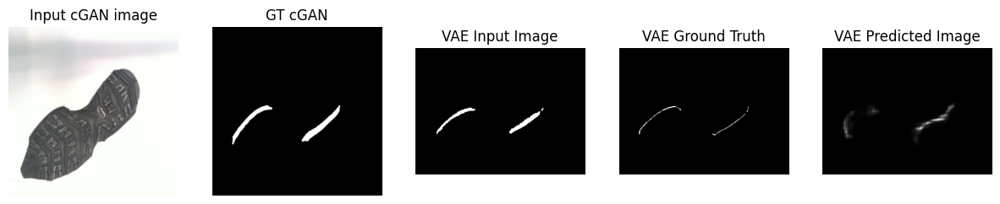

....................................................................................................Time taken for 1000 steps: 758.00 sec

[Epochs-interval: 2/6]__Step: 36k/123k
Train set ELBO: 160.1496124267578
Train set MMD loss: 3281.822265625
Train set GRADIENT loss: 469881.40625


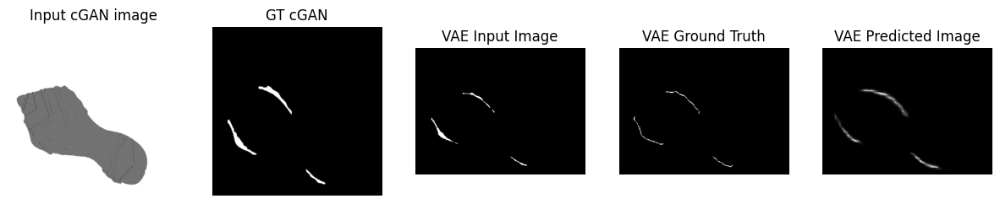

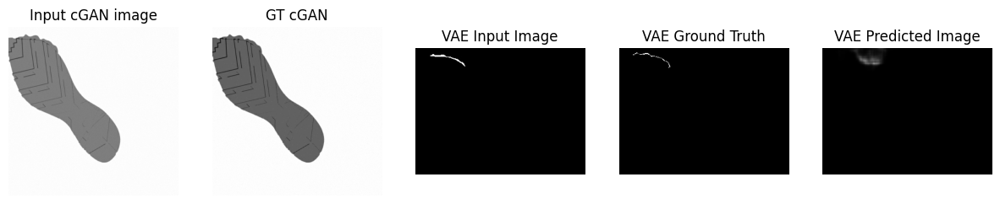

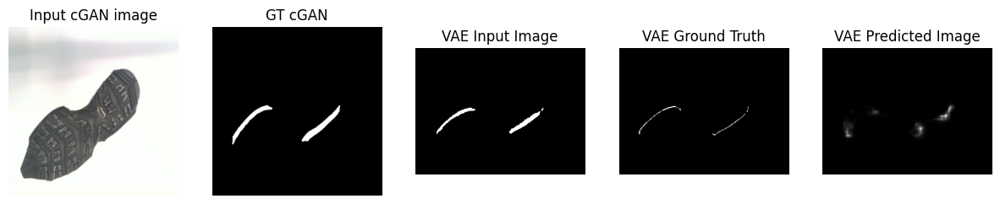

....................................................................................................Time taken for 1000 steps: 779.37 sec

[Epochs-interval: 2/6]__Step: 37k/123k
Train set ELBO: 287.8648681640625
Train set MMD loss: 3530.189208984375
Train set GRADIENT loss: 500664.09375


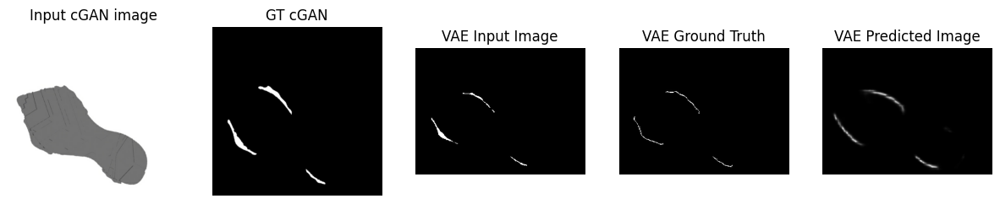

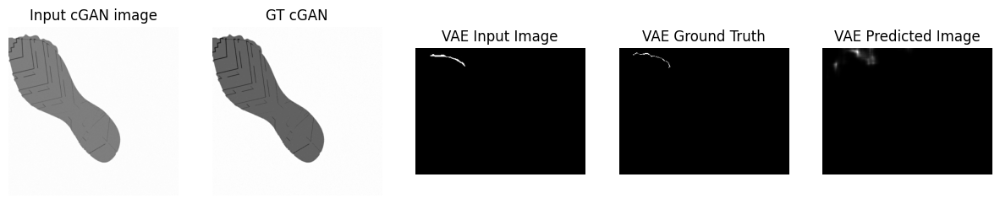

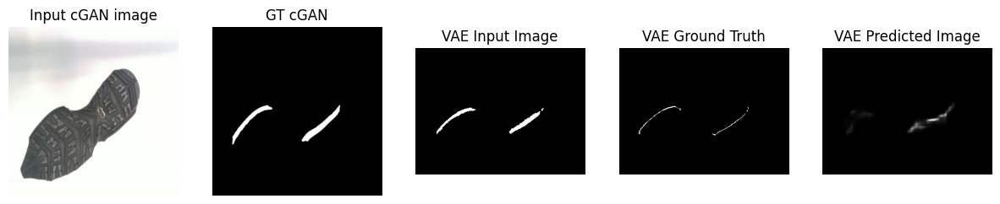

....................................................................................................Time taken for 1000 steps: 800.60 sec

[Epochs-interval: 2/6]__Step: 38k/123k
Train set ELBO: 581.8841552734375
Train set MMD loss: 3629.376220703125
Train set GRADIENT loss: 550747.375


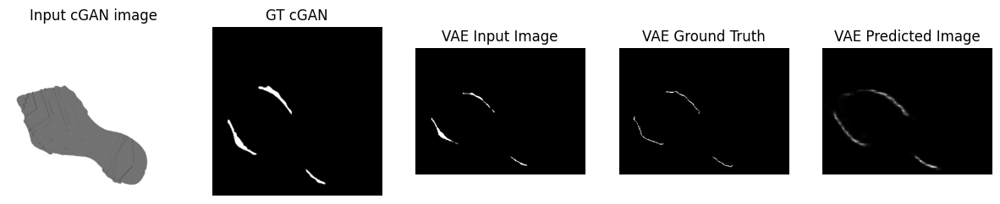

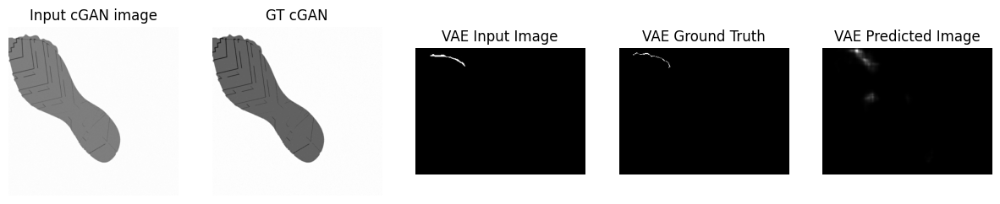

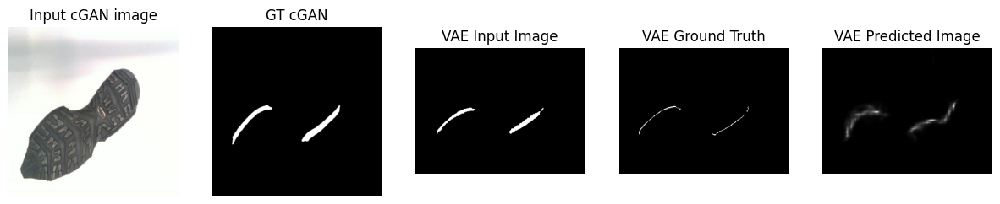

....................................................................................................Time taken for 1000 steps: 822.23 sec

[Epochs-interval: 2/6]__Step: 39k/123k
Train set ELBO: 259.4759521484375
Train set MMD loss: 3764.144287109375
Train set GRADIENT loss: 552845.6875


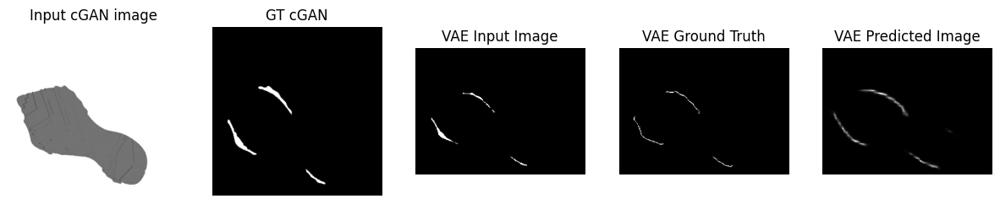

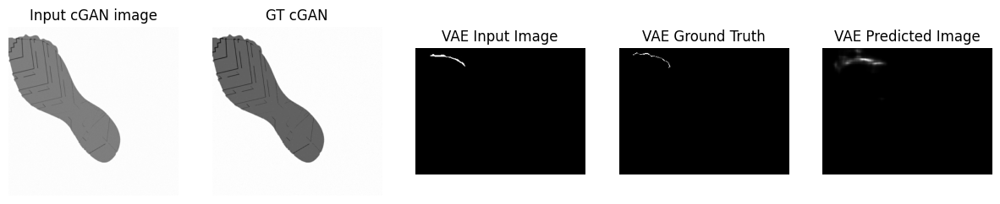

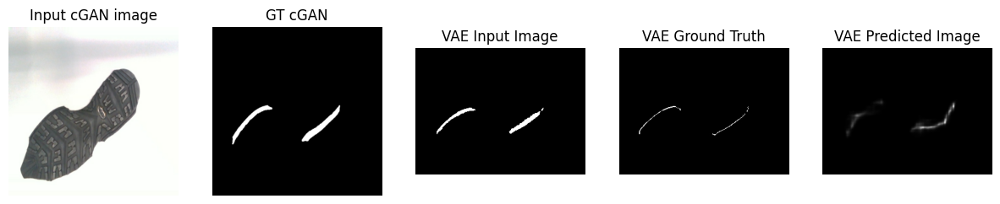

....................................................................................................Time taken for 1000 steps: 843.55 sec

[Epochs-interval: 2/6]__Step: 40k/123k
Train set ELBO: 855.7114868164062
Train set MMD loss: 3963.745849609375
Train set GRADIENT loss: 814009.5625


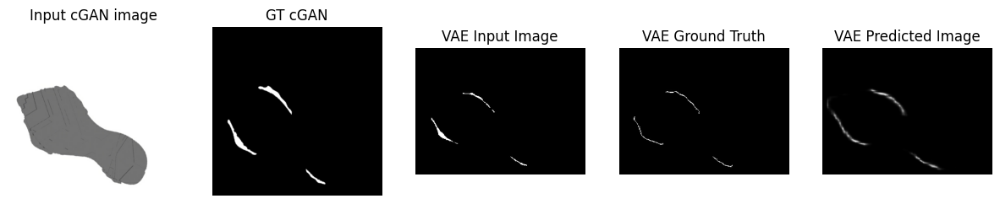

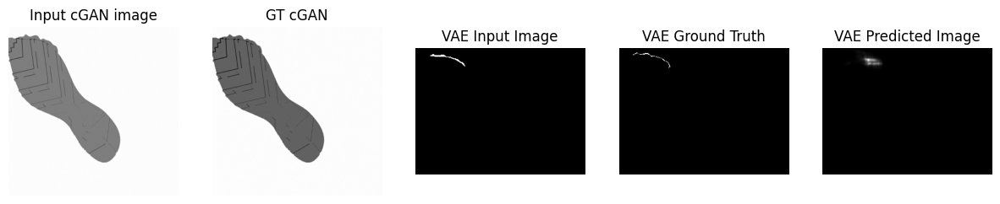

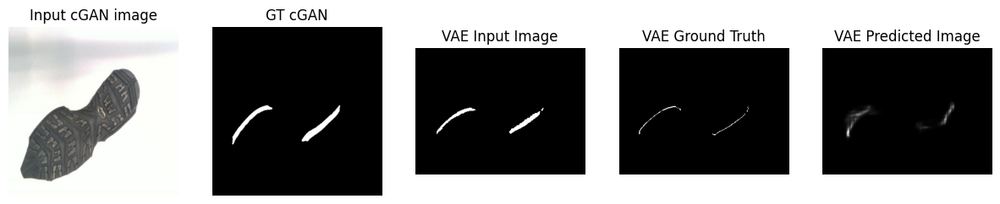

....................................................................................................Time taken for 1000 steps: 865.27 sec

[Epochs-interval: 3/6]__Step: 41k/123k
Train set ELBO: 768.449462890625
Train set MMD loss: 4373.5400390625
Train set GRADIENT loss: 449877.96875


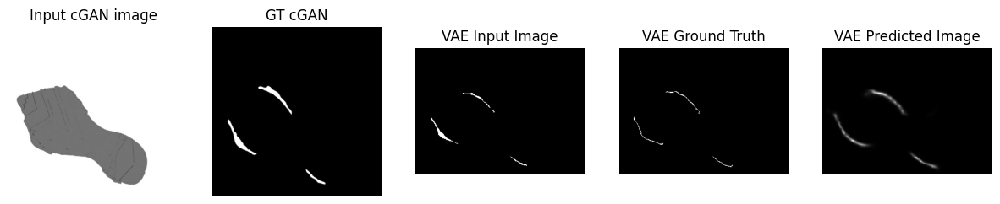

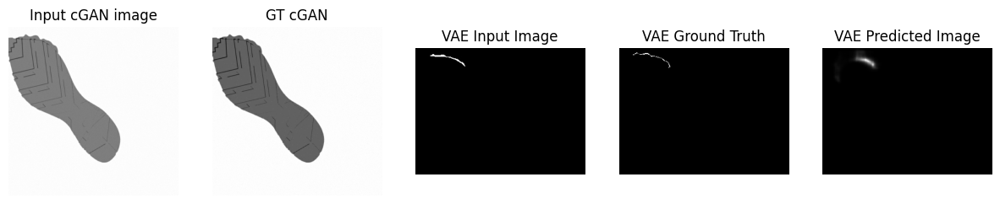

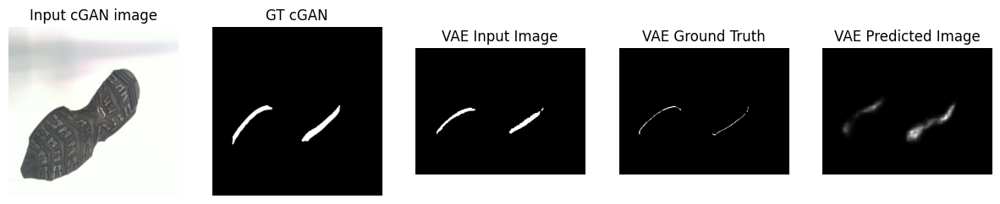

....................................................................................................Time taken for 1000 steps: 886.35 sec

[Epochs-interval: 3/6]__Step: 42k/123k
Train set ELBO: 868.2572021484375
Train set MMD loss: 3711.906982421875
Train set GRADIENT loss: 914995.75


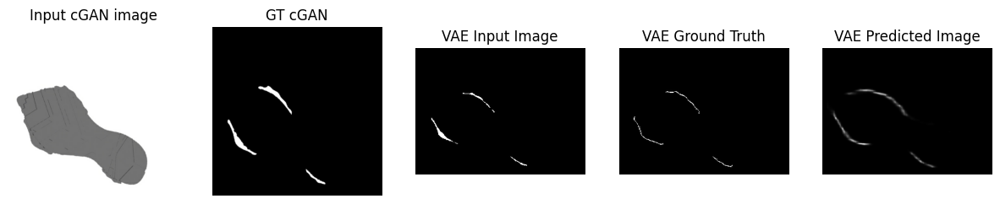

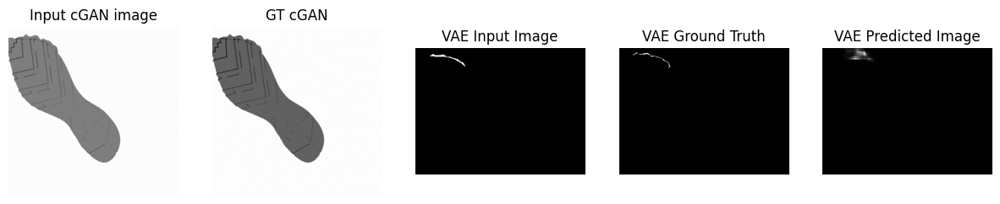

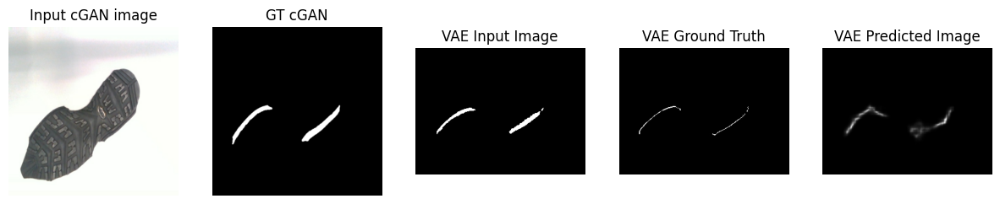

....................................................................................................Time taken for 1000 steps: 907.91 sec

[Epochs-interval: 3/6]__Step: 43k/123k
Train set ELBO: 429.80010986328125
Train set MMD loss: 3987.624267578125
Train set GRADIENT loss: 505840.71875


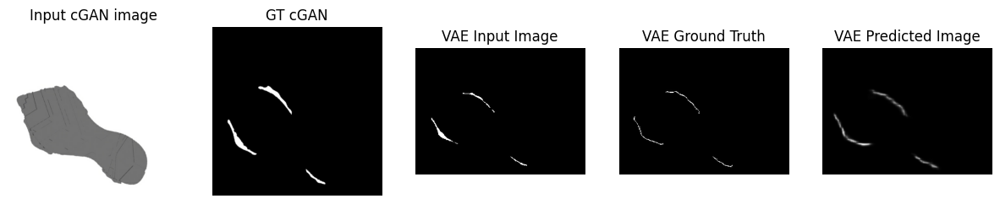

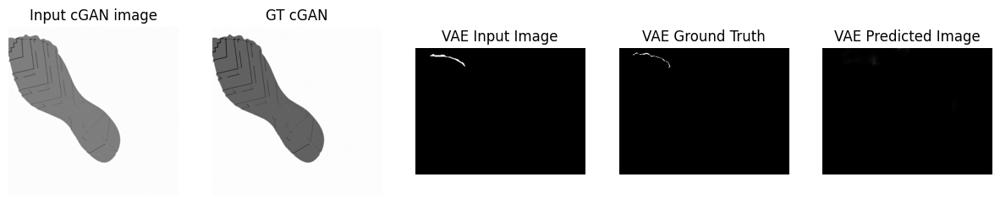

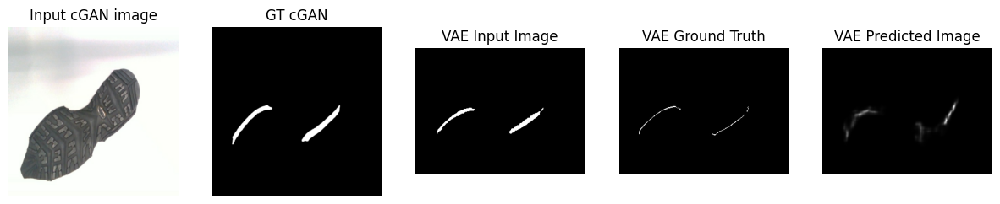

....................................................................................................Time taken for 1000 steps: 929.40 sec

[Epochs-interval: 3/6]__Step: 44k/123k
Train set ELBO: 731.0133666992188
Train set MMD loss: 3936.085693359375
Train set GRADIENT loss: 645779.0


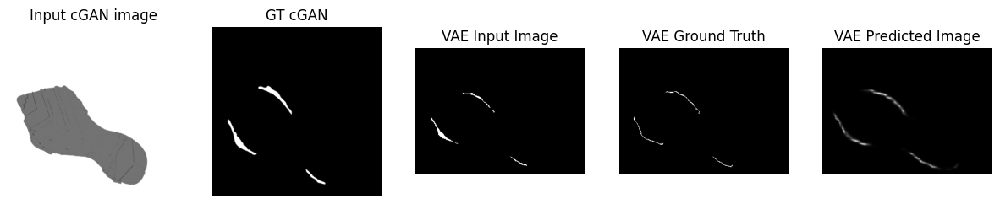

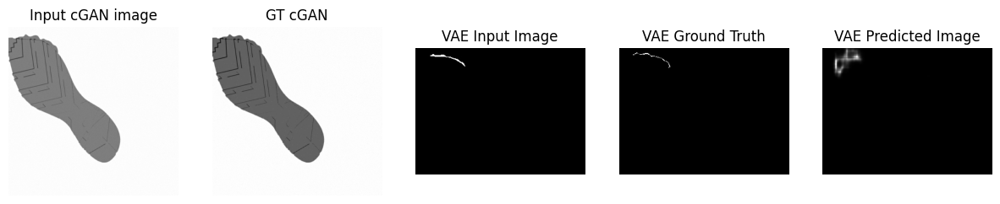

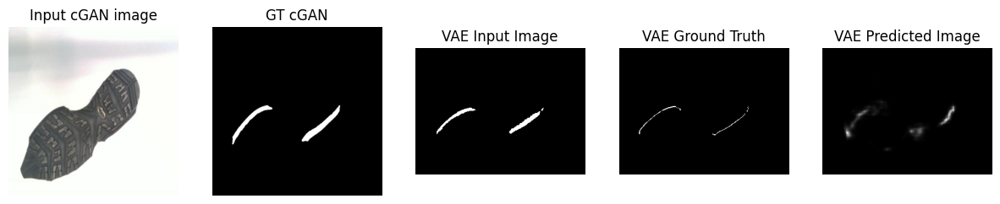

....................................................................................................Time taken for 1000 steps: 950.77 sec

[Epochs-interval: 3/6]__Step: 45k/123k
Train set ELBO: 173.35690307617188
Train set MMD loss: 3152.645751953125
Train set GRADIENT loss: 503137.3125


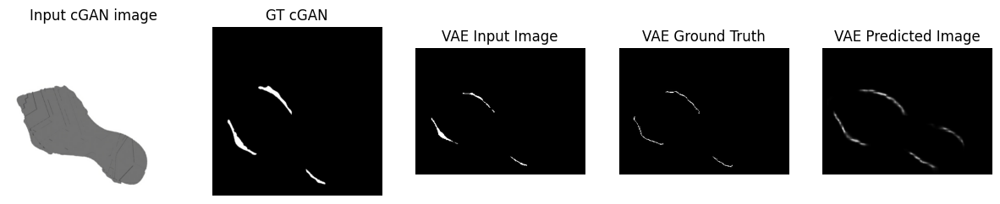

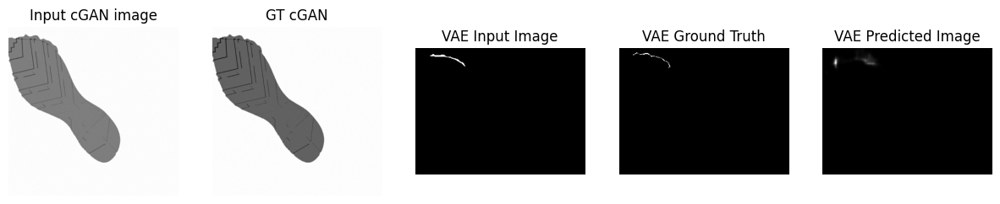

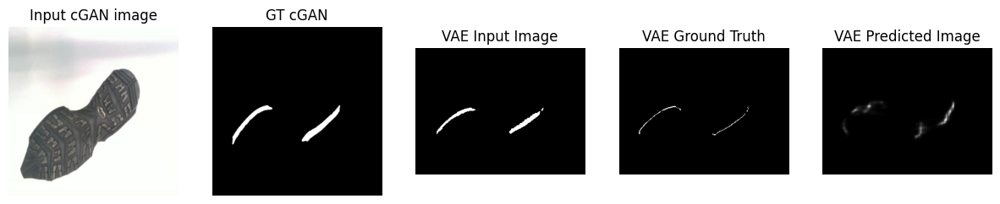

....................................................................................................Time taken for 1000 steps: 972.54 sec

[Epochs-interval: 3/6]__Step: 46k/123k
Train set ELBO: 492.7756042480469
Train set MMD loss: 4302.99658203125
Train set GRADIENT loss: 636778.5625


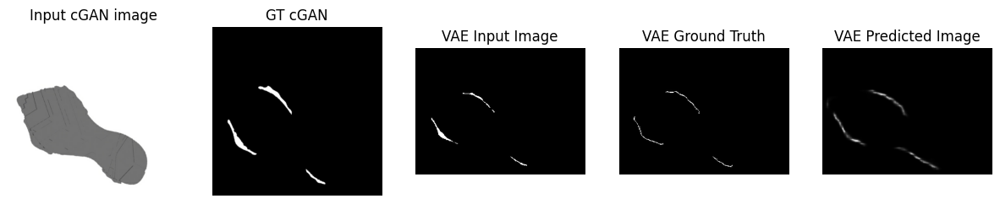

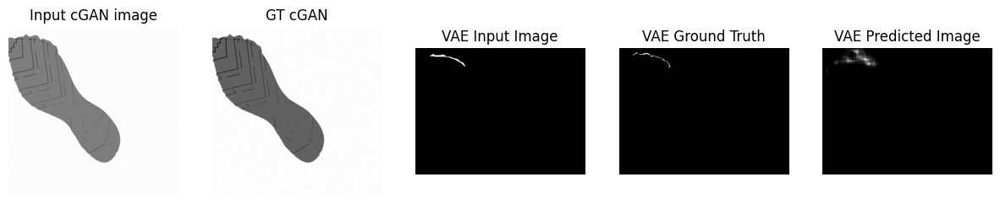

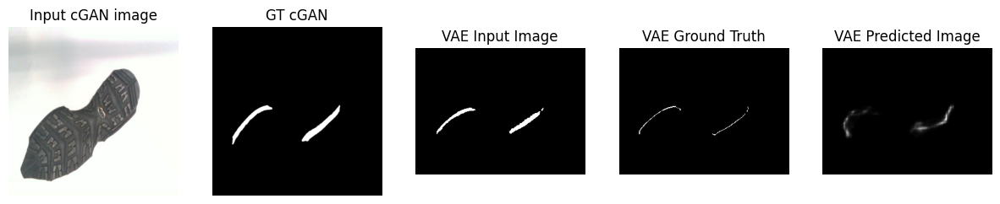

....................................................................................................Time taken for 1000 steps: 993.98 sec

[Epochs-interval: 3/6]__Step: 47k/123k
Train set ELBO: 552.2279052734375
Train set MMD loss: 3731.2119140625
Train set GRADIENT loss: 751471.625


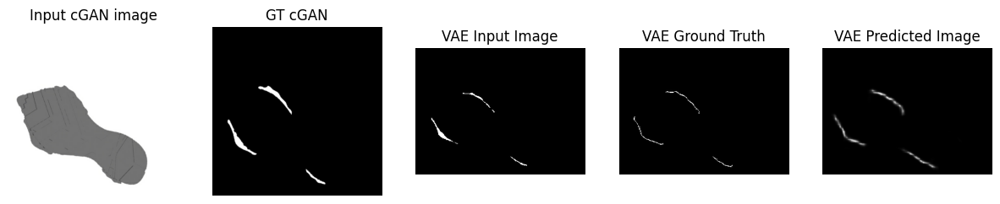

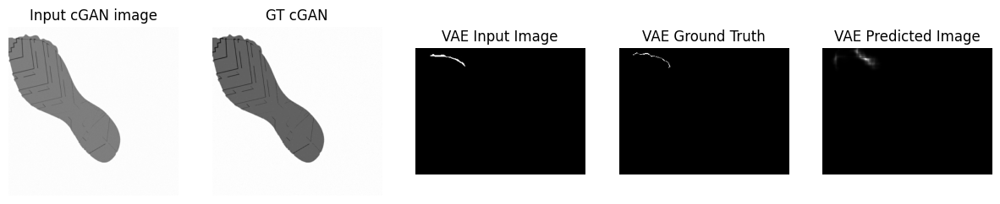

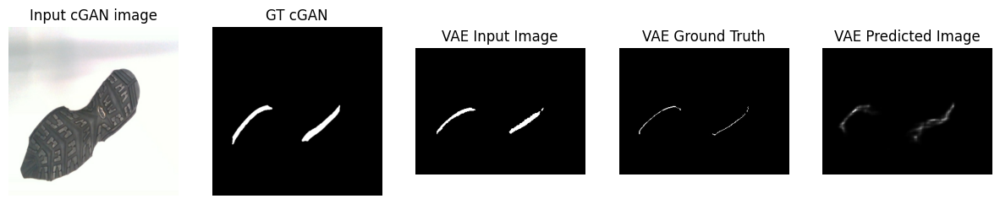

....................................................................................................Time taken for 1000 steps: 1016.21 sec

[Epochs-interval: 3/6]__Step: 48k/123k
Train set ELBO: 491.1653137207031
Train set MMD loss: 3731.722900390625
Train set GRADIENT loss: 576469.5


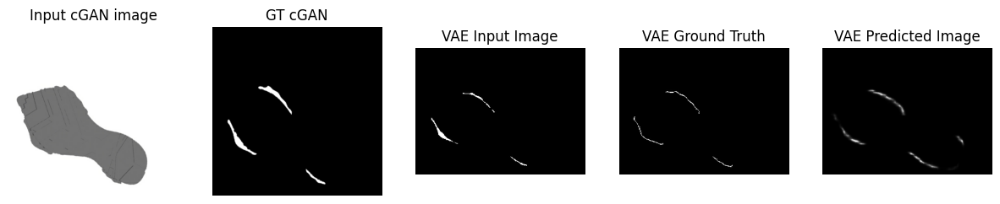

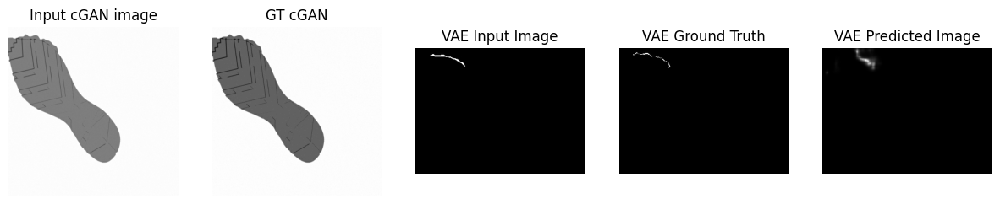

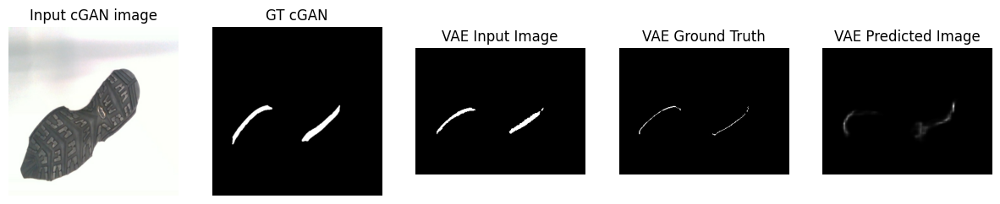

....................................................................................................Time taken for 1000 steps: 1037.67 sec

[Epochs-interval: 3/6]__Step: 49k/123k
Train set ELBO: 7.53033447265625
Train set MMD loss: 3716.479736328125
Train set GRADIENT loss: 352750.15625


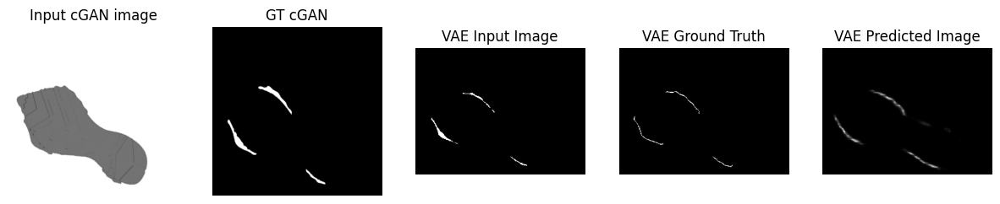

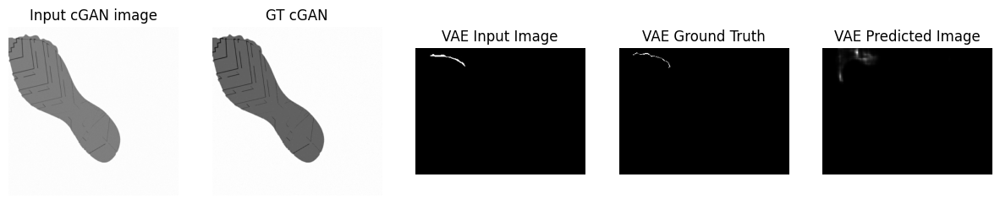

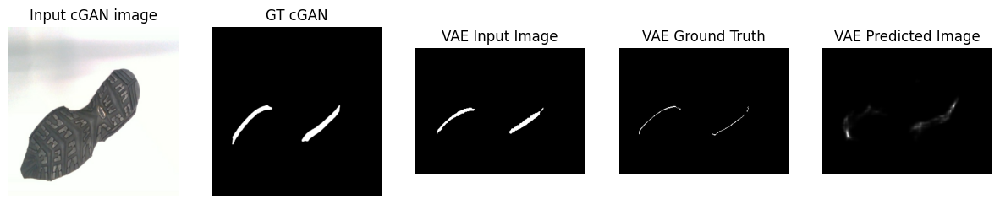

....................................................................................................Time taken for 1000 steps: 1059.66 sec

[Epochs-interval: 3/6]__Step: 50k/123k
Train set ELBO: 271.2757263183594
Train set MMD loss: 3572.7587890625
Train set GRADIENT loss: 537375.0625


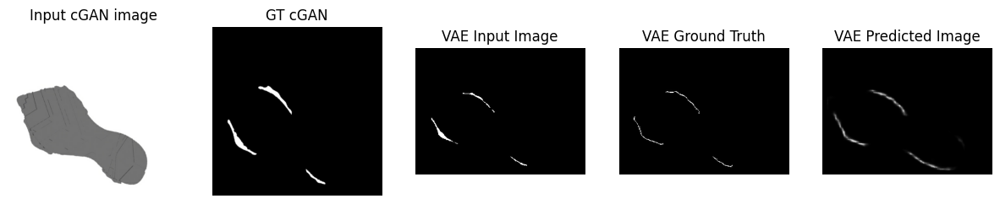

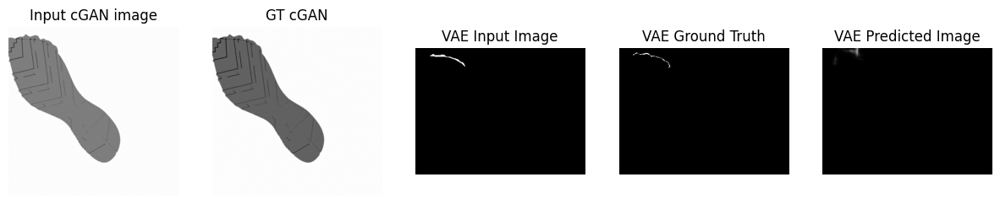

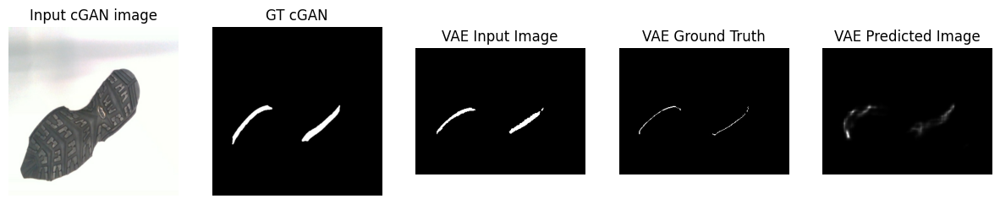

....................................................................................................Time taken for 1000 steps: 1081.08 sec

[Epochs-interval: 3/6]__Step: 51k/123k
Train set ELBO: 693.9577026367188
Train set MMD loss: 2871.40869140625
Train set GRADIENT loss: 642627.125


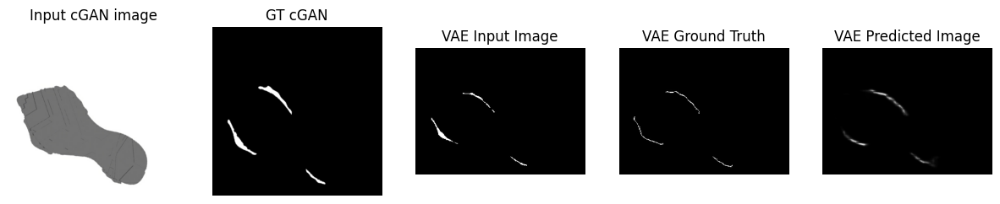

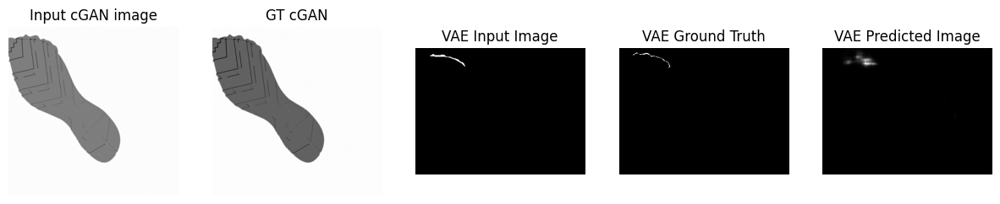

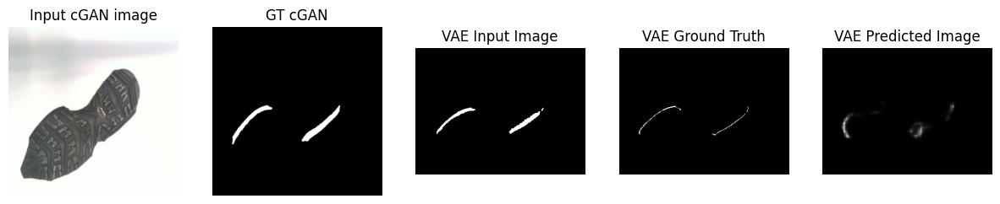

....................................................................................................Time taken for 1000 steps: 1103.60 sec

[Epochs-interval: 3/6]__Step: 52k/123k
Train set ELBO: 768.2545166015625
Train set MMD loss: 3588.27880859375
Train set GRADIENT loss: 843726.75


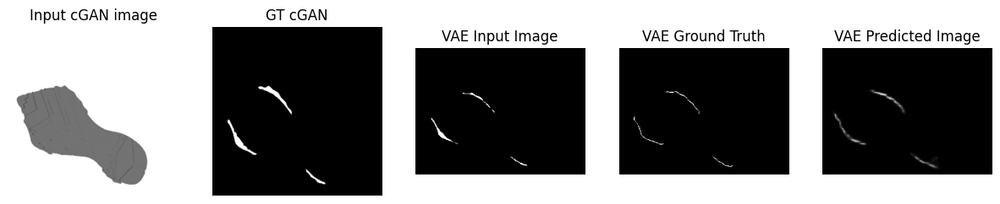

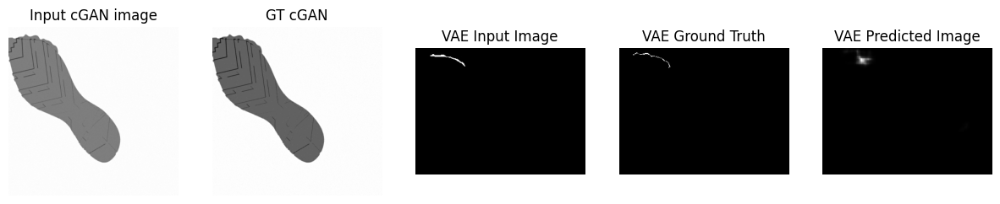

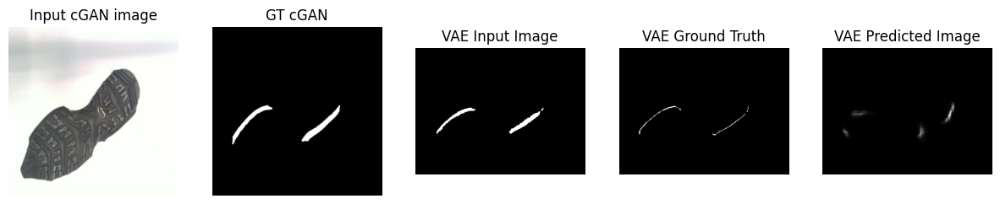

....................................................................................................Time taken for 1000 steps: 1125.00 sec

[Epochs-interval: 3/6]__Step: 53k/123k
Train set ELBO: 175.3610382080078
Train set MMD loss: 4161.767578125
Train set GRADIENT loss: 572721.6875


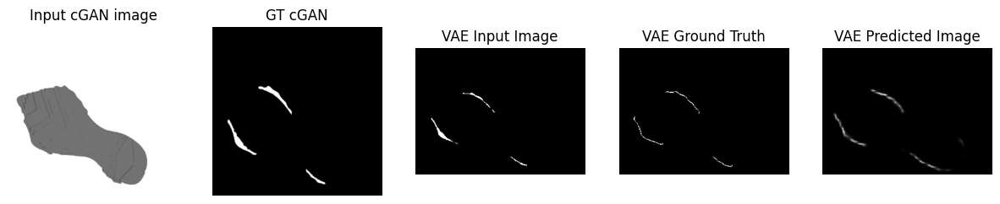

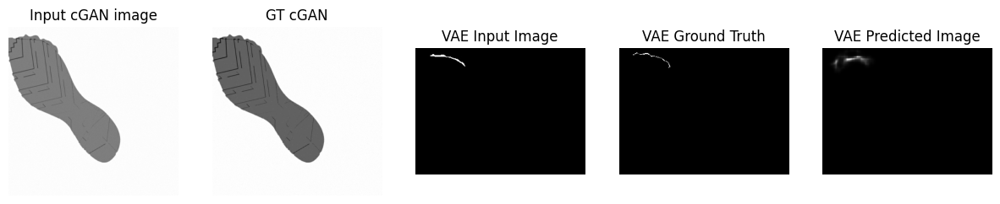

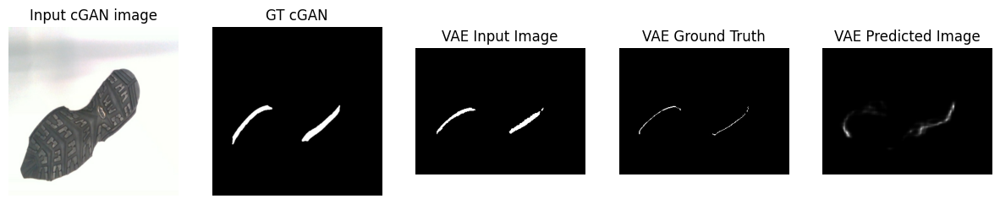

....................................................................................................Time taken for 1000 steps: 1146.88 sec

[Epochs-interval: 3/6]__Step: 54k/123k
Train set ELBO: 834.2094116210938
Train set MMD loss: 4223.55908203125
Train set GRADIENT loss: 724043.0625


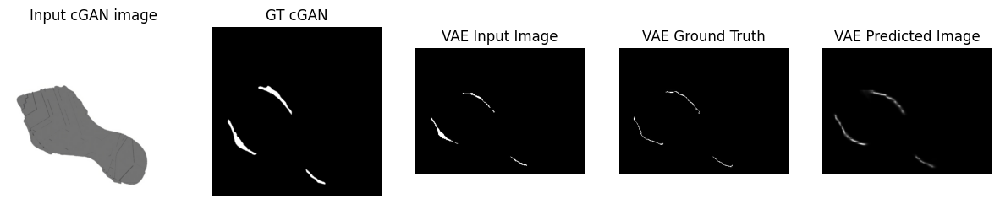

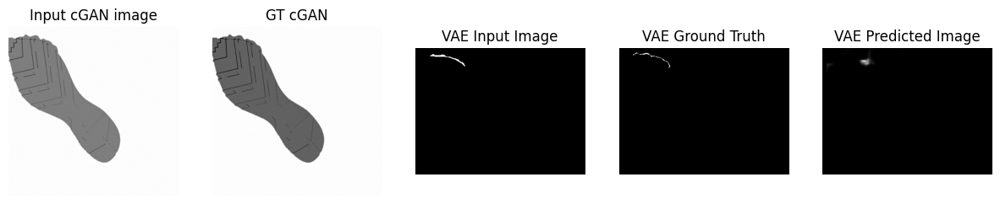

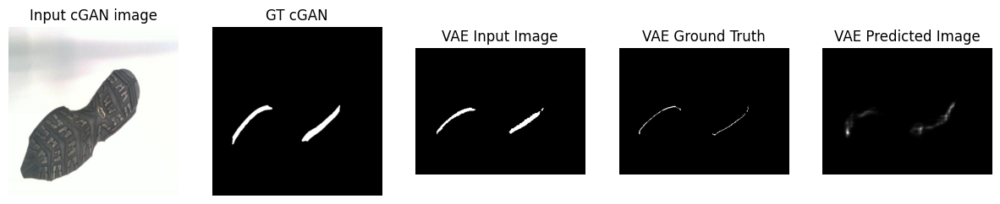

....................................................................................................Time taken for 1000 steps: 1168.35 sec

[Epochs-interval: 3/6]__Step: 55k/123k
Train set ELBO: 896.0332641601562
Train set MMD loss: 3430.604736328125
Train set GRADIENT loss: 678147.0625


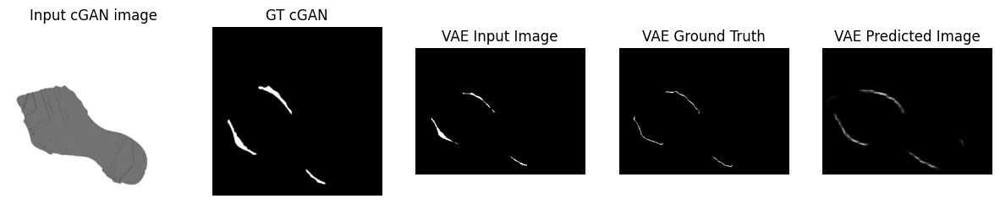

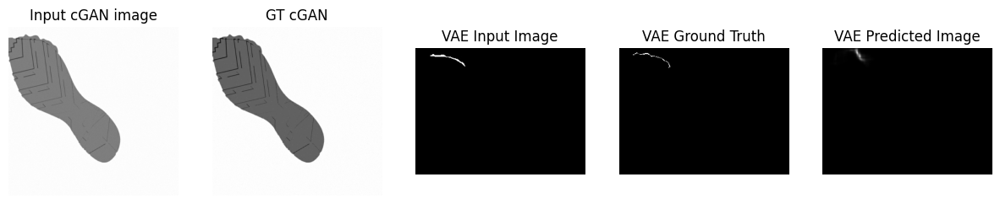

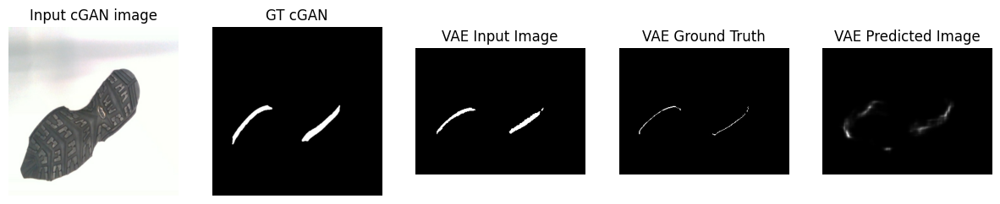

....................................................................................................Time taken for 1000 steps: 1190.72 sec

[Epochs-interval: 3/6]__Step: 56k/123k
Train set ELBO: 316.9194641113281
Train set MMD loss: 3175.69921875
Train set GRADIENT loss: 506432.15625


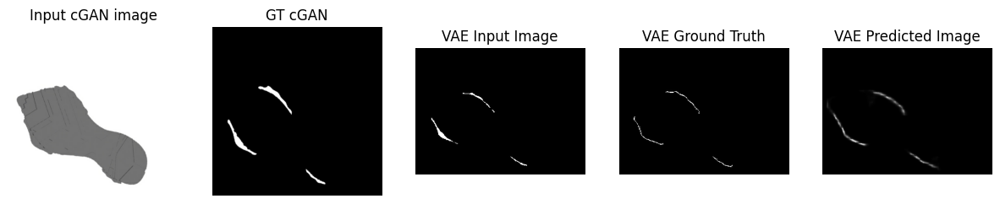

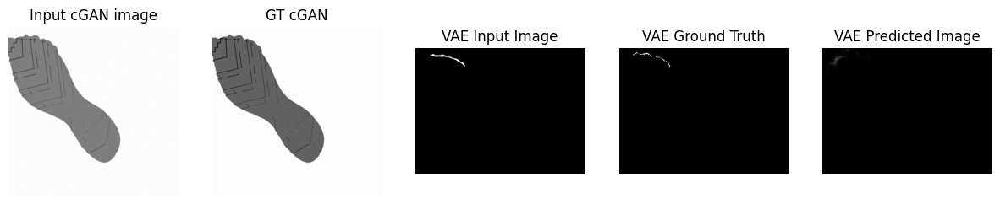

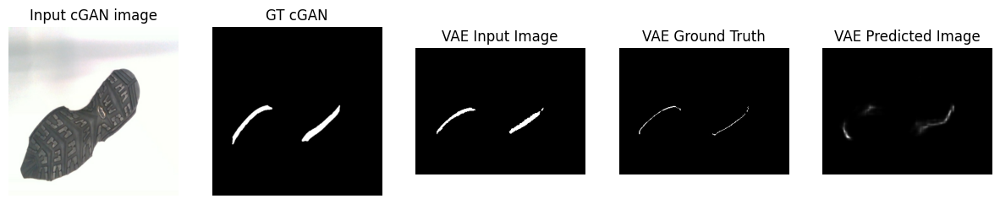

....................................................................................................Time taken for 1000 steps: 1212.44 sec

[Epochs-interval: 3/6]__Step: 57k/123k
Train set ELBO: 432.15753173828125
Train set MMD loss: 3490.41259765625
Train set GRADIENT loss: 498531.96875


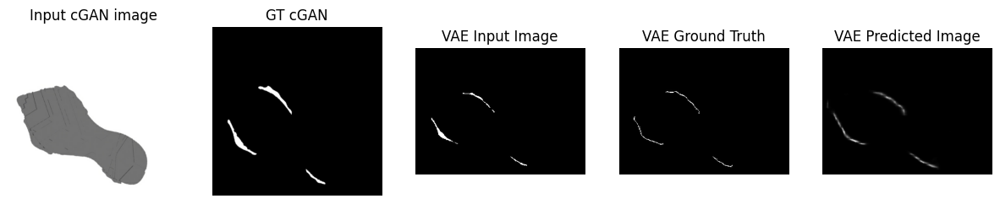

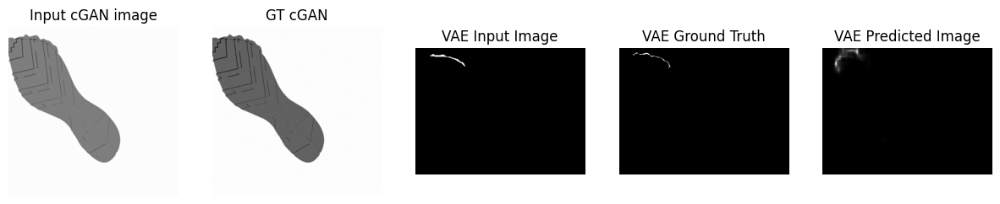

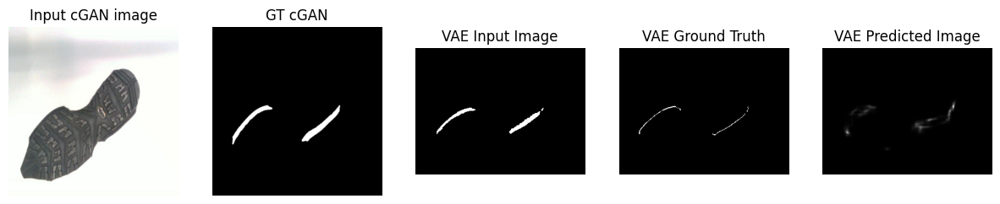

....................................................................................................Time taken for 1000 steps: 1234.40 sec

[Epochs-interval: 3/6]__Step: 58k/123k
Train set ELBO: 386.2548828125
Train set MMD loss: 3786.125732421875
Train set GRADIENT loss: 618733.5625


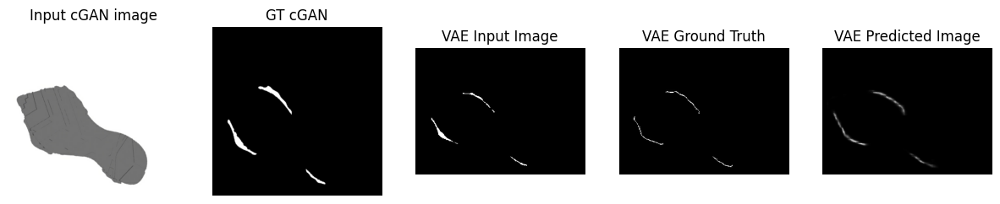

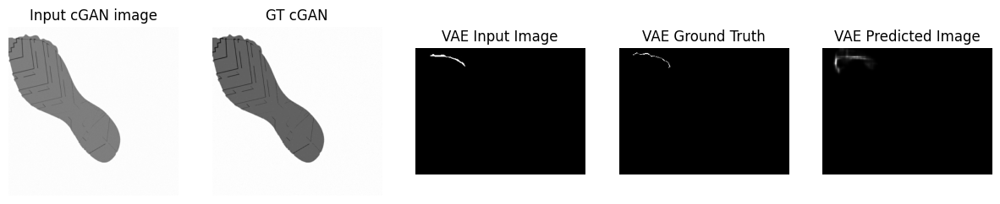

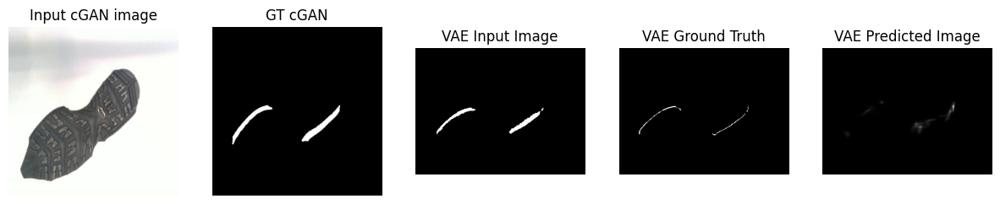

....................................................................................................Time taken for 1000 steps: 1256.24 sec

[Epochs-interval: 3/6]__Step: 59k/123k
Train set ELBO: 607.5183715820312
Train set MMD loss: 4660.9560546875
Train set GRADIENT loss: 622342.1875


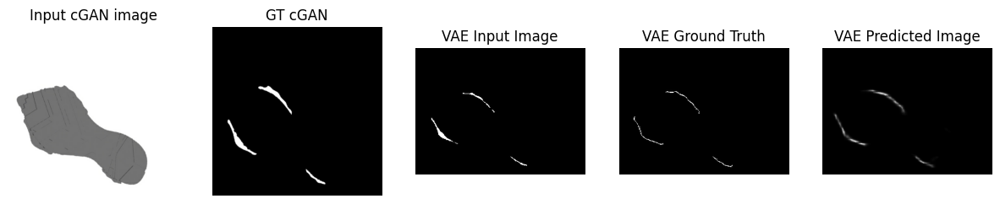

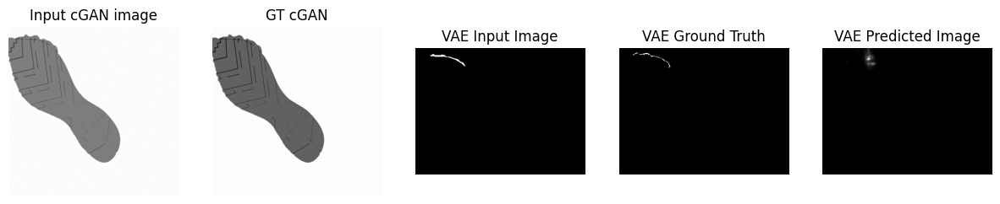

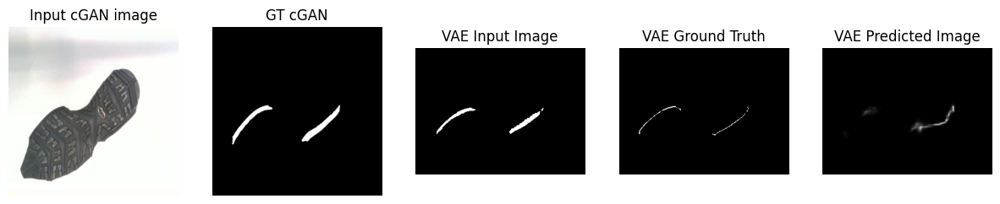

....................................................................................................Time taken for 1000 steps: 1278.27 sec

[Epochs-interval: 3/6]__Step: 60k/123k
Train set ELBO: 713.2103271484375
Train set MMD loss: 3176.38427734375
Train set GRADIENT loss: 628934.4375


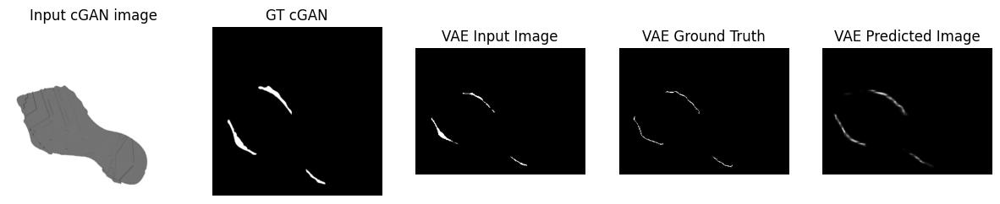

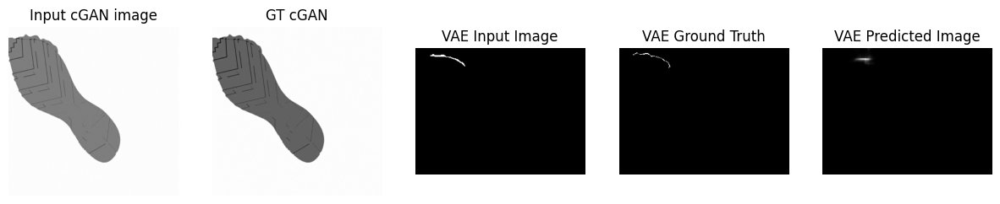

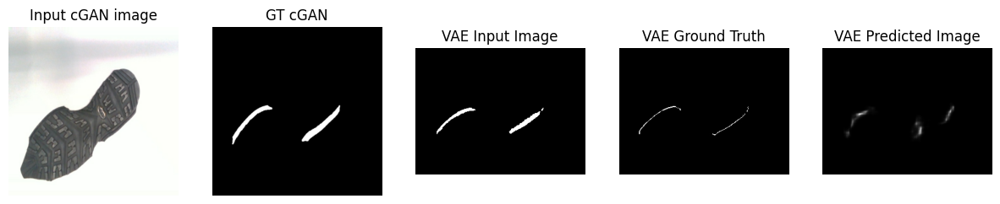

....................................................................................................Time taken for 1000 steps: 1300.61 sec

[Epochs-interval: 3/6]__Step: 61k/123k
Train set ELBO: 1629.7503662109375
Train set MMD loss: 3604.373291015625
Train set GRADIENT loss: 684237.125


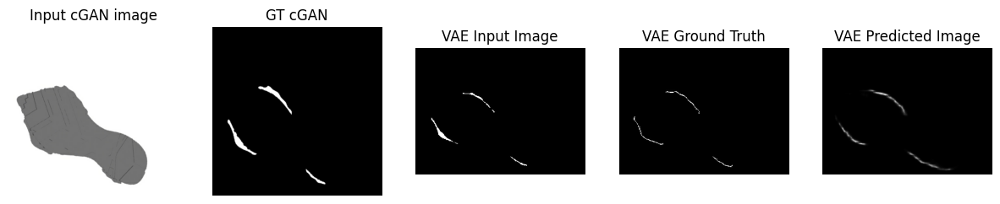

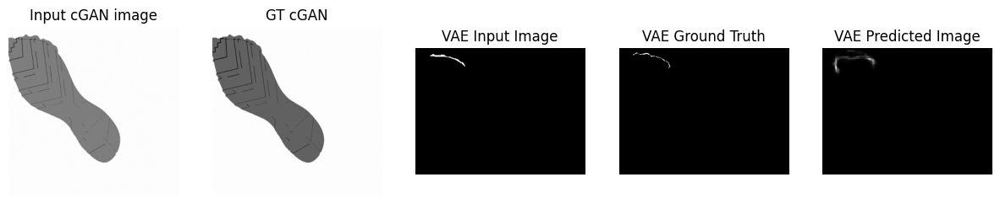

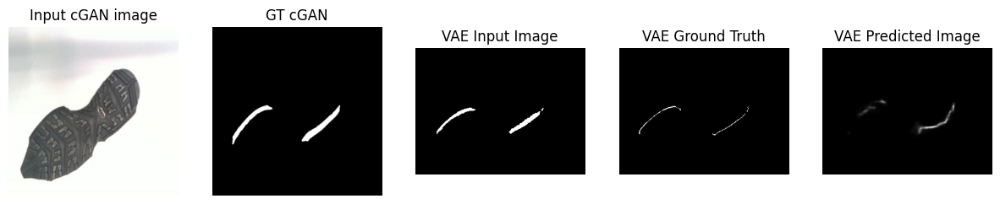

....................................................................................................Time taken for 1000 steps: 1322.59 sec

[Epochs-interval: 4/6]__Step: 62k/123k
Train set ELBO: 42.908260345458984
Train set MMD loss: 4829.4990234375
Train set GRADIENT loss: 578815.625


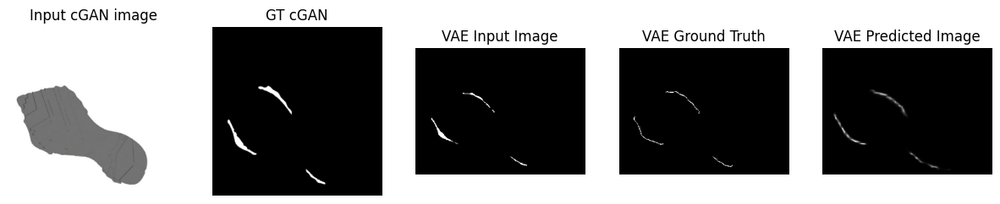

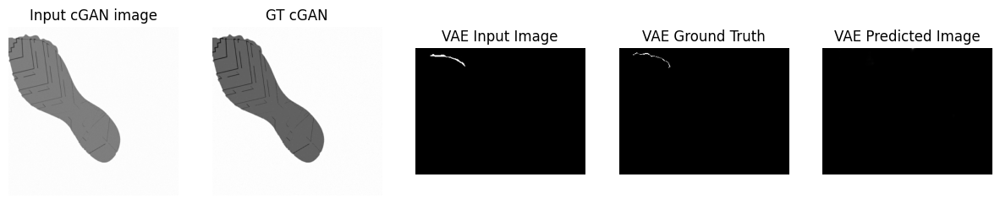

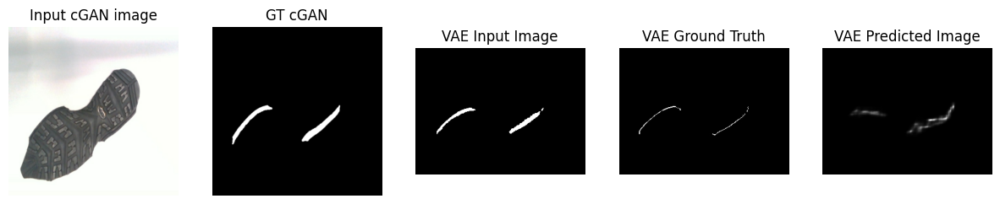

....................................................................................................Time taken for 1000 steps: 1344.98 sec

[Epochs-interval: 4/6]__Step: 63k/123k
Train set ELBO: 524.2508544921875
Train set MMD loss: 3372.269775390625
Train set GRADIENT loss: 692538.625


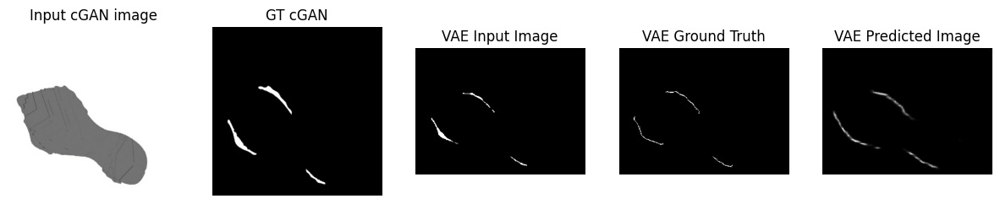

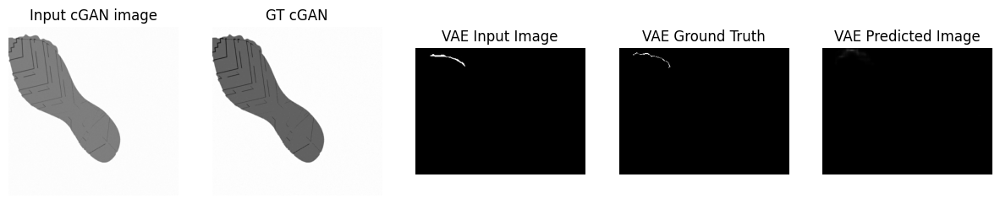

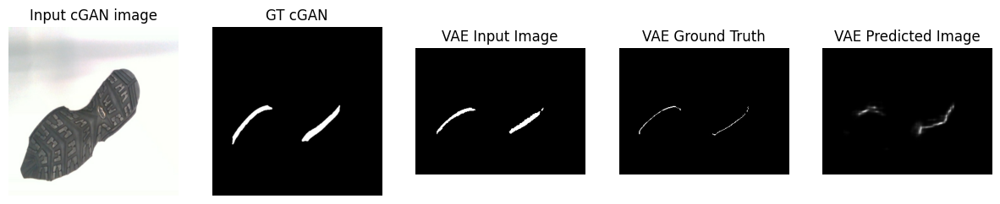

....................................................................................................Time taken for 1000 steps: 1367.52 sec

[Epochs-interval: 4/6]__Step: 64k/123k
Train set ELBO: 3.403076171875
Train set MMD loss: 4032.71533203125
Train set GRADIENT loss: 420641.28125


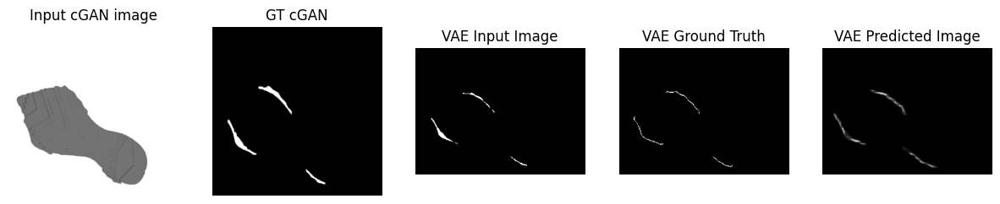

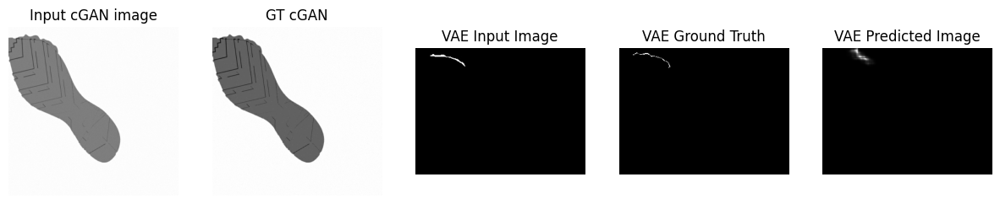

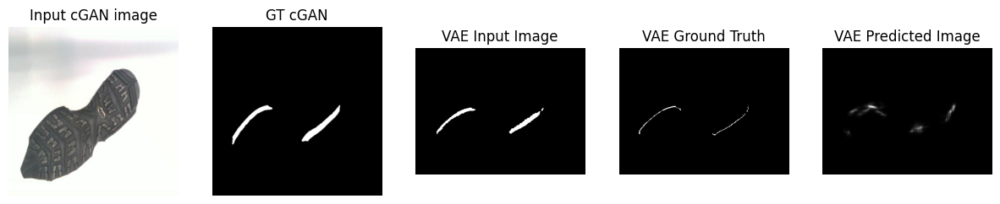

....................................................................................................Time taken for 1000 steps: 1390.08 sec

[Epochs-interval: 4/6]__Step: 65k/123k
Train set ELBO: 371.90899658203125
Train set MMD loss: 3558.469970703125
Train set GRADIENT loss: 546943.3125


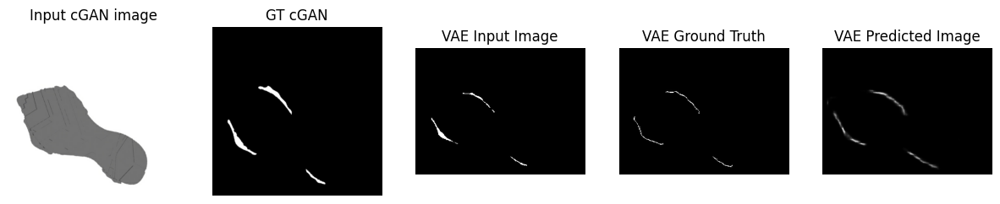

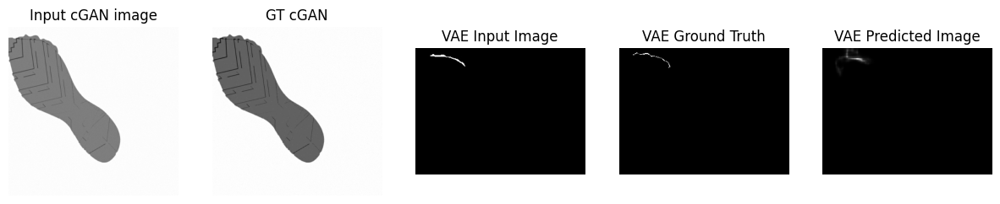

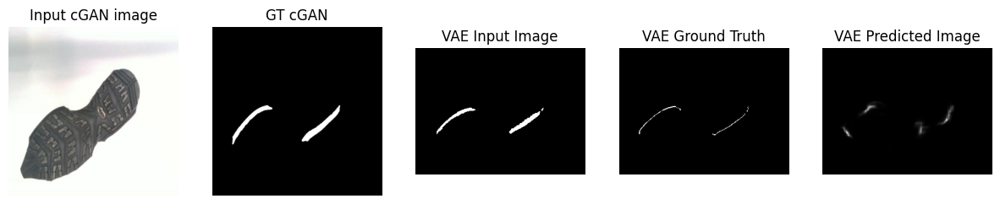

....................................................................................................Time taken for 1000 steps: 1412.07 sec

[Epochs-interval: 4/6]__Step: 66k/123k
Train set ELBO: 6.538219451904297
Train set MMD loss: 4092.44873046875
Train set GRADIENT loss: 422179.5625


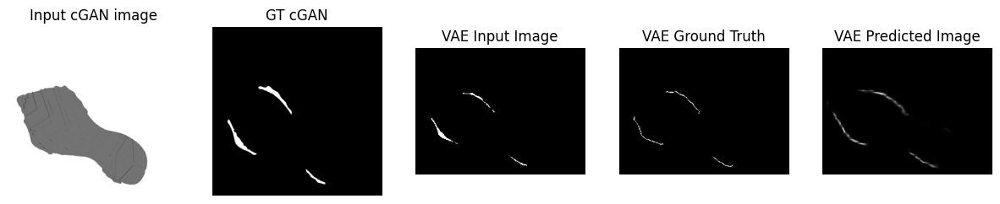

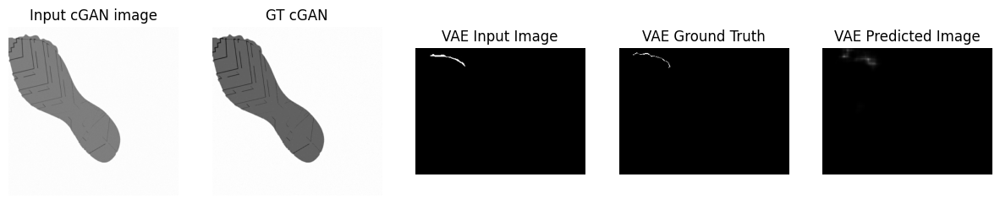

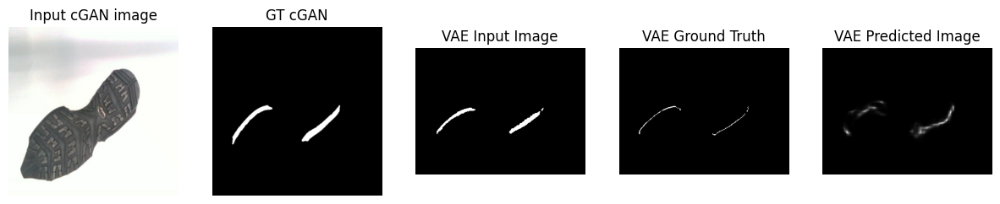

....................................................................................................Time taken for 1000 steps: 1434.63 sec

[Epochs-interval: 4/6]__Step: 67k/123k
Train set ELBO: 146.5641632080078
Train set MMD loss: 3390.227783203125
Train set GRADIENT loss: 350767.25


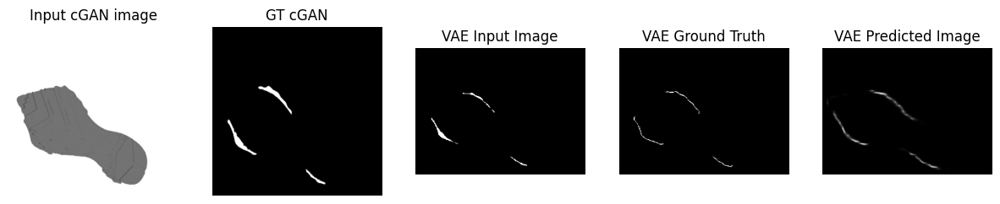

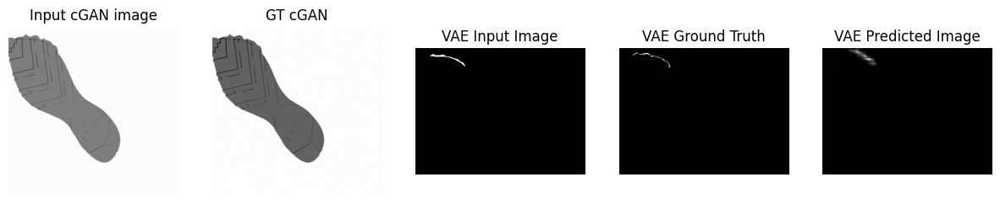

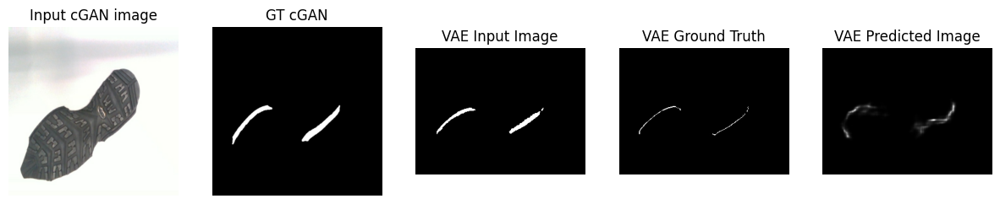

....................................................................................................Time taken for 1000 steps: 1457.30 sec

[Epochs-interval: 4/6]__Step: 68k/123k
Train set ELBO: 825.1080322265625
Train set MMD loss: 4253.5380859375
Train set GRADIENT loss: 768579.5625


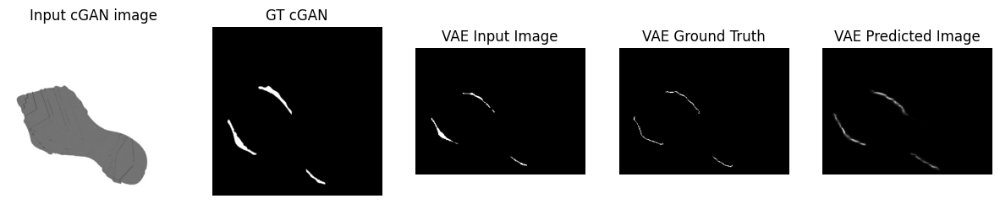

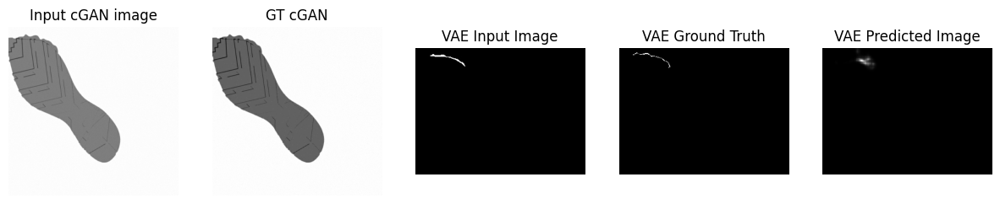

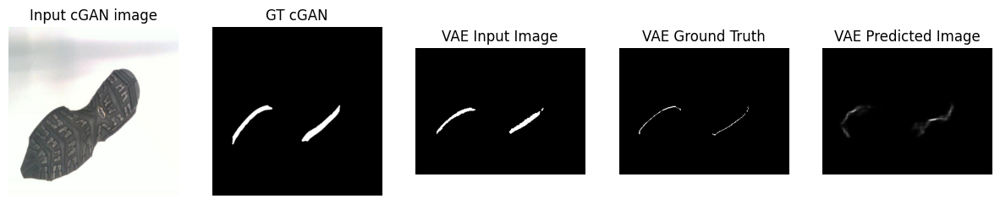

....................................................................................................Time taken for 1000 steps: 1480.20 sec

[Epochs-interval: 4/6]__Step: 69k/123k
Train set ELBO: 685.3734130859375
Train set MMD loss: 3460.32958984375
Train set GRADIENT loss: 580131.4375


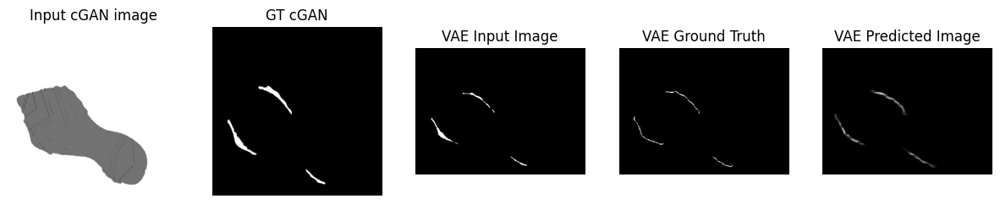

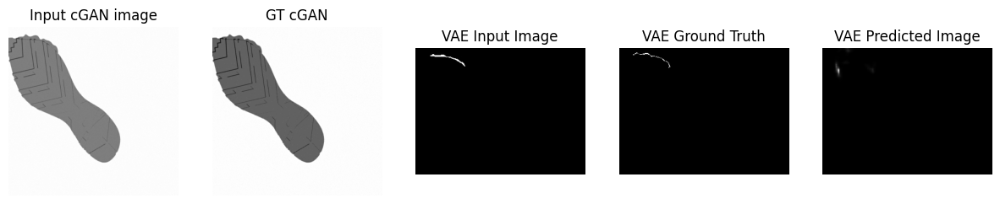

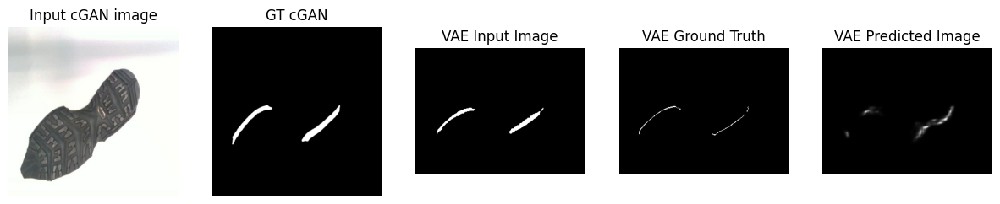

....................................................................................................Time taken for 1000 steps: 1502.40 sec

[Epochs-interval: 4/6]__Step: 70k/123k
Train set ELBO: 1089.616455078125
Train set MMD loss: 4092.09765625
Train set GRADIENT loss: 603750.75


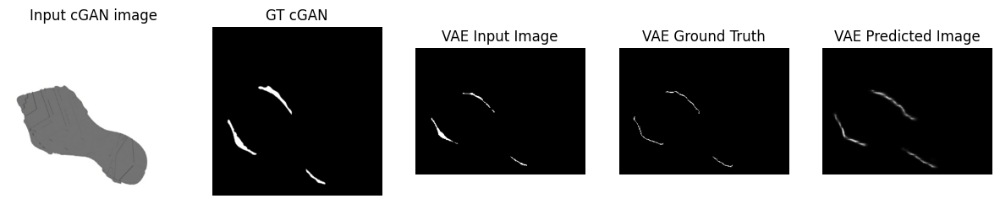

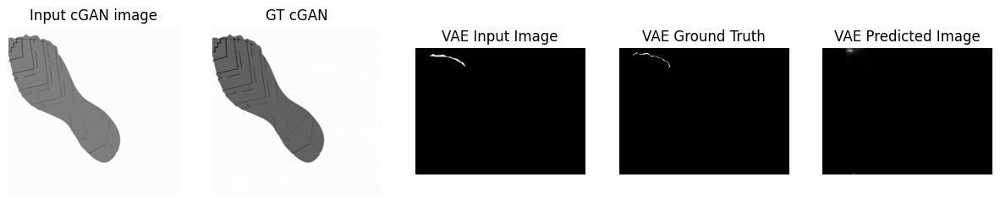

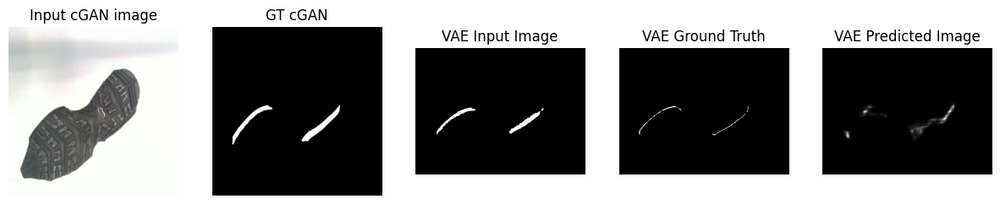

....................................................................................................Time taken for 1000 steps: 1524.84 sec

[Epochs-interval: 4/6]__Step: 71k/123k
Train set ELBO: 282.73681640625
Train set MMD loss: 3743.74560546875
Train set GRADIENT loss: 472514.71875


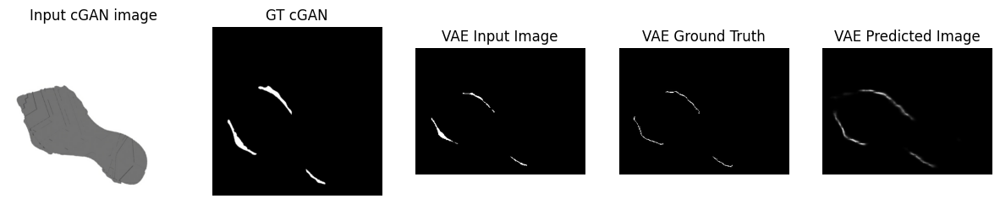

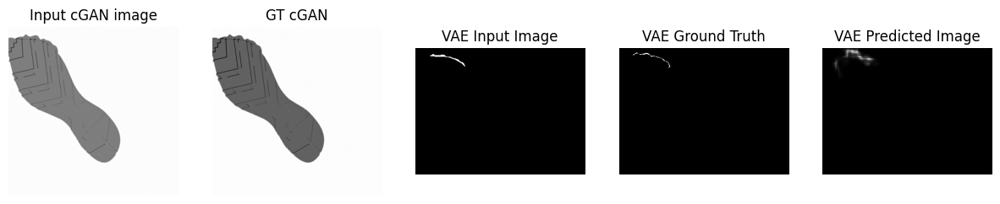

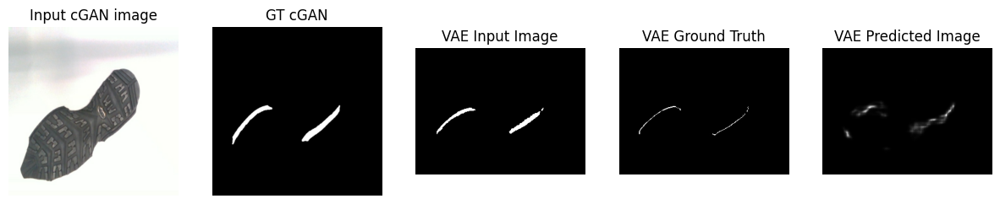

....................................................................................................Time taken for 1000 steps: 1547.66 sec

[Epochs-interval: 4/6]__Step: 72k/123k
Train set ELBO: 987.3316040039062
Train set MMD loss: 4435.771484375
Train set GRADIENT loss: 614482.3125


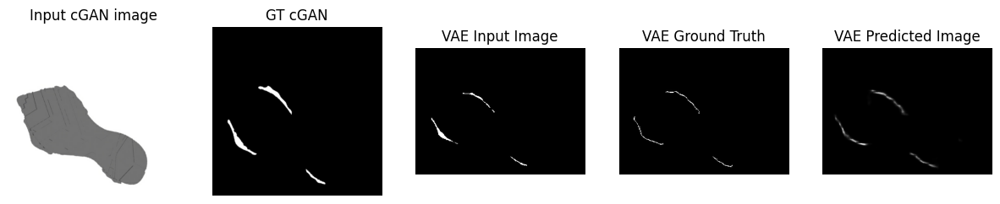

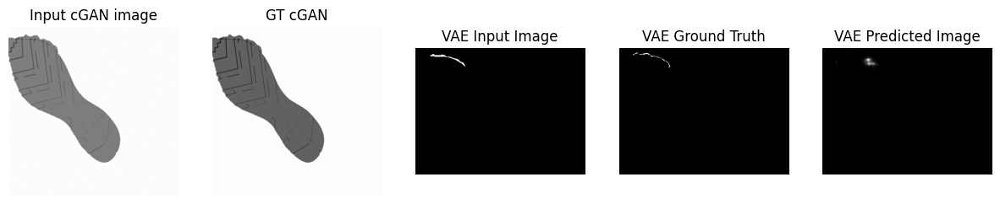

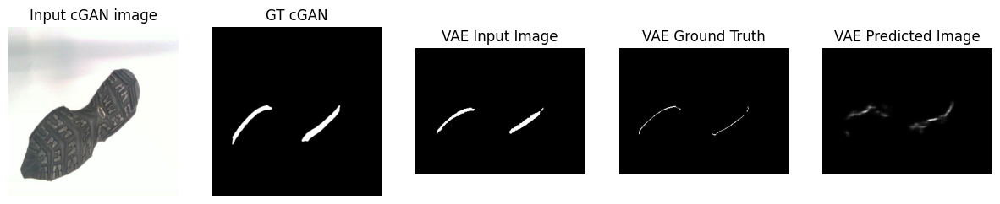

....................................................................................................Time taken for 1000 steps: 1570.23 sec

[Epochs-interval: 4/6]__Step: 73k/123k
Train set ELBO: 490.6680908203125
Train set MMD loss: 3779.191162109375
Train set GRADIENT loss: 715223.3125


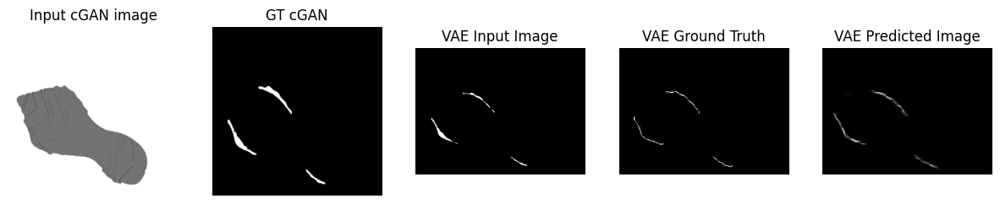

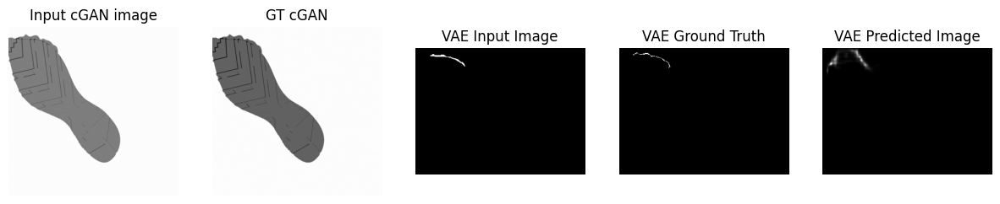

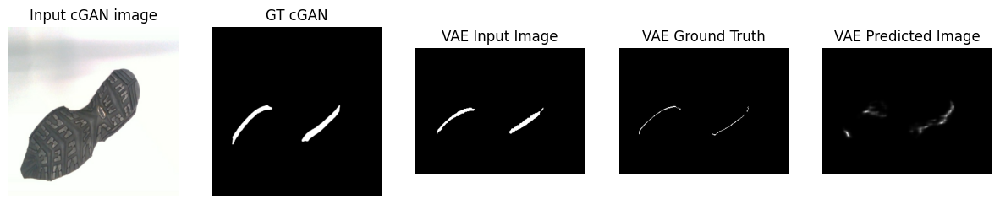

....................................................................................................Time taken for 1000 steps: 1592.41 sec

[Epochs-interval: 4/6]__Step: 74k/123k
Train set ELBO: 17.956554412841797
Train set MMD loss: 3149.06298828125
Train set GRADIENT loss: 266621.90625


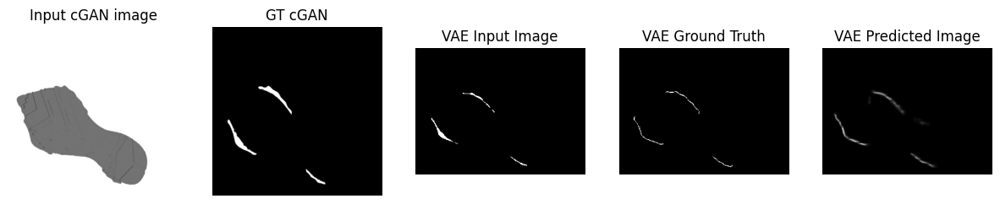

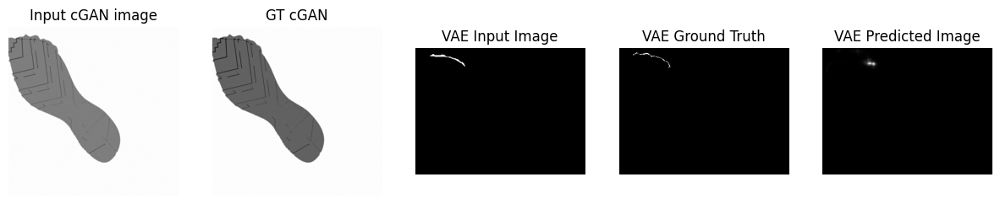

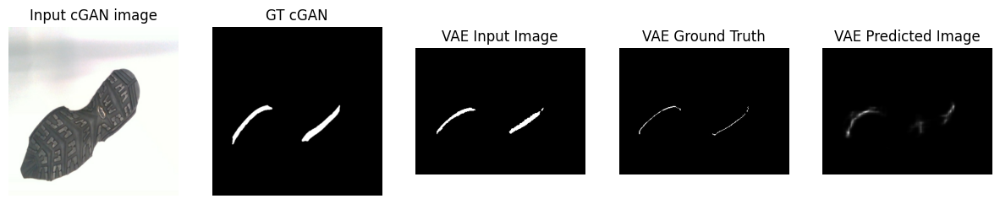

....................................................................................................Time taken for 1000 steps: 1614.71 sec

[Epochs-interval: 4/6]__Step: 75k/123k
Train set ELBO: 670.3681640625
Train set MMD loss: 2617.75732421875
Train set GRADIENT loss: 640118.4375


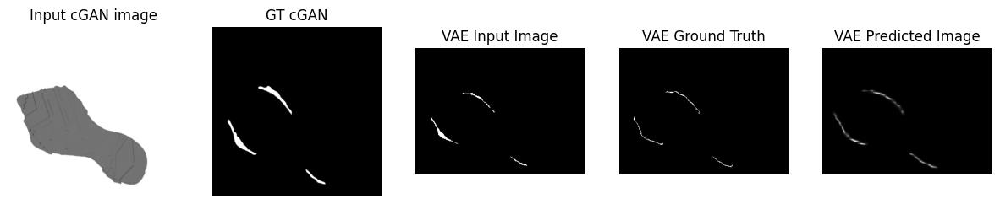

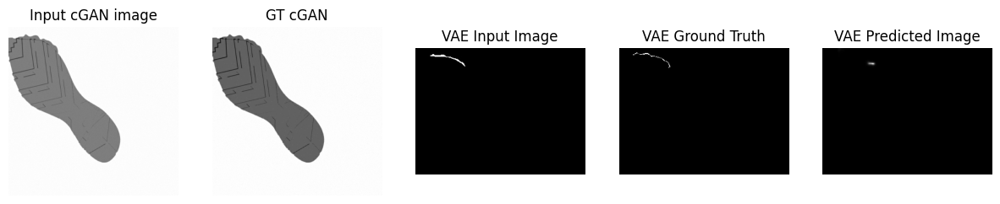

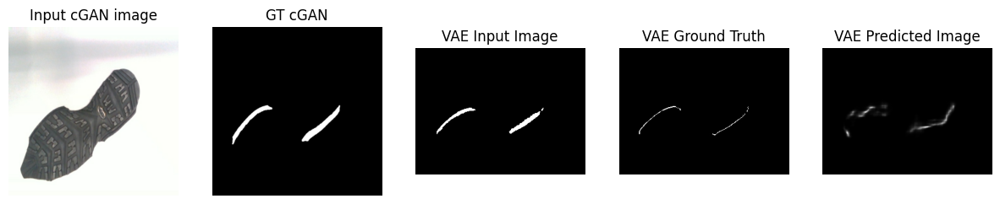

....................................................................................................Time taken for 1000 steps: 1637.48 sec

[Epochs-interval: 4/6]__Step: 76k/123k
Train set ELBO: 6.432136535644531
Train set MMD loss: 3364.891357421875
Train set GRADIENT loss: 448686.3125


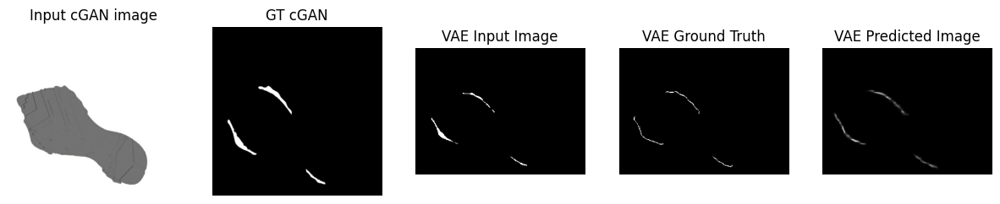

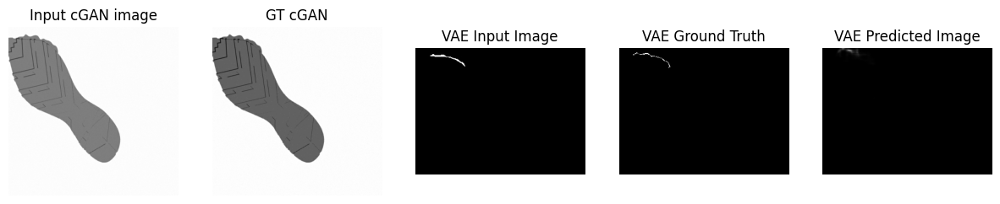

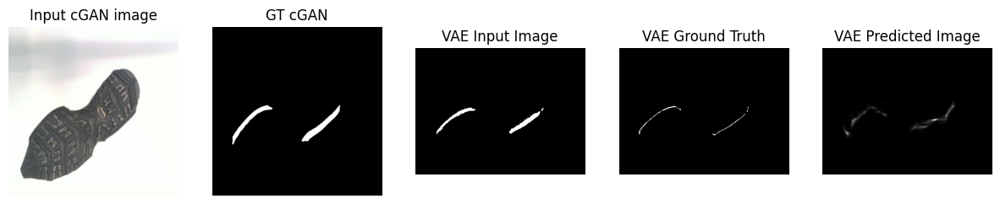

....................................................................................................Time taken for 1000 steps: 1659.74 sec

[Epochs-interval: 4/6]__Step: 77k/123k
Train set ELBO: 175.97084045410156
Train set MMD loss: 2960.076416015625
Train set GRADIENT loss: 333166.15625


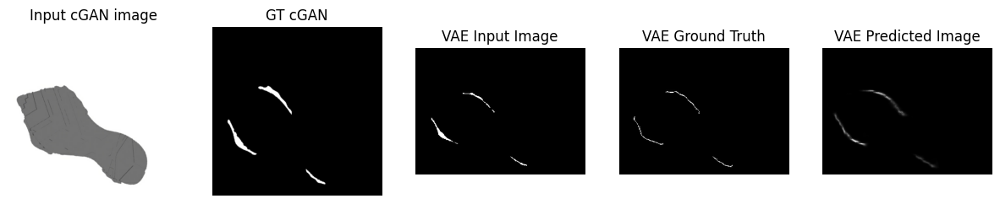

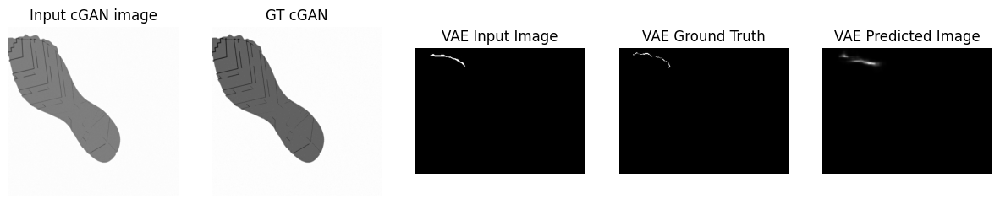

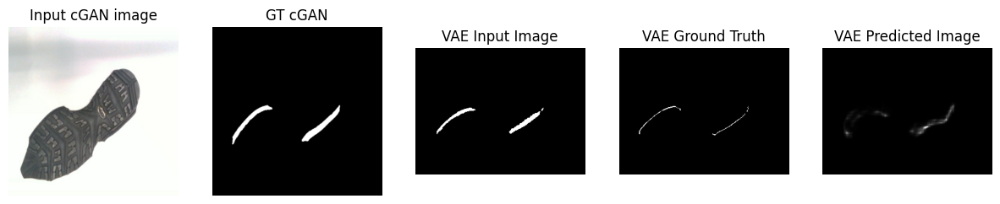

....................................................................................................Time taken for 1000 steps: 1682.11 sec

[Epochs-interval: 4/6]__Step: 78k/123k
Train set ELBO: 336.05938720703125
Train set MMD loss: 4318.90771484375
Train set GRADIENT loss: 494132.90625


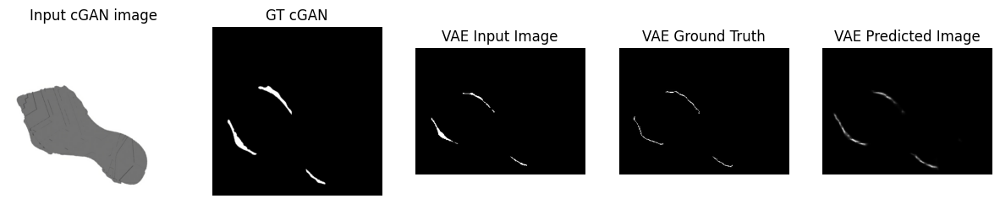

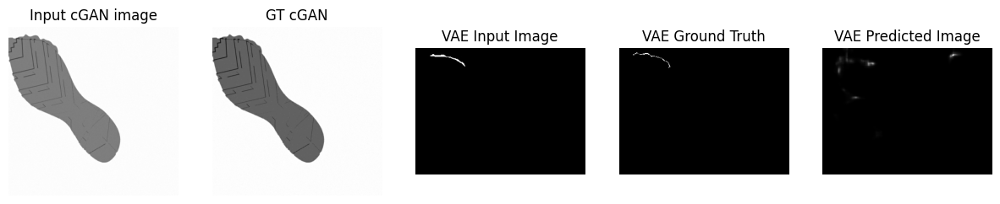

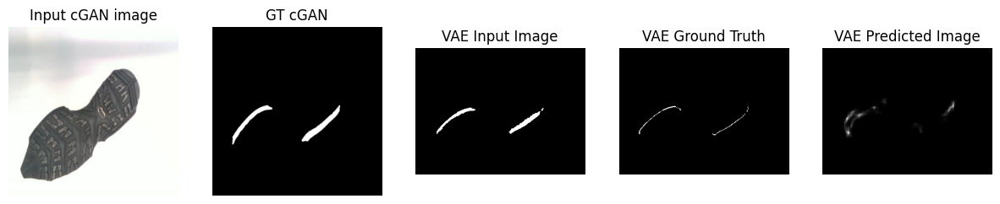

....................................................................................................Time taken for 1000 steps: 1704.69 sec

[Epochs-interval: 4/6]__Step: 79k/123k
Train set ELBO: 559.7998046875
Train set MMD loss: 3227.018798828125
Train set GRADIENT loss: 619383.375


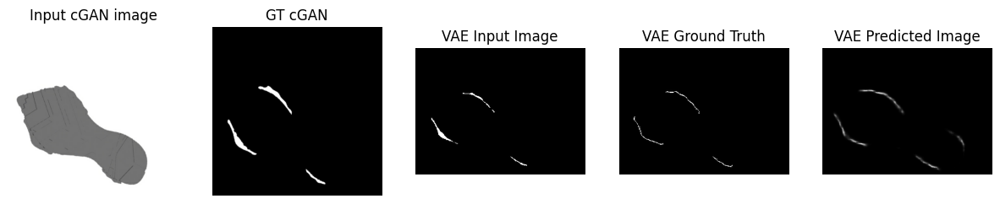

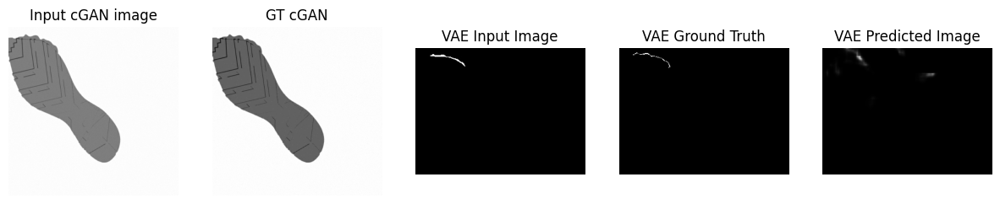

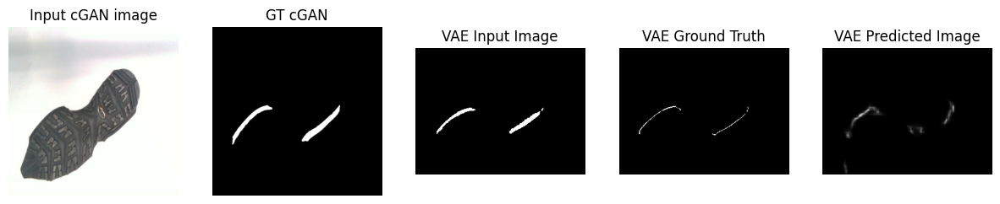

....................................................................................................Time taken for 1000 steps: 1726.76 sec

[Epochs-interval: 4/6]__Step: 80k/123k
Train set ELBO: 238.22659301757812
Train set MMD loss: 2950.28662109375
Train set GRADIENT loss: 393998.28125


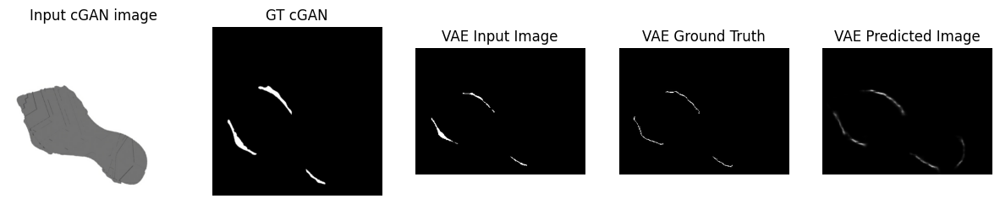

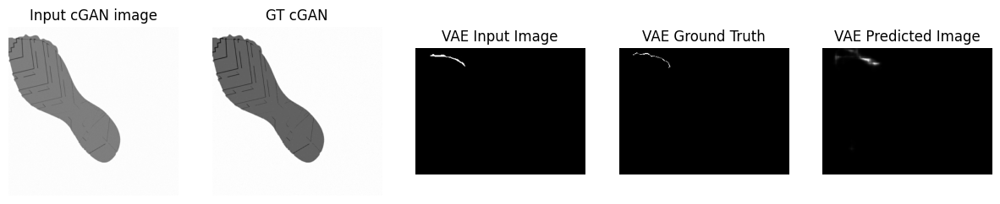

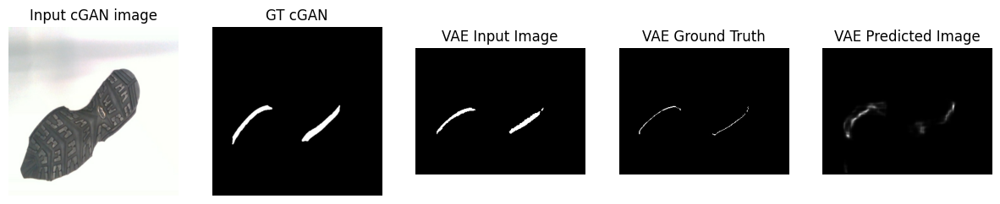

....................................................................................................Time taken for 1000 steps: 1748.85 sec

[Epochs-interval: 4/6]__Step: 81k/123k
Train set ELBO: 845.2174072265625
Train set MMD loss: 4586.0703125
Train set GRADIENT loss: 833853.125


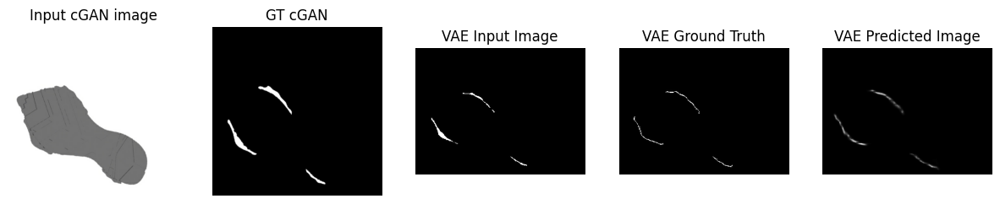

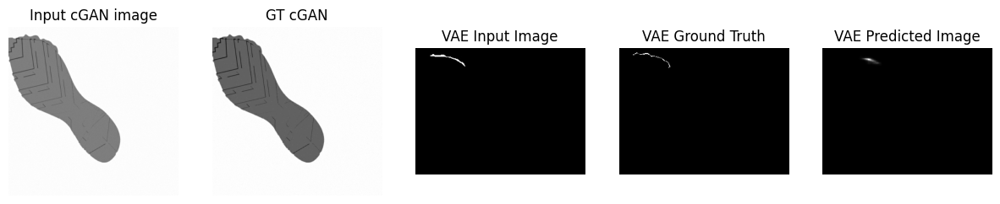

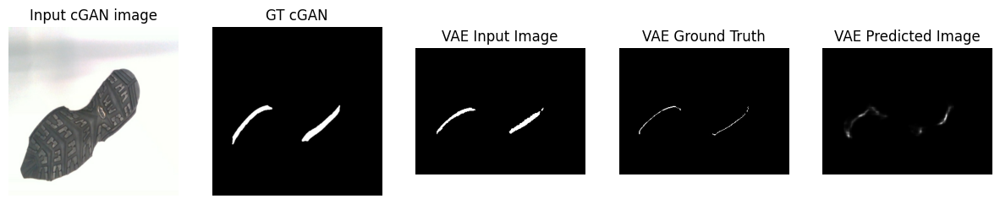

....................................................................................................Time taken for 1000 steps: 1771.25 sec

[Epochs-interval: 5/6]__Step: 82k/123k
Train set ELBO: 782.661376953125
Train set MMD loss: 3345.695556640625
Train set GRADIENT loss: 545226.875


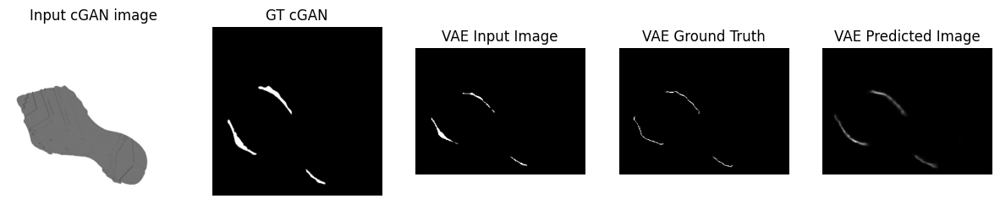

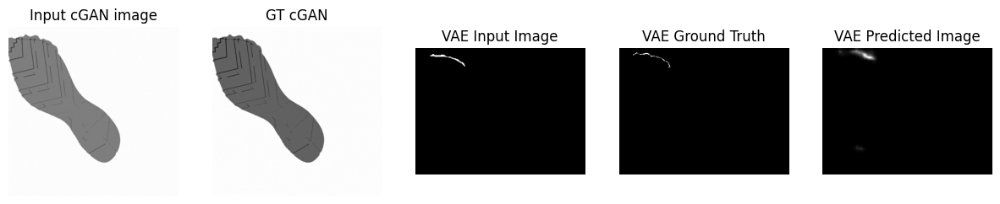

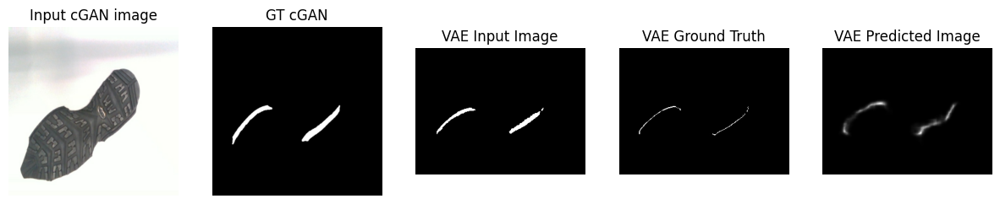

....................................................................................................Time taken for 1000 steps: 1793.87 sec

[Epochs-interval: 5/6]__Step: 83k/123k
Train set ELBO: 786.5715942382812
Train set MMD loss: 3627.96240234375
Train set GRADIENT loss: 869043.1875


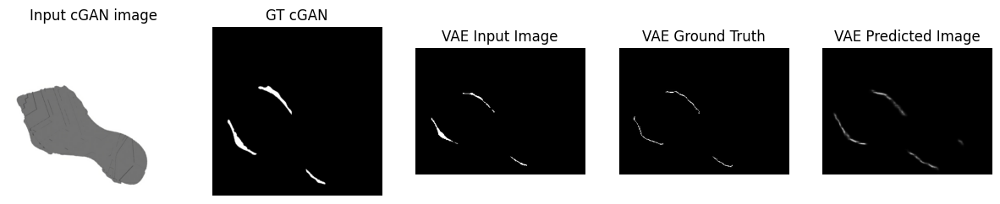

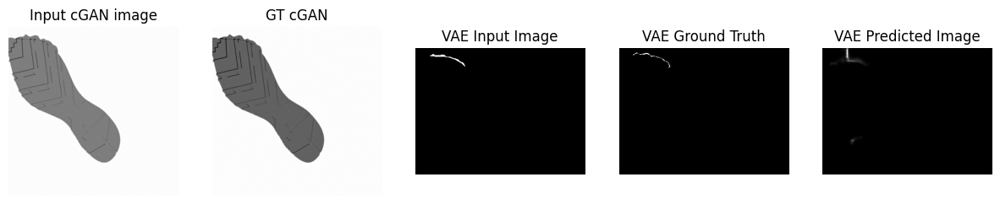

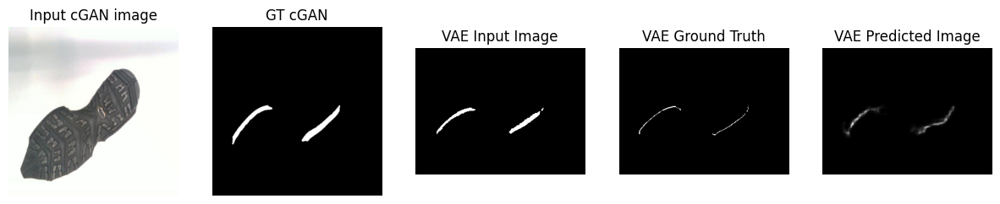

....................................................................................................Time taken for 1000 steps: 1816.35 sec

[Epochs-interval: 5/6]__Step: 84k/123k
Train set ELBO: 434.0345458984375
Train set MMD loss: 4406.2744140625
Train set GRADIENT loss: 419042.0625


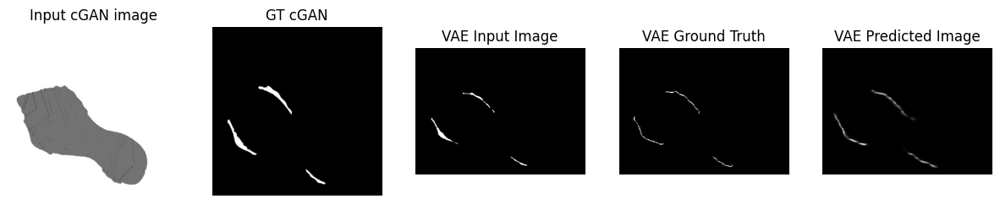

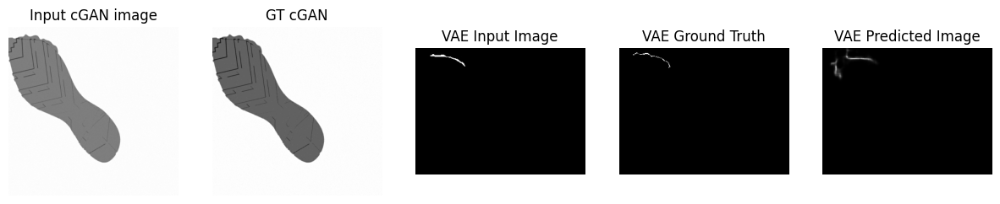

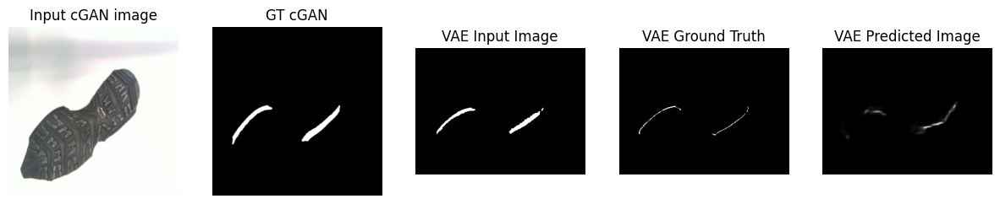

....................................................................................................Time taken for 1000 steps: 1838.41 sec

[Epochs-interval: 5/6]__Step: 85k/123k
Train set ELBO: 637.7579345703125
Train set MMD loss: 3742.834228515625
Train set GRADIENT loss: 579868.25


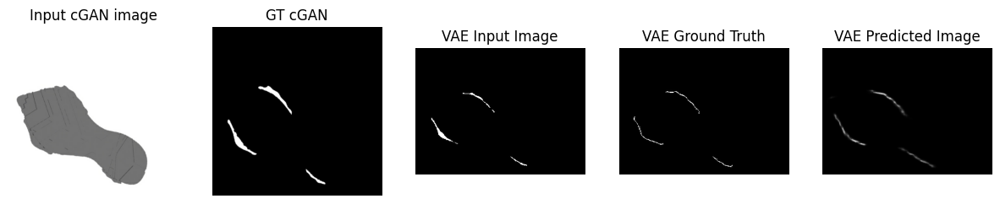

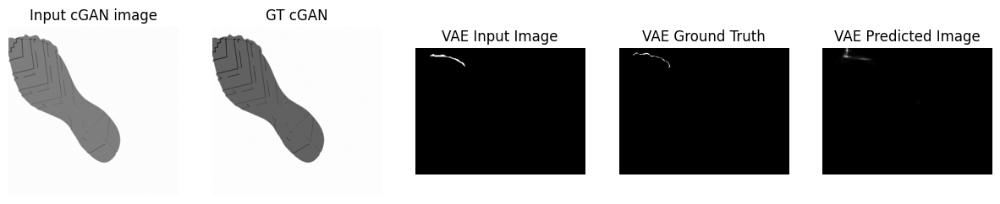

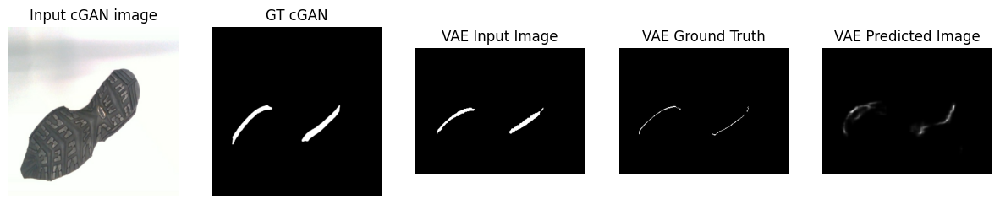

....................................................................................................Time taken for 1000 steps: 1860.92 sec

[Epochs-interval: 5/6]__Step: 86k/123k
Train set ELBO: 160.94302368164062
Train set MMD loss: 4111.7861328125
Train set GRADIENT loss: 463774.3125


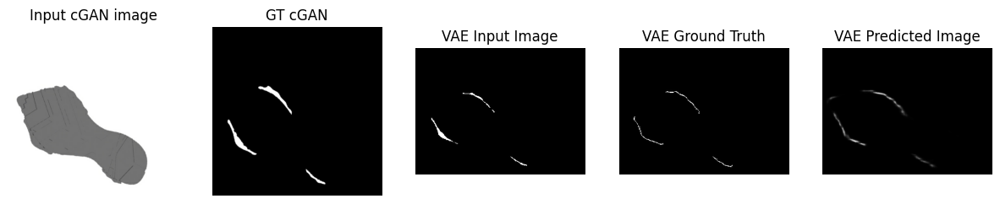

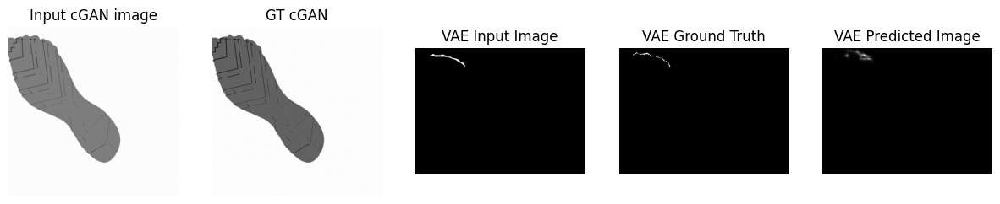

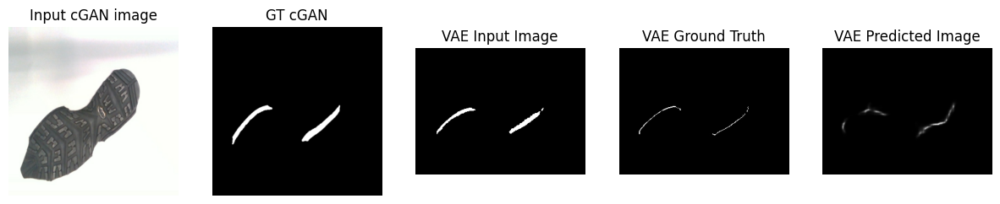

....................................................................................................Time taken for 1000 steps: 1883.52 sec

[Epochs-interval: 5/6]__Step: 87k/123k
Train set ELBO: 430.85955810546875
Train set MMD loss: 4322.40673828125
Train set GRADIENT loss: 652846.875


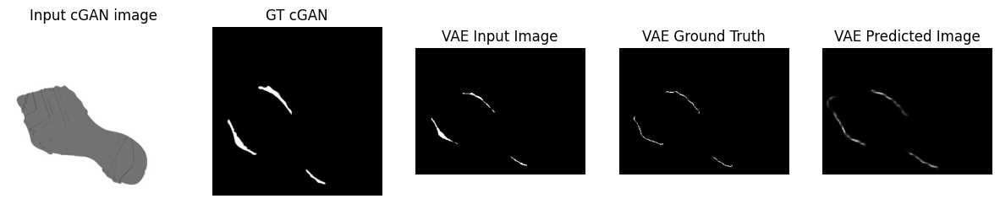

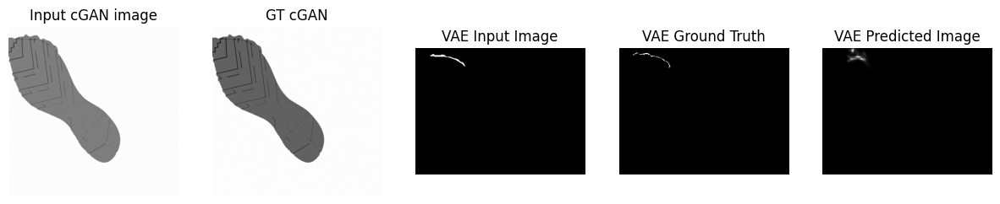

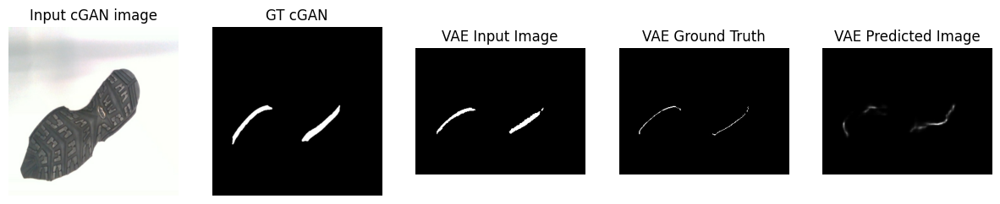

....................................................................................................Time taken for 1000 steps: 1906.04 sec

[Epochs-interval: 5/6]__Step: 88k/123k
Train set ELBO: 519.065185546875
Train set MMD loss: 3008.885009765625
Train set GRADIENT loss: 534224.125


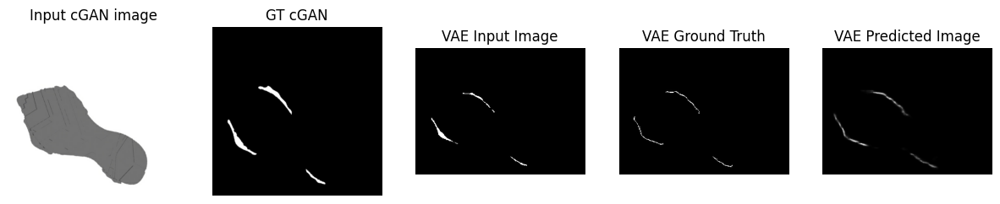

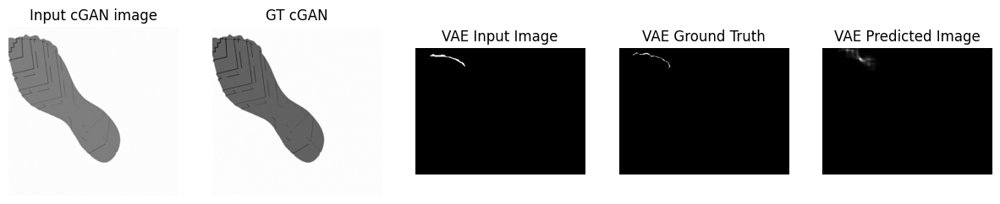

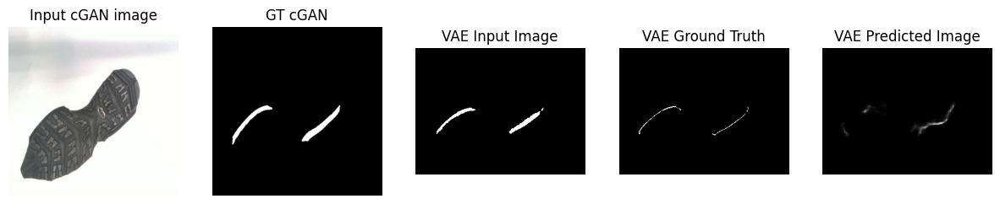

....................................................................................................Time taken for 1000 steps: 1928.50 sec

[Epochs-interval: 5/6]__Step: 89k/123k
Train set ELBO: 379.114990234375
Train set MMD loss: 4195.09375
Train set GRADIENT loss: 617243.9375


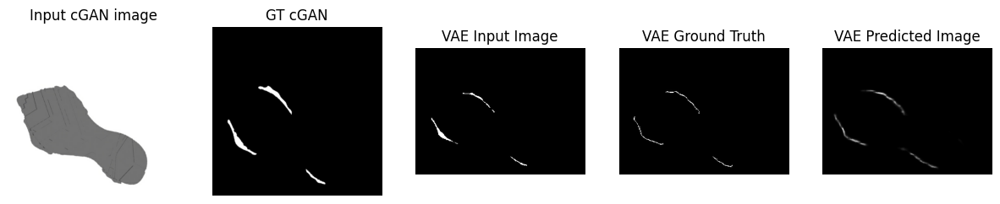

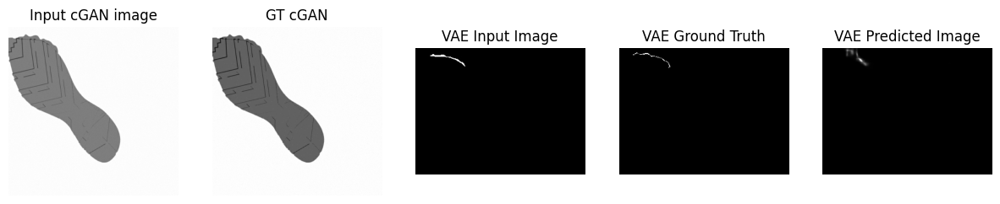

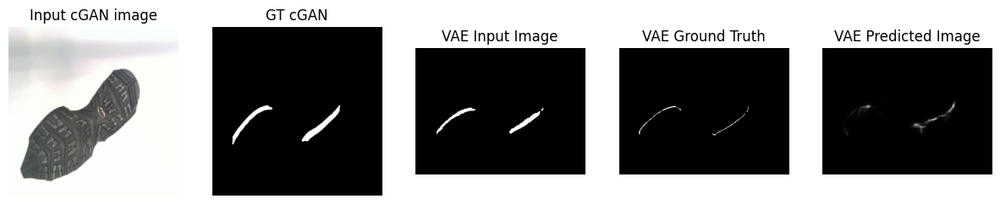

....................................................................................................Time taken for 1000 steps: 1950.63 sec

[Epochs-interval: 5/6]__Step: 90k/123k
Train set ELBO: 5.959285736083984
Train set MMD loss: 3617.984375
Train set GRADIENT loss: 422040.75


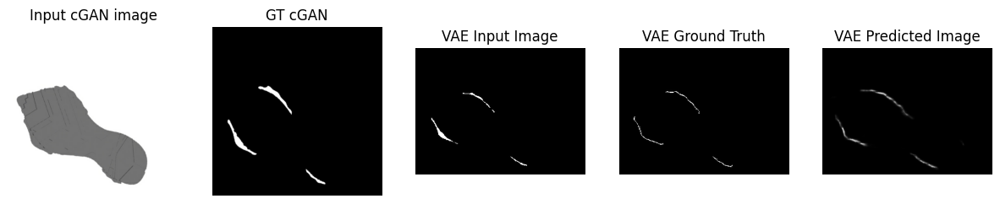

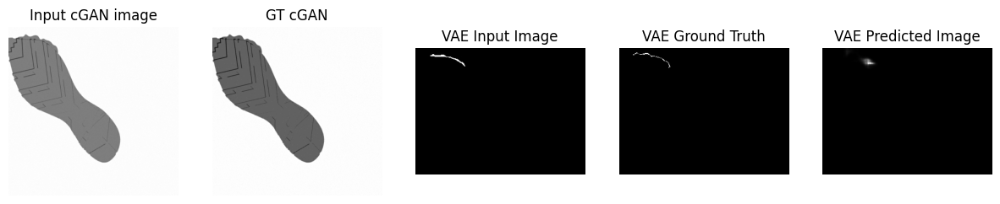

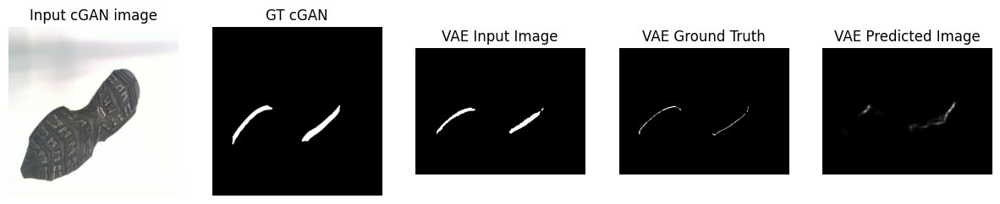

....................................................................................................Time taken for 1000 steps: 1973.30 sec

[Epochs-interval: 5/6]__Step: 91k/123k
Train set ELBO: 248.4205322265625
Train set MMD loss: 3862.9609375
Train set GRADIENT loss: 603282.375


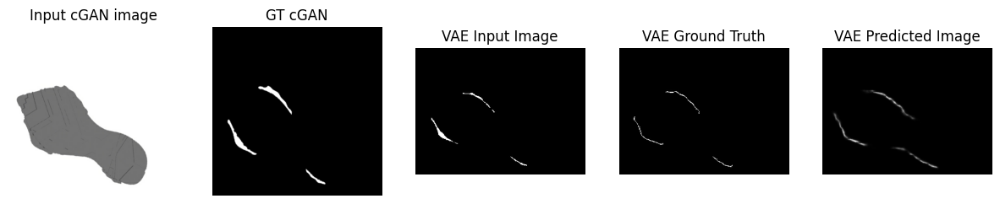

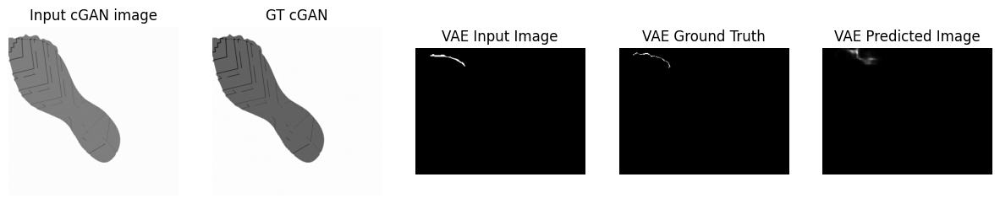

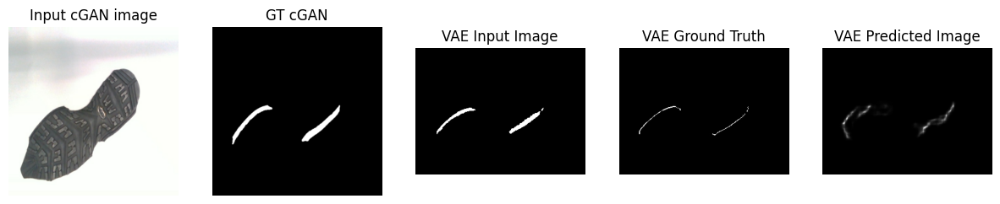

....................................................................................................Time taken for 1000 steps: 1995.29 sec

[Epochs-interval: 5/6]__Step: 92k/123k
Train set ELBO: 573.52001953125
Train set MMD loss: 3249.371826171875
Train set GRADIENT loss: 514395.65625


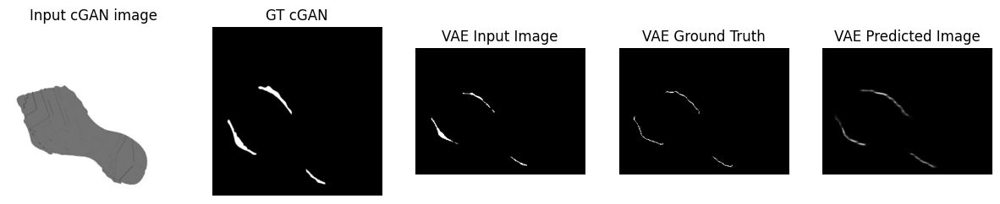

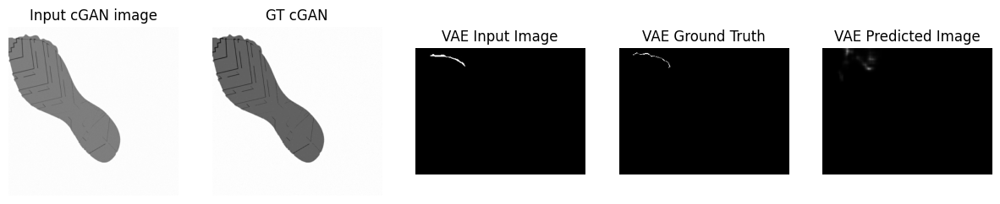

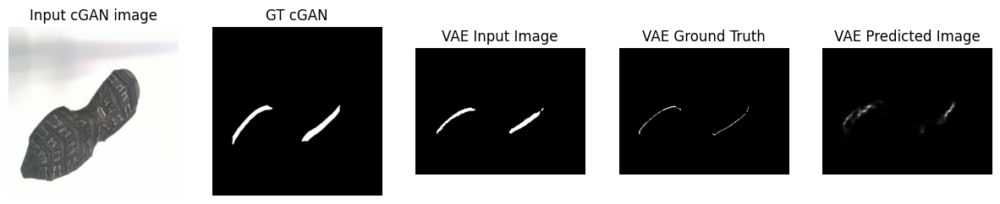

....................................................................................................Time taken for 1000 steps: 2017.42 sec

[Epochs-interval: 5/6]__Step: 93k/123k
Train set ELBO: 626.0364379882812
Train set MMD loss: 3393.635498046875
Train set GRADIENT loss: 694652.4375


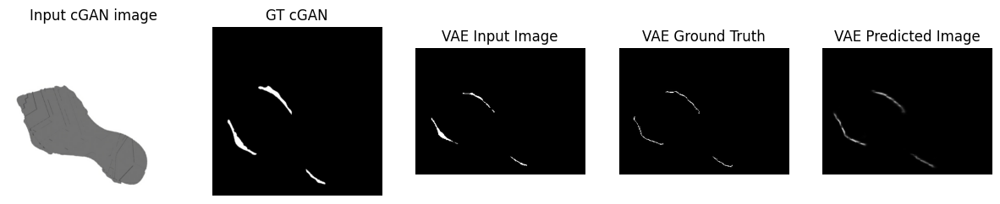

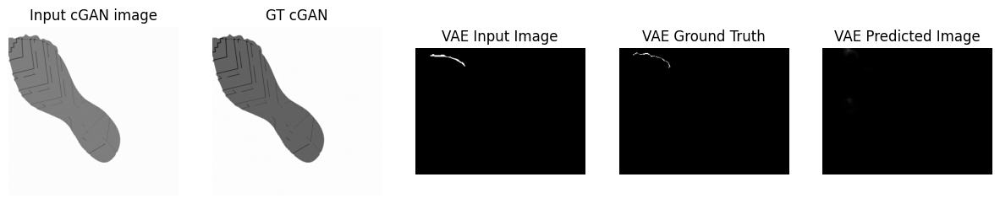

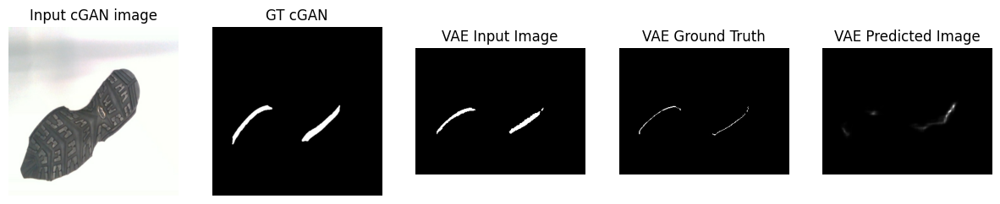

....................................................................................................Time taken for 1000 steps: 2039.25 sec

[Epochs-interval: 5/6]__Step: 94k/123k
Train set ELBO: 162.62893676757812
Train set MMD loss: 3265.788818359375
Train set GRADIENT loss: 435612.15625


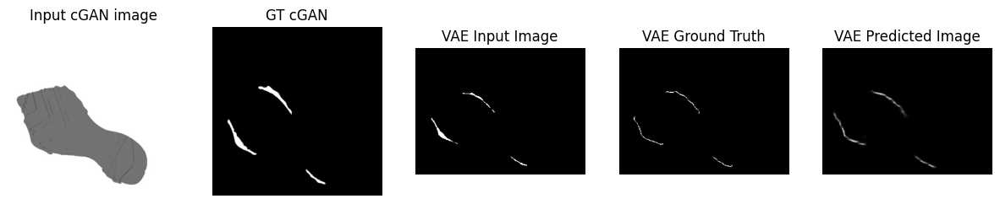

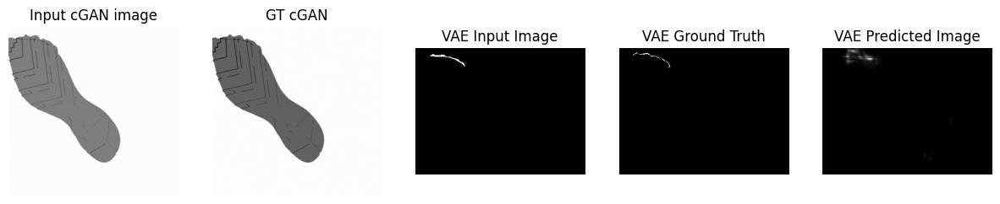

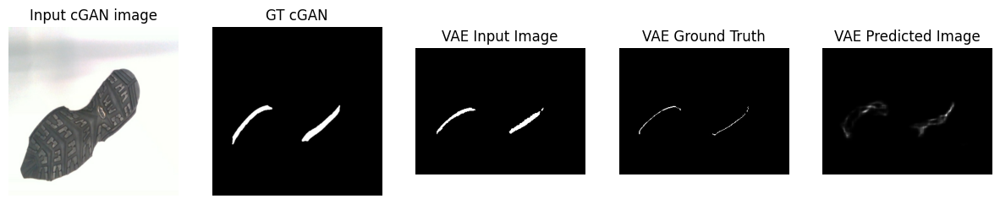

....................................................................................................Time taken for 1000 steps: 2061.71 sec

[Epochs-interval: 5/6]__Step: 95k/123k
Train set ELBO: 893.4243774414062
Train set MMD loss: 2987.535888671875
Train set GRADIENT loss: 683011.375


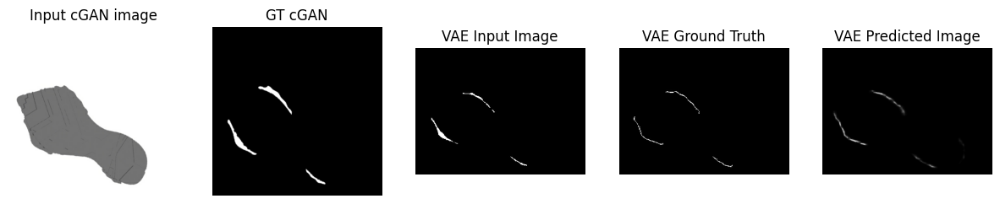

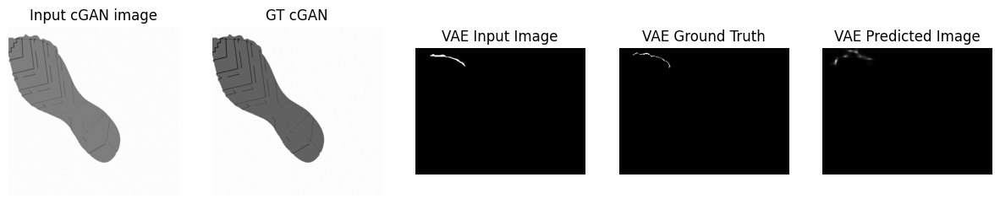

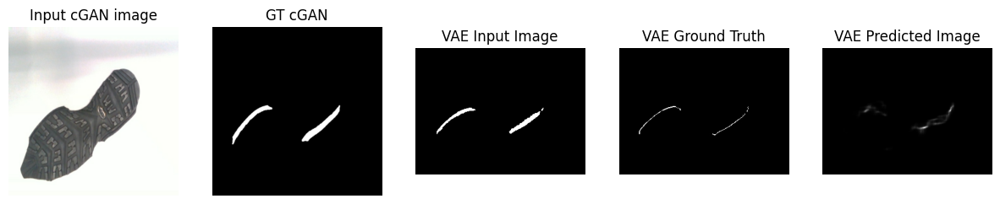

....................................................................................................Time taken for 1000 steps: 2083.46 sec

[Epochs-interval: 5/6]__Step: 96k/123k
Train set ELBO: 723.0108032226562
Train set MMD loss: 3378.120849609375
Train set GRADIENT loss: 629077.1875


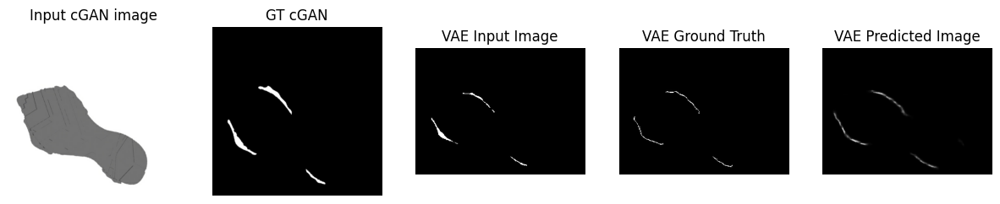

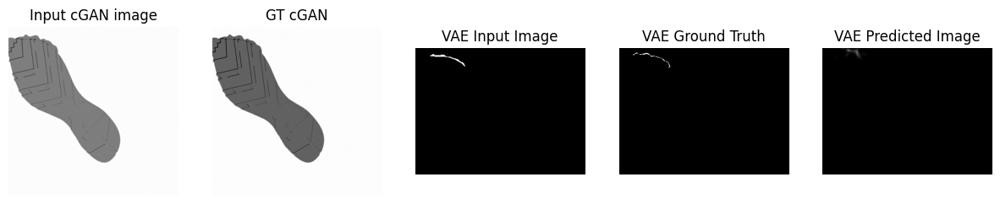

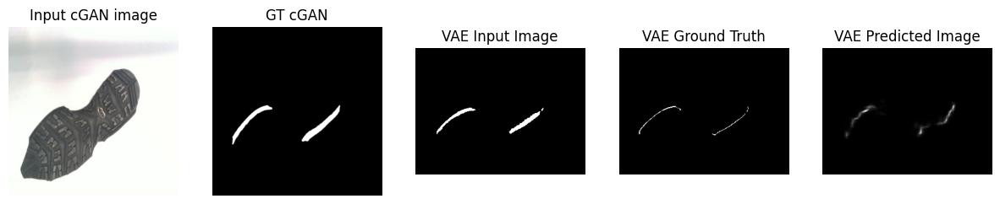

....................................................................................................Time taken for 1000 steps: 2105.78 sec

[Epochs-interval: 5/6]__Step: 97k/123k
Train set ELBO: 337.3133850097656
Train set MMD loss: 3635.664794921875
Train set GRADIENT loss: 572944.25


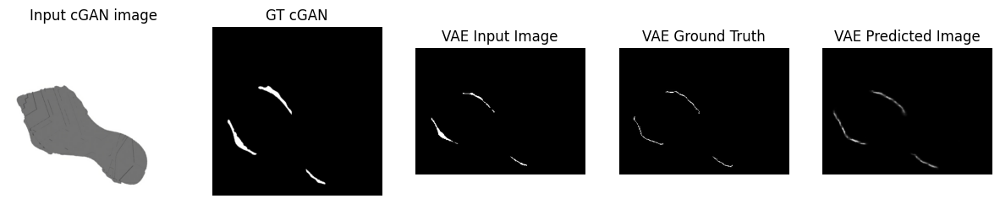

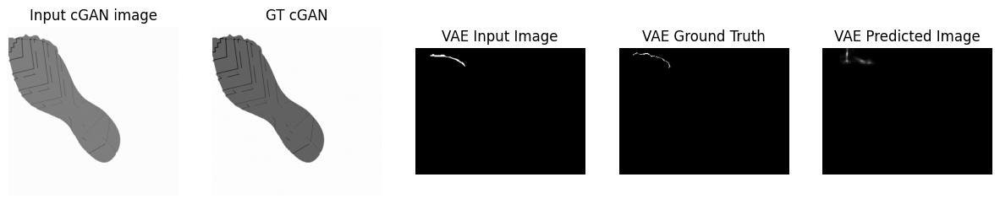

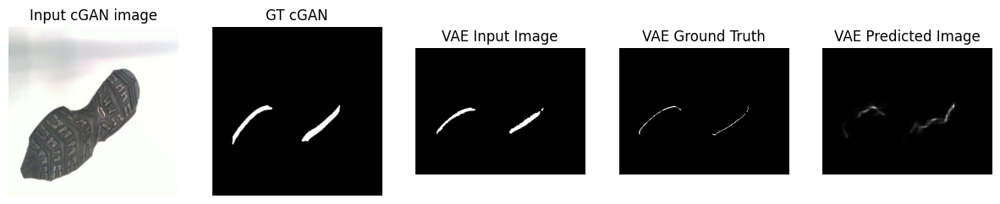

....................................................................................................Time taken for 1000 steps: 2127.58 sec

[Epochs-interval: 5/6]__Step: 98k/123k
Train set ELBO: 443.07928466796875
Train set MMD loss: 2785.714599609375
Train set GRADIENT loss: 481385.90625


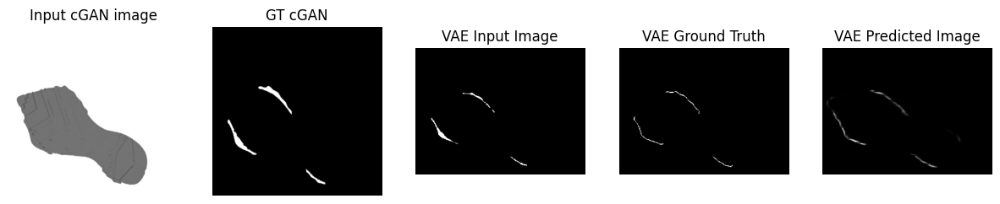

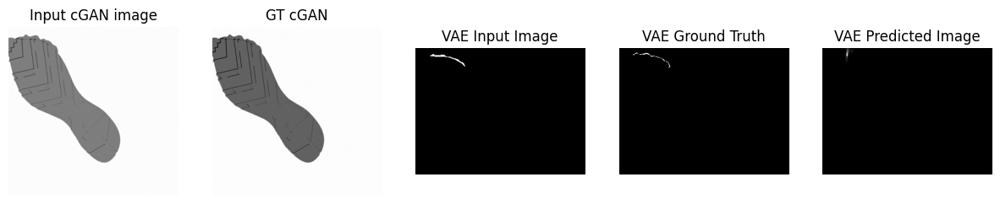

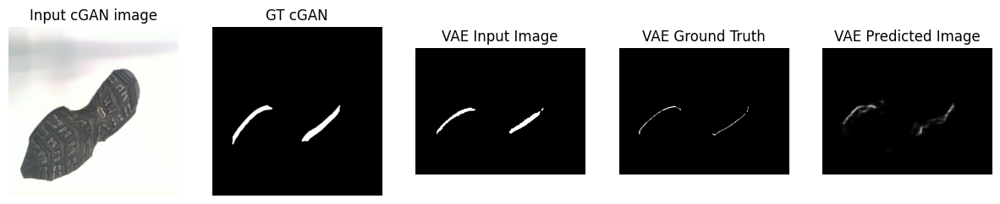

....................................................................................................Time taken for 1000 steps: 2150.26 sec

[Epochs-interval: 5/6]__Step: 99k/123k
Train set ELBO: 419.5494079589844
Train set MMD loss: 4294.98876953125
Train set GRADIENT loss: 421698.71875


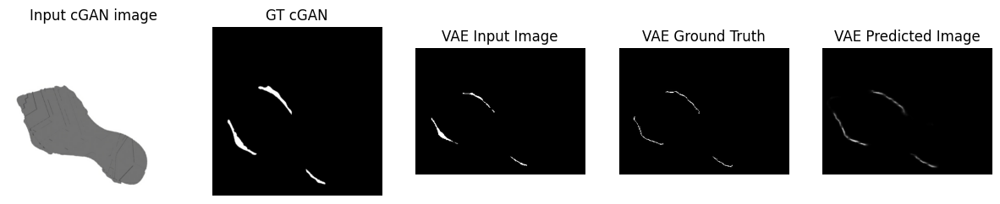

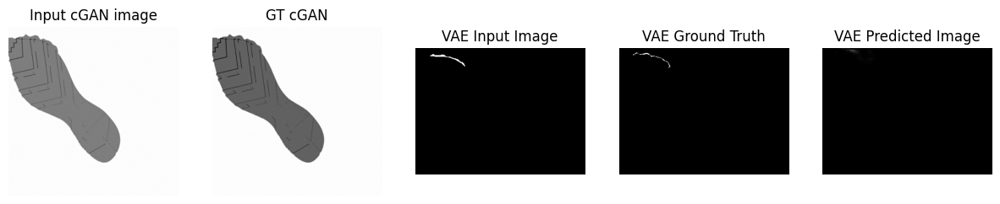

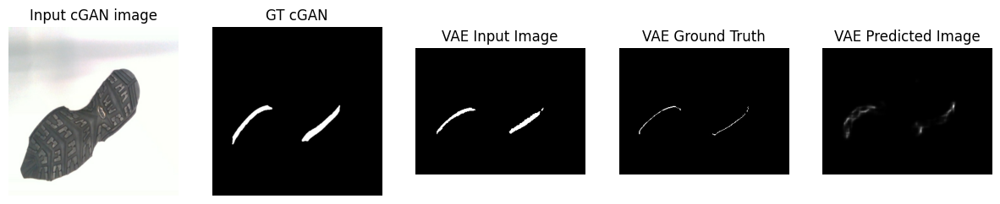

....................................................................................................Time taken for 1000 steps: 2172.20 sec

[Epochs-interval: 5/6]__Step: 100k/123k
Train set ELBO: 692.026611328125
Train set MMD loss: 3067.619140625
Train set GRADIENT loss: 602664.875


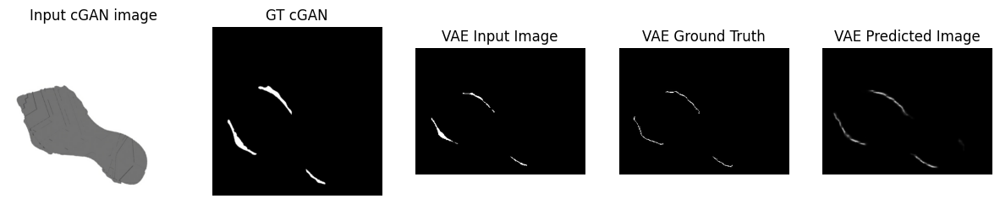

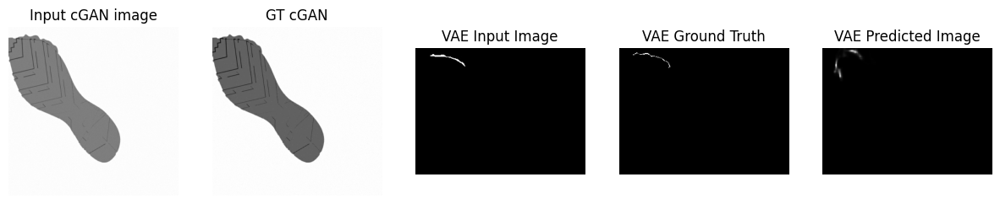

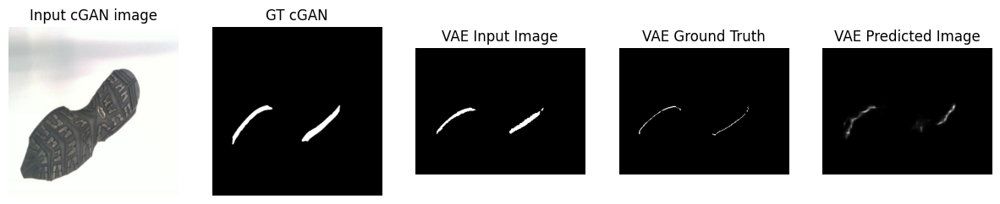

....................................................................................................Time taken for 1000 steps: 2194.04 sec

[Epochs-interval: 5/6]__Step: 101k/123k
Train set ELBO: 608.4095458984375
Train set MMD loss: 4177.29345703125
Train set GRADIENT loss: 566407.75


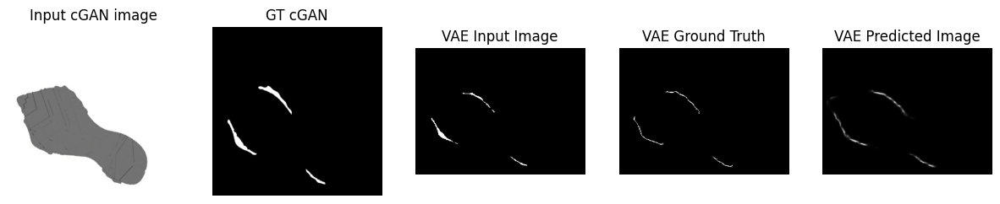

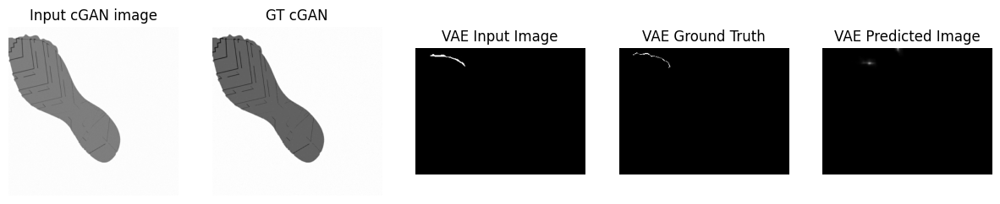

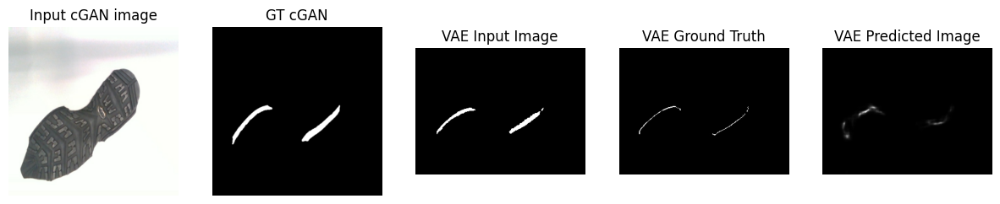

....................................................................................................Time taken for 1000 steps: 2215.94 sec

[Epochs-interval: 5/6]__Step: 102k/123k
Train set ELBO: 1524.713134765625
Train set MMD loss: 3934.966552734375
Train set GRADIENT loss: 565333.0625


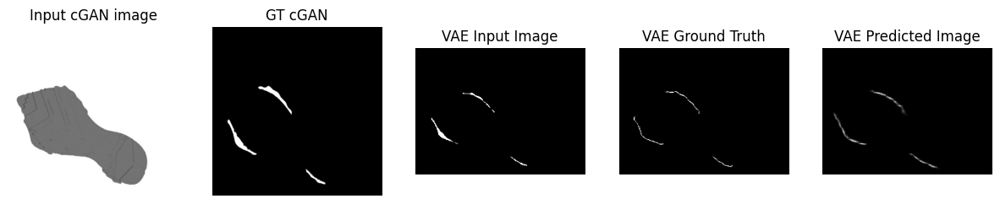

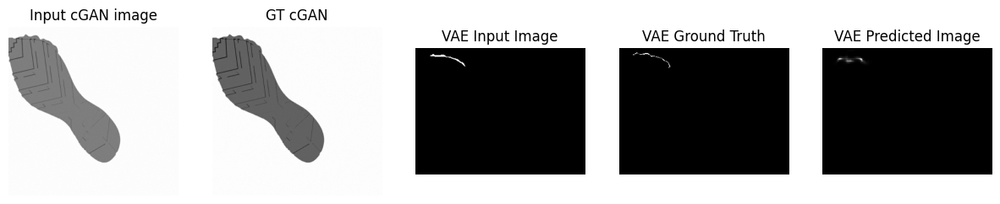

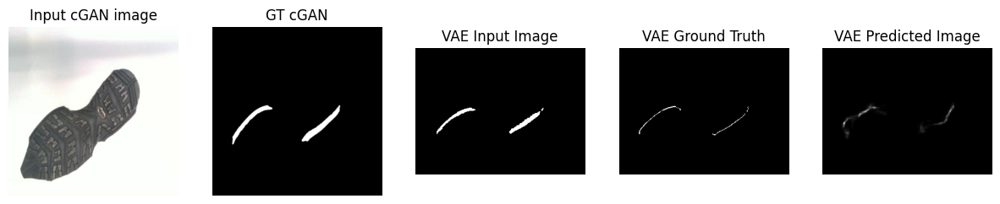

....................................................................................................Time taken for 1000 steps: 2238.26 sec

[Epochs-interval: 6/6]__Step: 103k/123k
Train set ELBO: 50.21106719970703
Train set MMD loss: 4055.5986328125
Train set GRADIENT loss: 543405.0


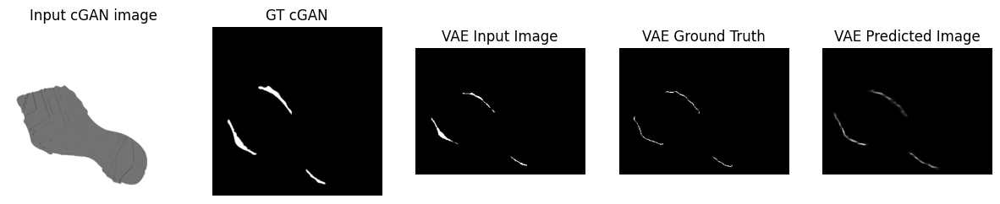

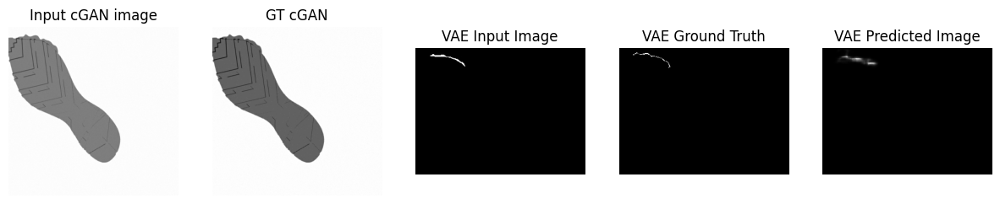

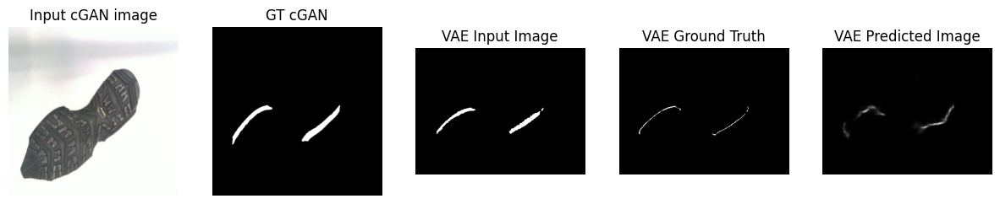

....................................................................................................Time taken for 1000 steps: 2260.61 sec

[Epochs-interval: 6/6]__Step: 104k/123k
Train set ELBO: 503.26800537109375
Train set MMD loss: 4108.59814453125
Train set GRADIENT loss: 663216.5625


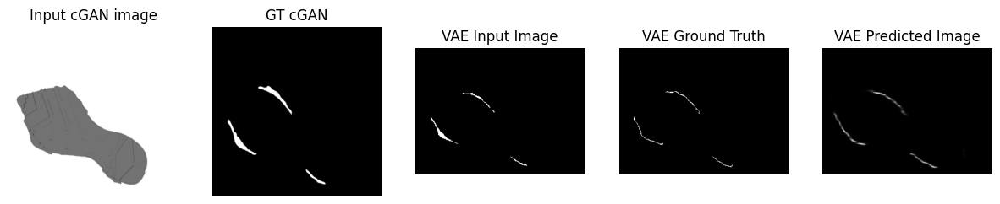

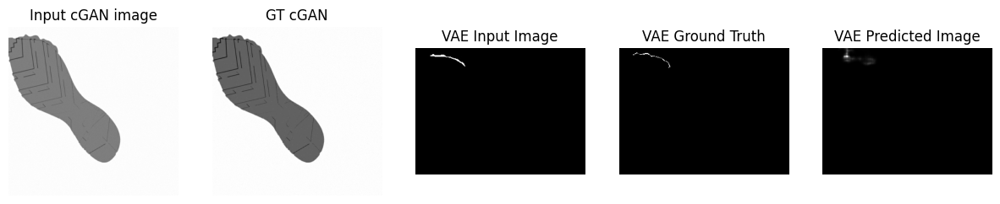

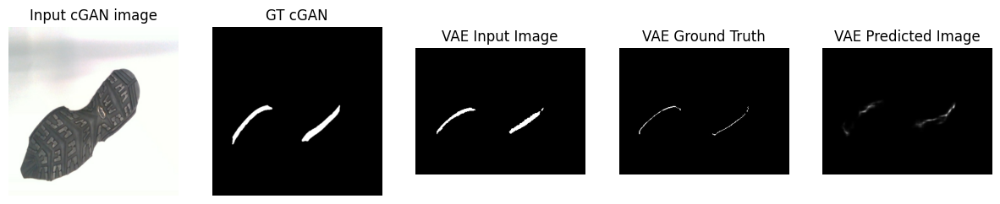

....................................................................................................Time taken for 1000 steps: 2282.52 sec

[Epochs-interval: 6/6]__Step: 105k/123k
Train set ELBO: 12.06790542602539
Train set MMD loss: 3608.48876953125
Train set GRADIENT loss: 294600.59375


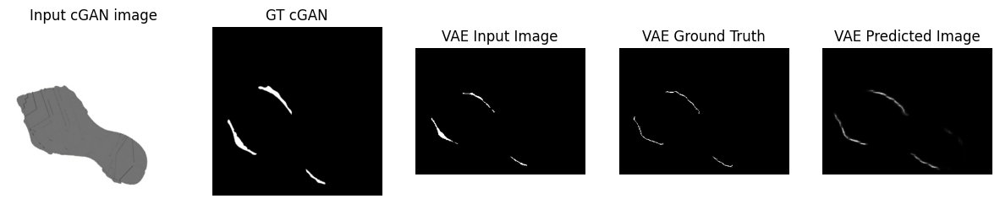

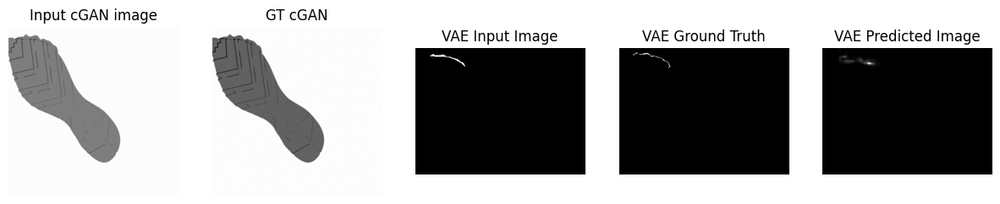

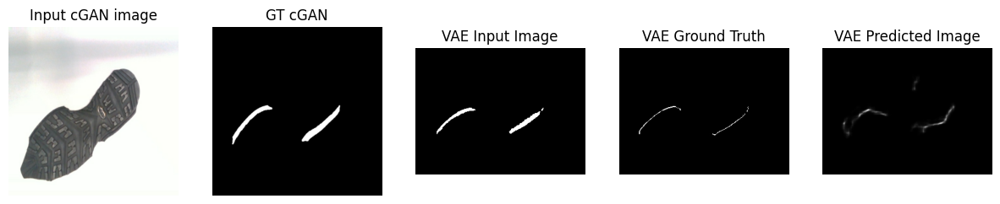

....................................................................................................Time taken for 1000 steps: 2305.14 sec

[Epochs-interval: 6/6]__Step: 106k/123k
Train set ELBO: 385.626708984375
Train set MMD loss: 3763.770751953125
Train set GRADIENT loss: 576412.1875


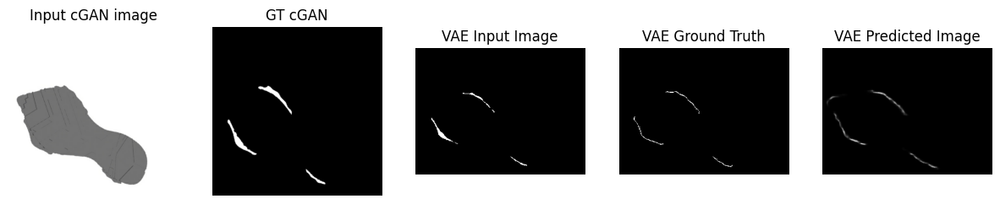

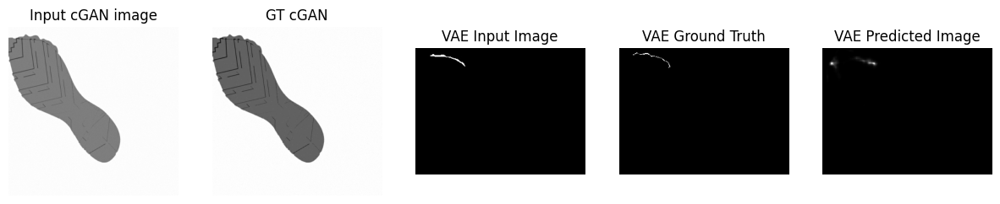

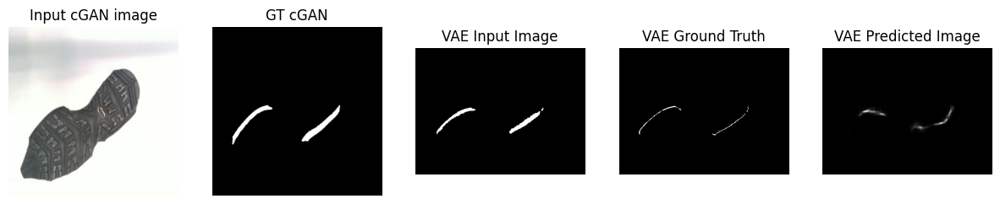

....................................................................................................Time taken for 1000 steps: 2327.22 sec

[Epochs-interval: 6/6]__Step: 107k/123k
Train set ELBO: 10.047916412353516
Train set MMD loss: 4222.60302734375
Train set GRADIENT loss: 402660.5625


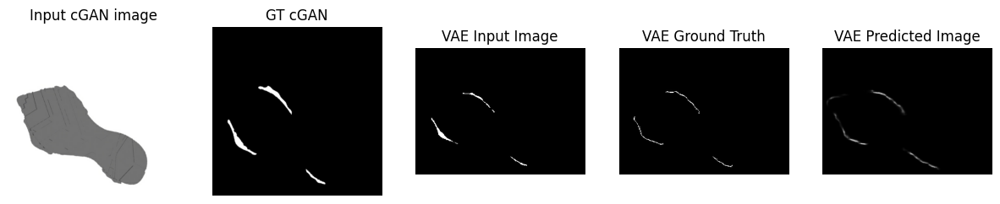

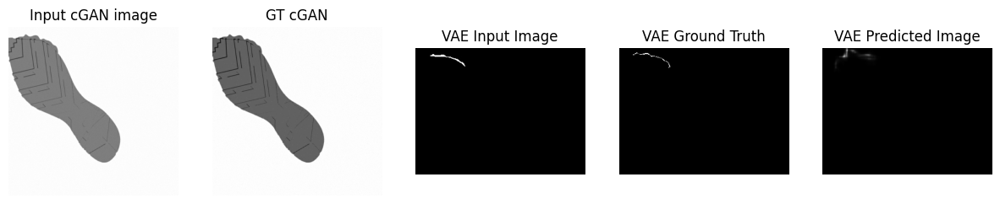

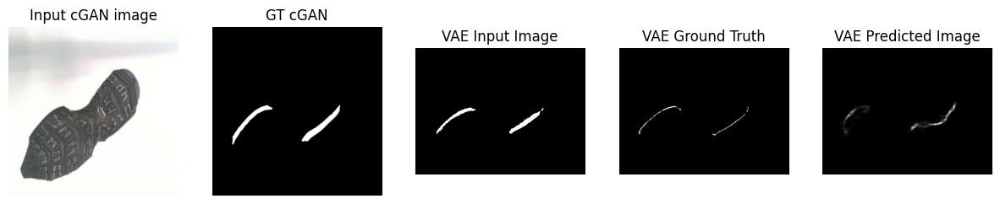

....................................................................................................Time taken for 1000 steps: 2349.60 sec

[Epochs-interval: 6/6]__Step: 108k/123k
Train set ELBO: 154.3461151123047
Train set MMD loss: 3768.85791015625
Train set GRADIENT loss: 379934.0625


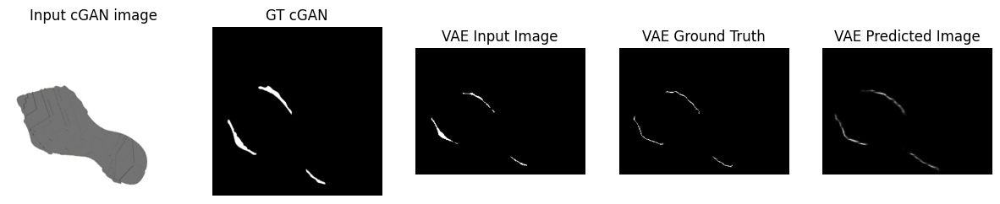

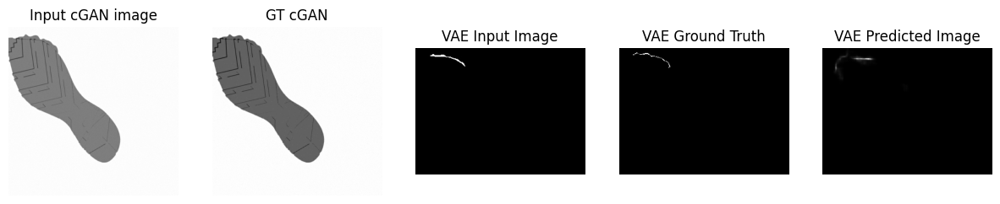

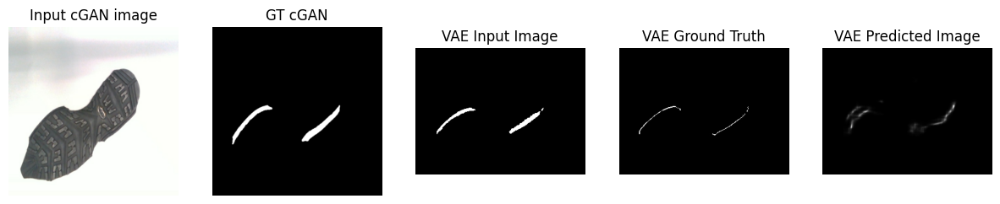

....................................................................................................Time taken for 1000 steps: 2371.50 sec

[Epochs-interval: 6/6]__Step: 109k/123k
Train set ELBO: 711.8294067382812
Train set MMD loss: 3607.100830078125
Train set GRADIENT loss: 733275.6875


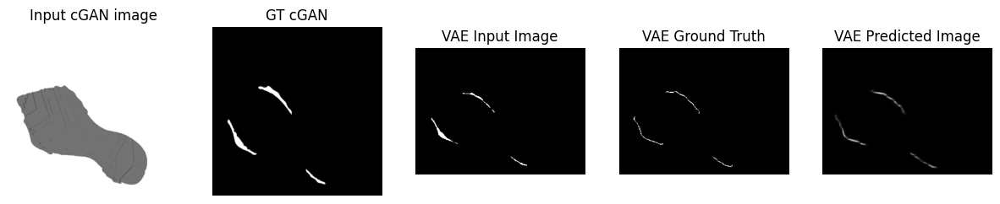

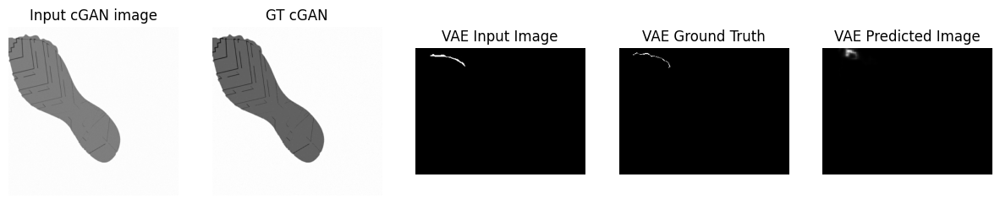

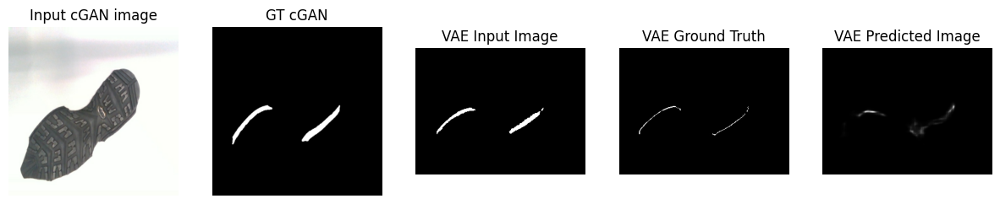

....................................................................................................Time taken for 1000 steps: 2393.75 sec

[Epochs-interval: 6/6]__Step: 110k/123k
Train set ELBO: 606.2833251953125
Train set MMD loss: 5274.92919921875
Train set GRADIENT loss: 598984.125


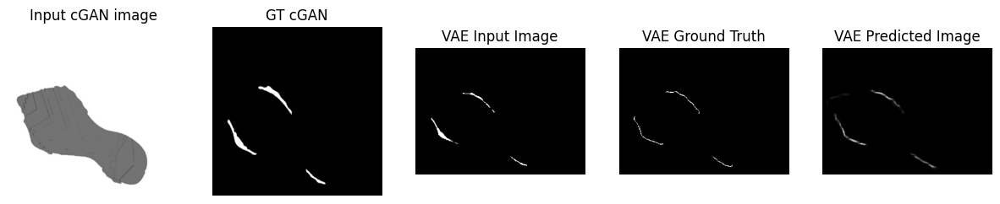

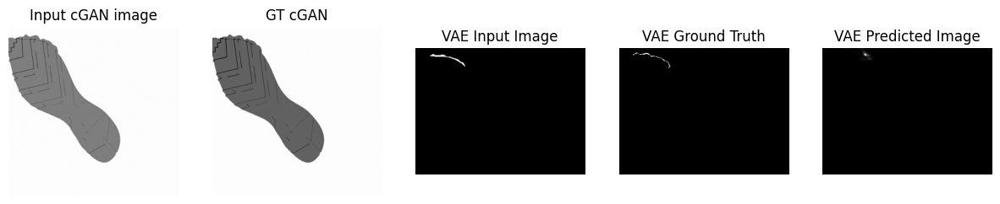

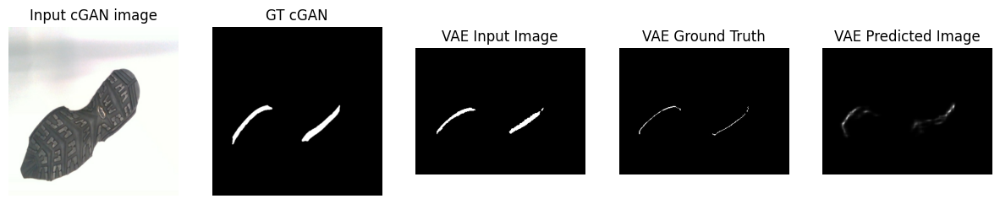

....................................................................................................Time taken for 1000 steps: 2415.92 sec

[Epochs-interval: 6/6]__Step: 111k/123k
Train set ELBO: 987.9382934570312
Train set MMD loss: 3765.29833984375
Train set GRADIENT loss: 627432.5625


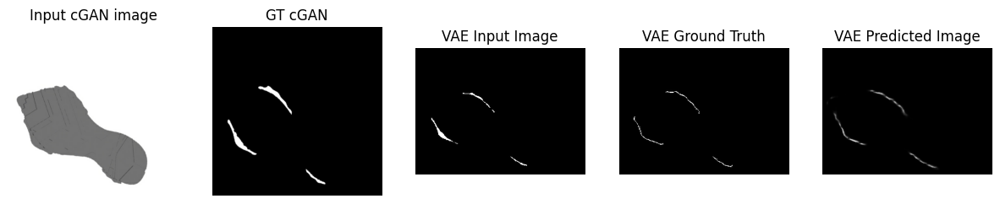

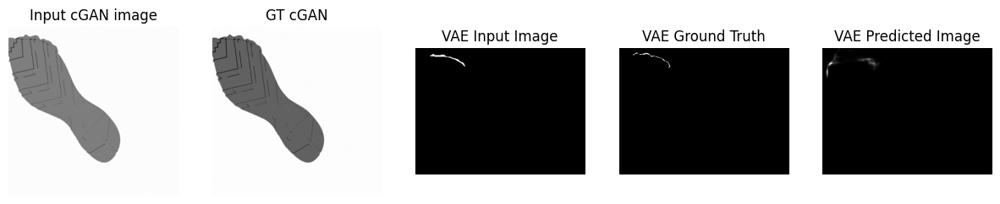

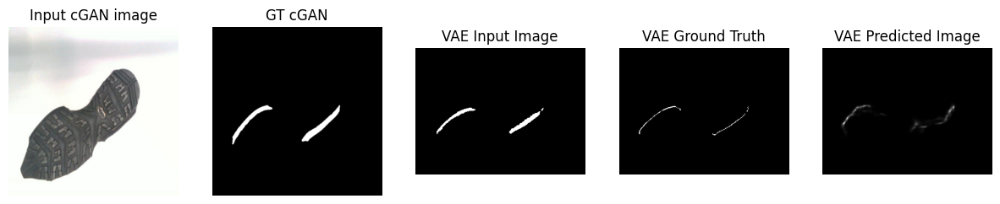

....................................................................................................Time taken for 1000 steps: 2437.58 sec

[Epochs-interval: 6/6]__Step: 112k/123k
Train set ELBO: 206.38055419921875
Train set MMD loss: 3803.052978515625
Train set GRADIENT loss: 382661.125


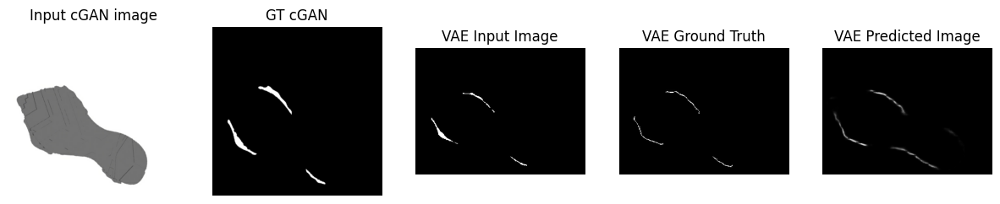

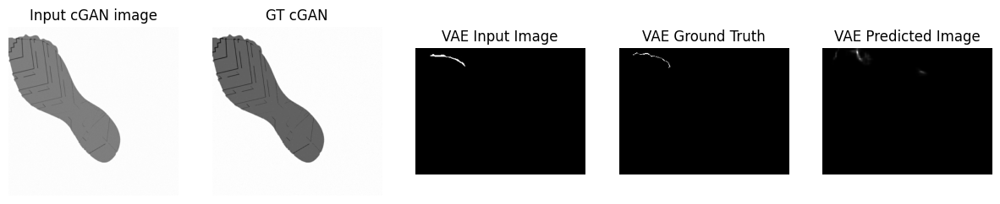

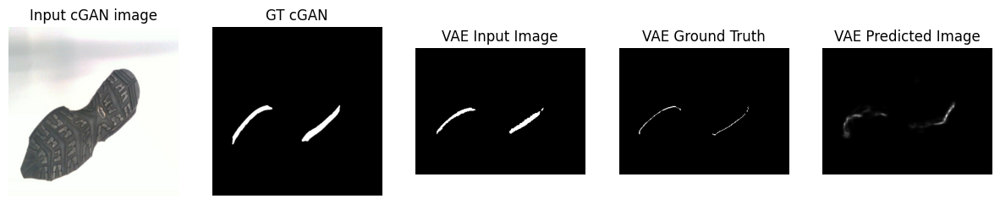

....................................................................................................Time taken for 1000 steps: 2459.95 sec

[Epochs-interval: 6/6]__Step: 113k/123k
Train set ELBO: 921.3767700195312
Train set MMD loss: 3977.364501953125
Train set GRADIENT loss: 583420.75


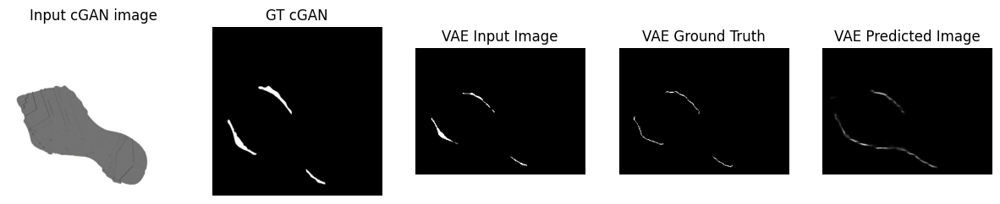

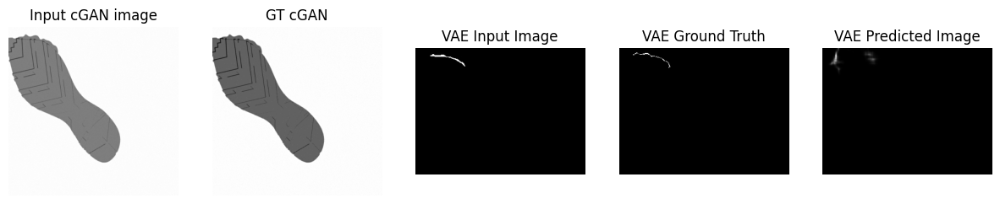

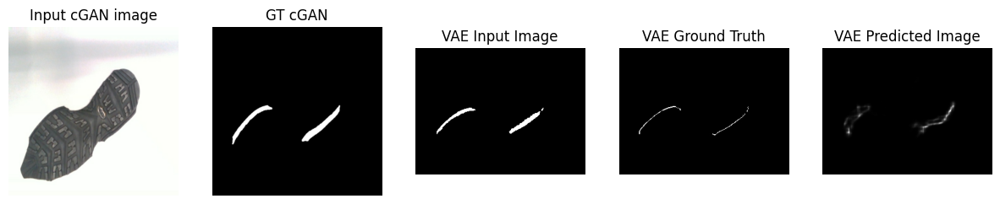

....................................................................................................Time taken for 1000 steps: 2482.40 sec

[Epochs-interval: 6/6]__Step: 114k/123k
Train set ELBO: 426.9985046386719
Train set MMD loss: 4474.689453125
Train set GRADIENT loss: 601896.625


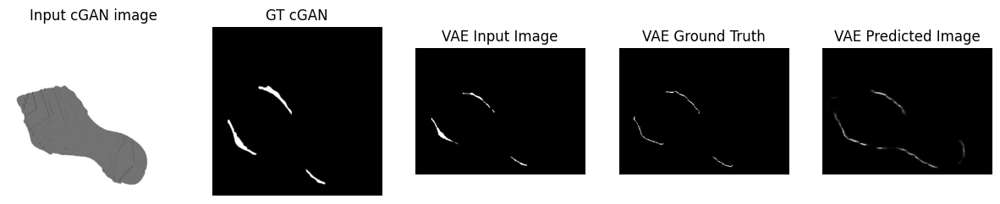

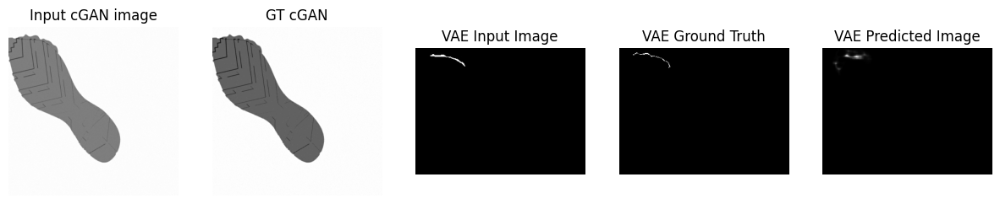

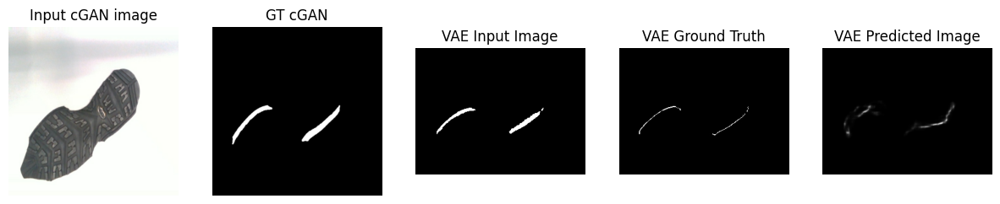

....................................................................................................Time taken for 1000 steps: 2504.94 sec

[Epochs-interval: 6/6]__Step: 115k/123k
Train set ELBO: 2.8424720764160156
Train set MMD loss: 3988.873291015625
Train set GRADIENT loss: 375310.71875


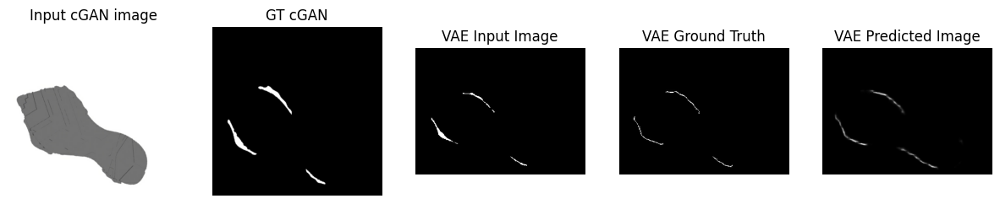

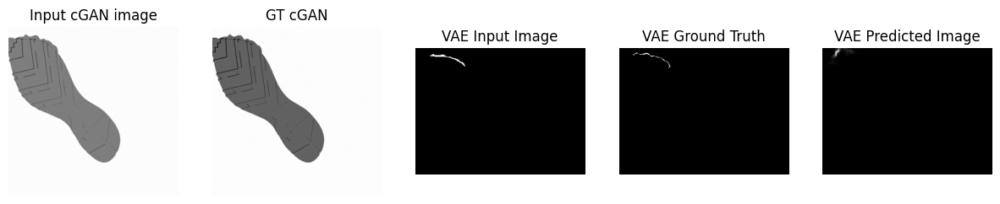

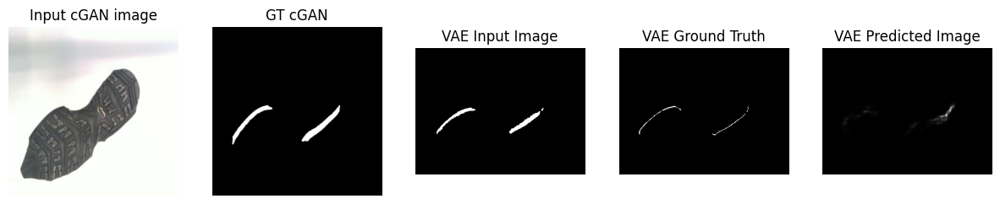

....................................................................................................Time taken for 1000 steps: 2527.05 sec

[Epochs-interval: 6/6]__Step: 116k/123k
Train set ELBO: 695.1295166015625
Train set MMD loss: 4703.2763671875
Train set GRADIENT loss: 695246.25


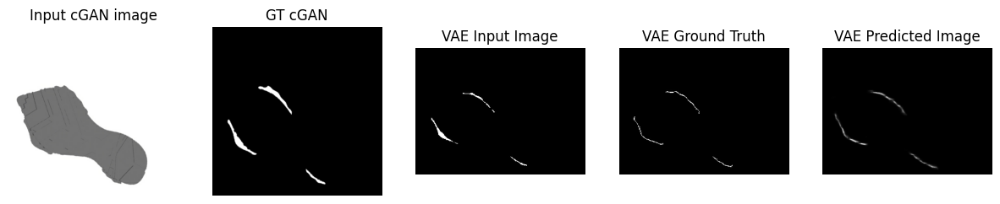

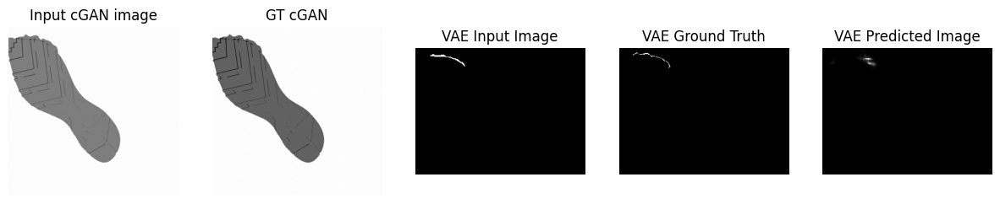

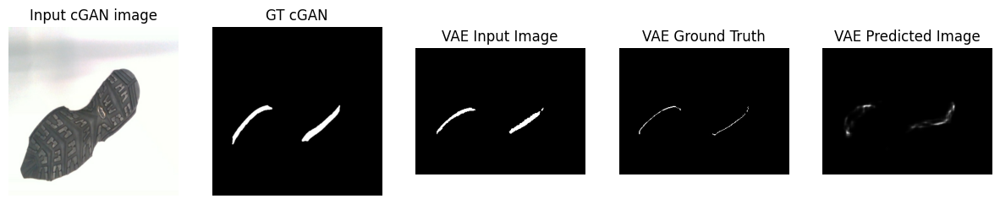

....................................................................................................Time taken for 1000 steps: 2549.67 sec

[Epochs-interval: 6/6]__Step: 117k/123k
Train set ELBO: 5.685832977294922
Train set MMD loss: 3783.10888671875
Train set GRADIENT loss: 401804.6875


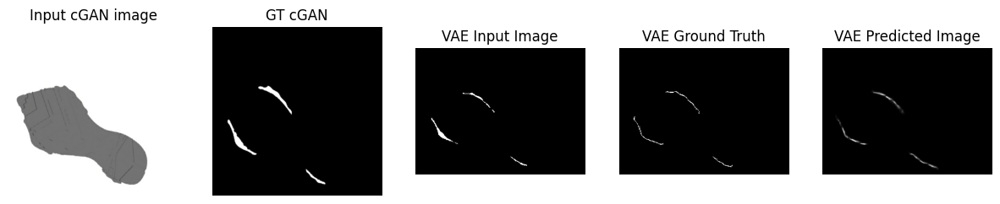

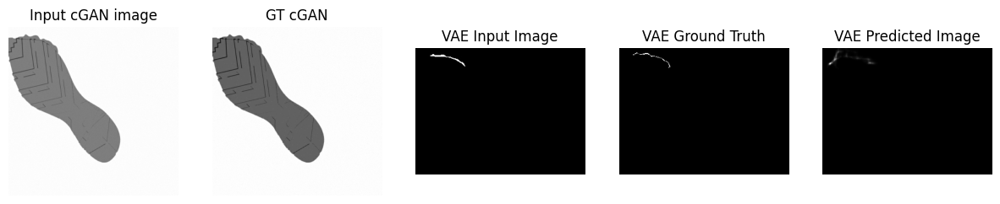

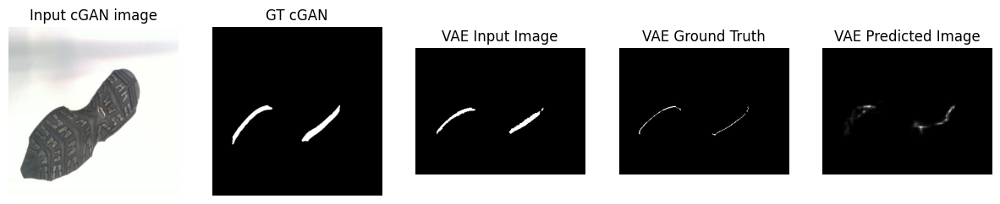

....................................................................................................Time taken for 1000 steps: 2572.12 sec

[Epochs-interval: 6/6]__Step: 118k/123k
Train set ELBO: 186.97842407226562
Train set MMD loss: 4050.380859375
Train set GRADIENT loss: 394551.4375


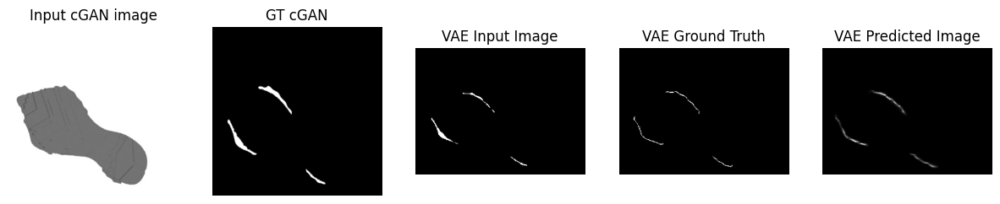

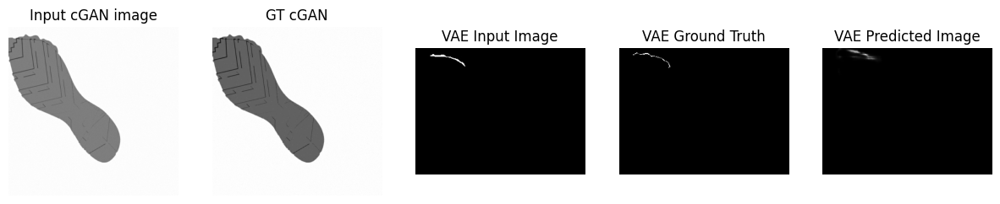

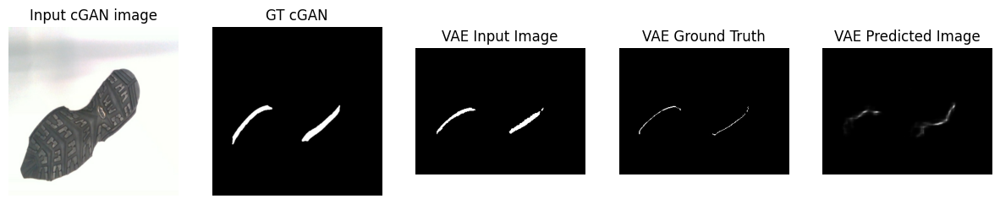

....................................................................................................Time taken for 1000 steps: 2594.55 sec

[Epochs-interval: 6/6]__Step: 119k/123k
Train set ELBO: 260.73028564453125
Train set MMD loss: 3380.517333984375
Train set GRADIENT loss: 391052.9375


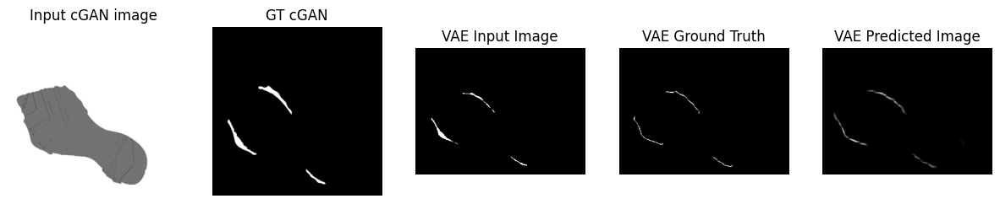

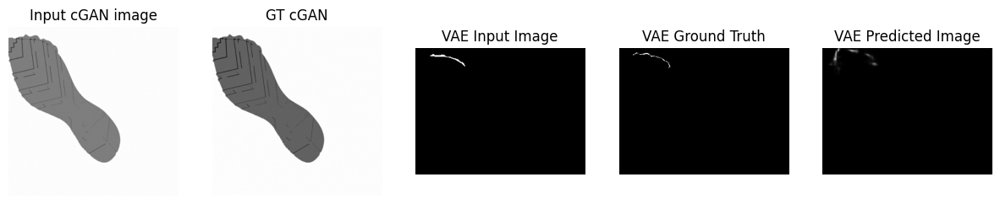

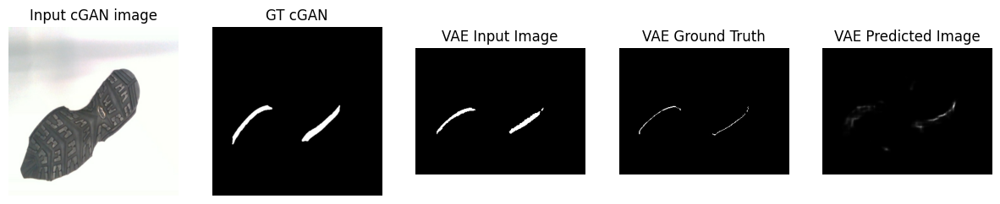

....................................................................................................Time taken for 1000 steps: 2616.61 sec

[Epochs-interval: 6/6]__Step: 120k/123k
Train set ELBO: 441.190673828125
Train set MMD loss: 3988.323486328125
Train set GRADIENT loss: 619266.1875


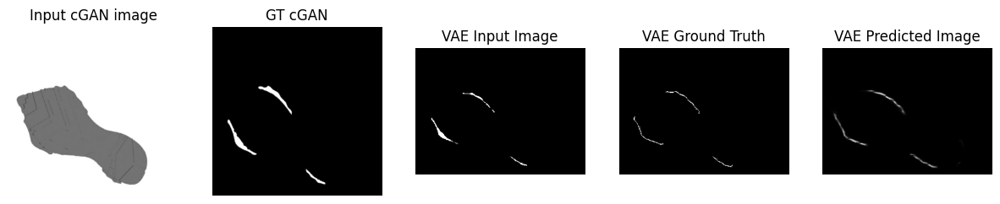

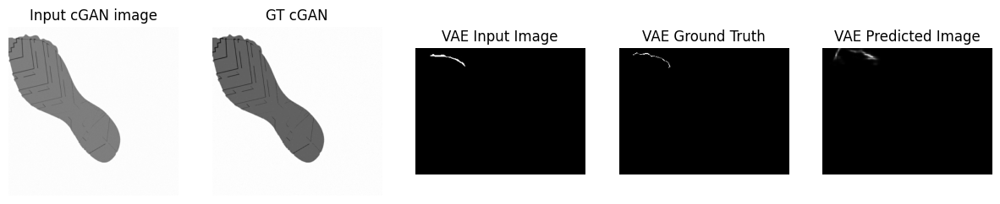

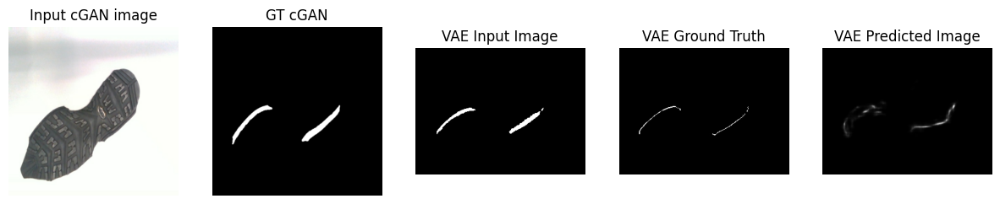

....................................................................................................Time taken for 1000 steps: 2638.92 sec

[Epochs-interval: 6/6]__Step: 121k/123k
Train set ELBO: 211.74964904785156
Train set MMD loss: 3718.8310546875
Train set GRADIENT loss: 465703.78125


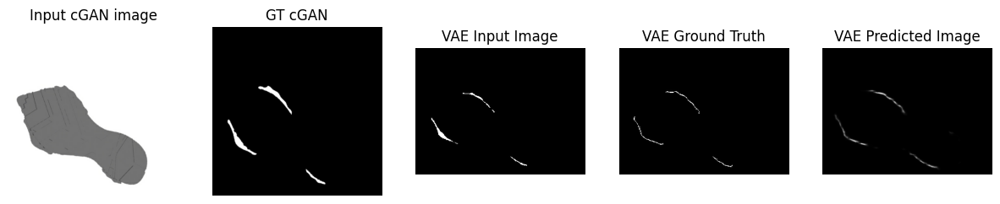

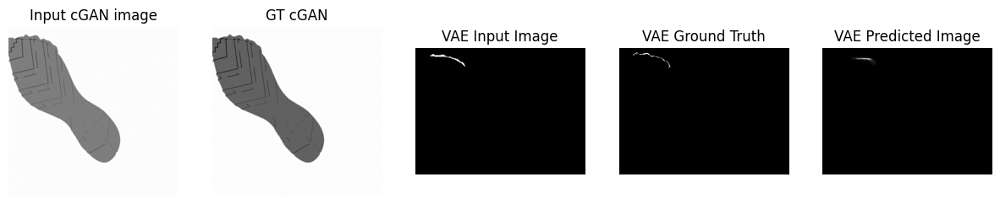

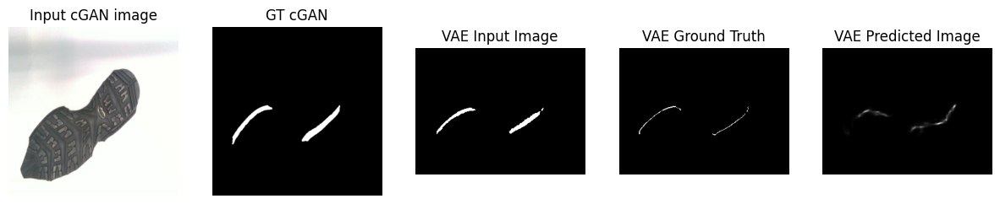

....................................................................................................Time taken for 1000 steps: 2661.63 sec

[Epochs-interval: 6/6]__Step: 122k/123k
Train set ELBO: 773.268798828125
Train set MMD loss: 2583.41552734375
Train set GRADIENT loss: 656724.1875


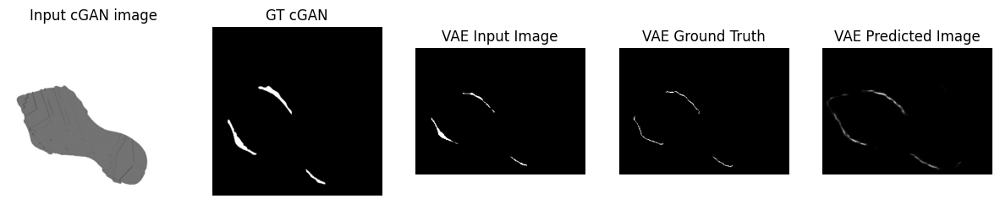

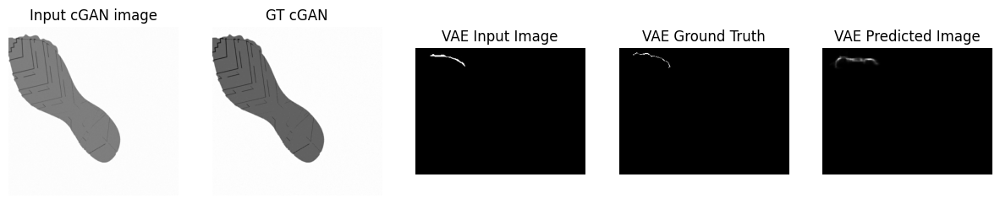

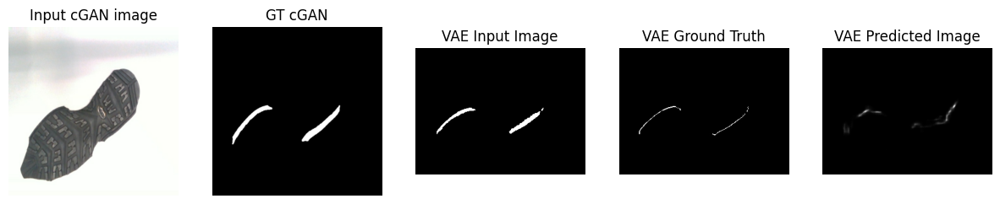

....................................................................................................

In [ ]:
# Call fit function for training the cvae
train_losses, val_losses, gazebo_losses, real_losses = fit(vae_train_dataset, vae_val_dataset, combined_test_sim, combined_test_sim_from_gazebo, combined_test_real, STEPS, epochs, checkpoint_dir, checkpoint_prefix)

# Save losses
save_list_to_pickle(train_losses, checkpoint_dir+"/loss_tot.pickle")
save_list_to_pickle(val_losses, checkpoint_dir+"/val_loss_tot.pickle")
save_list_to_pickle(gazebo_losses, checkpoint_dir+"/gazebo_loss_tot.pickle")
save_list_to_pickle(real_losses, checkpoint_dir+"/real_loss_tot.pickle")

# Save weights and optimizer's state
model.save_weights(checkpoint_prefix)

## Fine tuning
Train the cave trained on artificial simulation images with a small datset of simulation images taken directly on gazebo and some real images

In [ ]:
gazebo_sim_ds_len = check_dataset_info(vae_test_dataset_sim_from_gazebo, 'Test sim from gazebo dataset for CVAE (vae_test_dataset_sim_from_gazebo)', return_length=True)
vae_tune_dataset_sim_from_gazebo = vae_test_dataset_sim_from_gazebo.take(int(gazebo_sim_ds_len*3/5)) #30
vae_fine_tune_ds = tf.data.Dataset.concatenate(vae_tune_dataset_sim_from_gazebo, vae_train_dataset_real) # overall dtrainig datset with processed images (real+sim)


Dataset:Test sim from gazebo dataset for CVAE (vae_test_dataset_sim_from_gazebo) | Size: 50, Image resol.:(240, 320), Batch_size: 1
____________________________________________________________________________________________________________


[Epochs-interval: 0/0k]__Step: 0k
Train set ELBO: -638.9909057617188


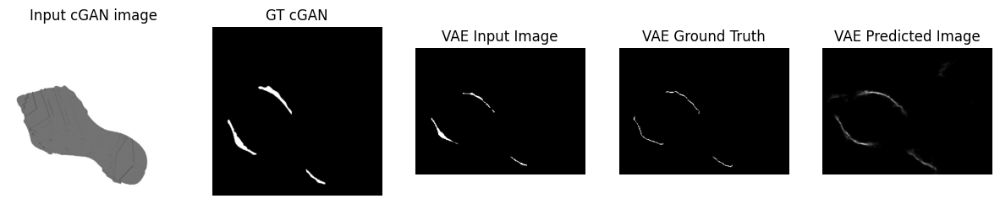

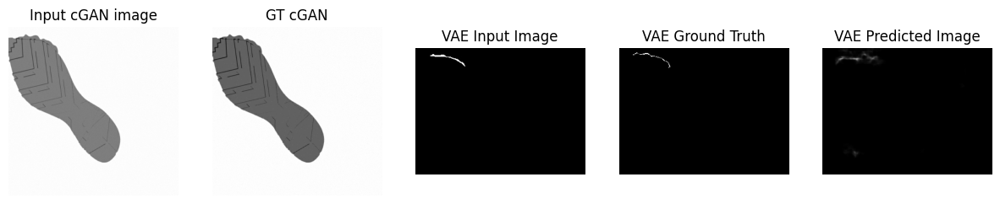

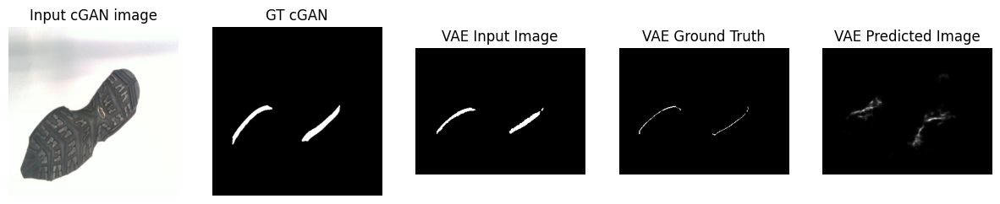

.....................................................

In [ ]:
# TRAINING settings
loss_tot = []
val_loss_tot = []

# Train autoencoder
epochs_on_ds = 1
STEPS = len(list(vae_fine_tune_ds))
EPOCHS = epochs_on_ds * STEPS


# CHECKPOINTS
# =================
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt"+"_cvae_epoch"+ str(EPOCHS) + "_latent" + str(latent_dim)+"_fine_tuning")

for i in range(EPOCHS//STEPS):

  loss_epoch, val_loss_epoch = fit(vae_fine_tune_ds, vae_val_dataset, combined_test_sim, combined_test_sim_from_gazebo, combined_test_real, steps=STEPS, phase=i+1, epochs=EPOCHS)
  #display.clear_output(wait=True)
  # Save partial loss
  loss_tot.append(loss_epoch)
  val_loss_tot.append(val_loss_epoch)

  # Save weights and optimizer's state
  model.save_weights(checkpoint_prefix)

## Results analysis

### Load checkpoints

In [ ]:
# Restoring the latest checkpoint in checkpoint_dir
model.load_weights(checkpoint_prefix)


### Plot losses (can be plotted only after complete training)

In [ ]:
# load saved losses
train_losses = load_list_from_pickle(checkpoint_dir + "/loss_tot.pickle")
val_losses = load_list_from_pickle(checkpoint_dir + "/val_loss_tot.pickle")
gazebo_losses = load_list_from_pickle(checkpoint_dir + "/gazebo_loss_tot.pickle")
real_losses = load_list_from_pickle(checkpoint_dir + "/real_loss_tot.pickle")

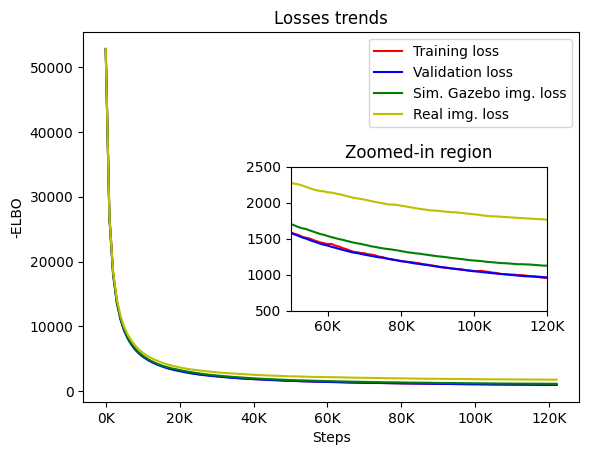

In [ ]:
# Plot losses
from matplotlib.ticker import FuncFormatter

epochs_steps = range(len((train_losses)))
# Create a figure and axis objects
fig, ax1 = plt.subplots()

# Plot original data on ax1
ax1.plot(epochs_steps, train_losses, 'r', label='Training loss')
ax1.plot(epochs_steps, val_losses, 'b', label='Validation loss')
ax1.plot(epochs_steps, gazebo_losses, 'g', label='Sim. Gazebo img. loss')
ax1.plot(epochs_steps, real_losses, 'y', label='Real img. loss')
ax1.set_xlabel('Steps')
ax1.set_ylabel('-ELBO')
ax1.set_title('Losses trends')
ax1.legend()

# Create a new set of axes for the zoomed-in region
ax2 = fig.add_axes([0.45, 0.3, 0.4, 0.3]) # [left, bottom, width, height]

# Plot zoomed-in region on ax2
ax2.plot(epochs_steps, train_losses, 'r', label='Training loss')
ax2.plot(epochs_steps, val_losses, 'b', label='Validation loss')
ax2.plot(epochs_steps, gazebo_losses, 'g', label='Sim. Gazebo img. loss')
ax2.plot(epochs_steps, real_losses, 'y', label='Real img. loss')
ax2.set_title('Zoomed-in region')
ax2.set_xlim(50, 120)  # Adjust limits to the region you want to zoom in
ax2.set_ylim(500, 2500)  # Adjust limits to the region you want to zoom in

# Function to format tick labels with 'k'
def format_k(x, pos):
    return '%1.0fK' % (x)

# Apply the formatter to the x-axis of both ax1 and ax2
ax1.xaxis.set_major_formatter(FuncFormatter(format_k))
ax2.xaxis.set_major_formatter(FuncFormatter(format_k))

plt.show()
plt.show()

### Display some test results

Test the simulated (artificial images)

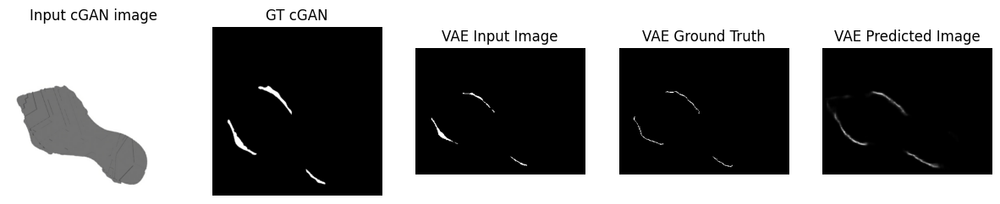

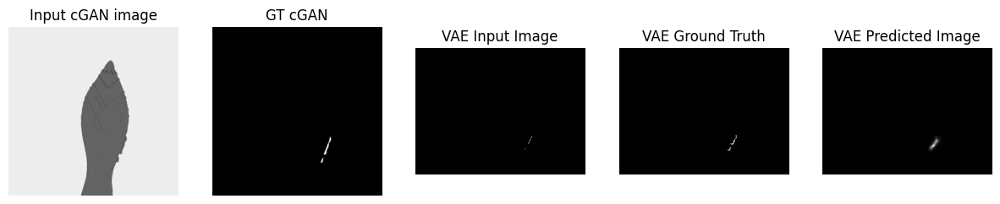

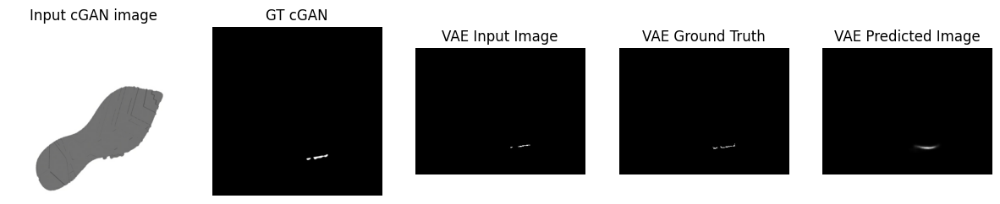

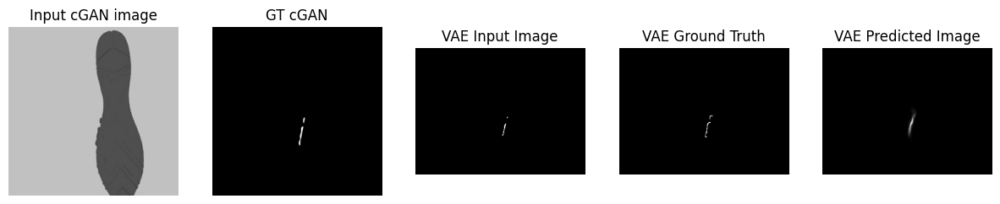

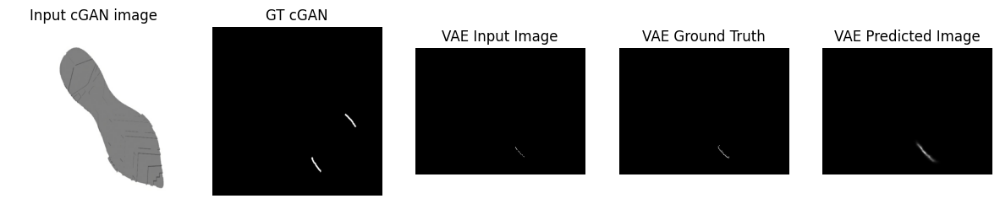

...

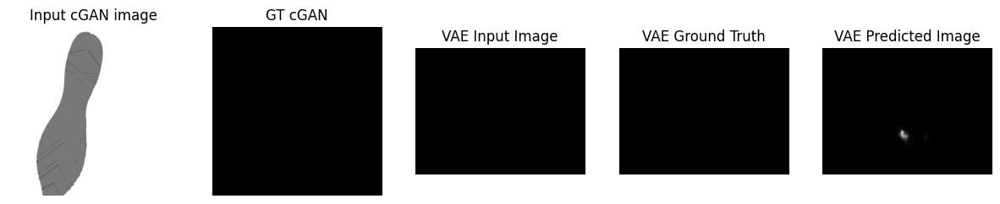

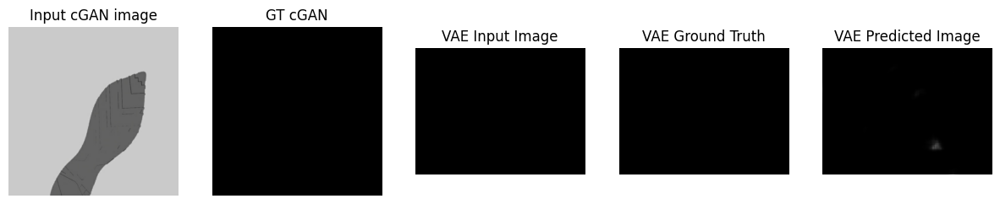

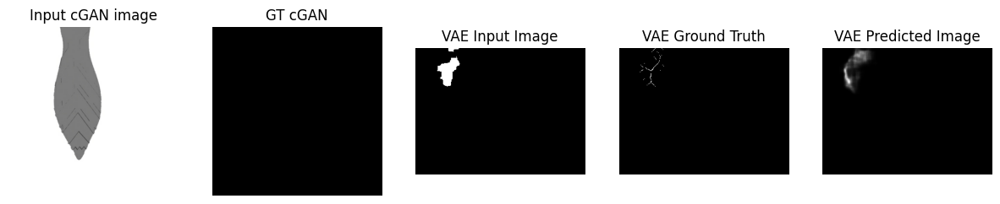

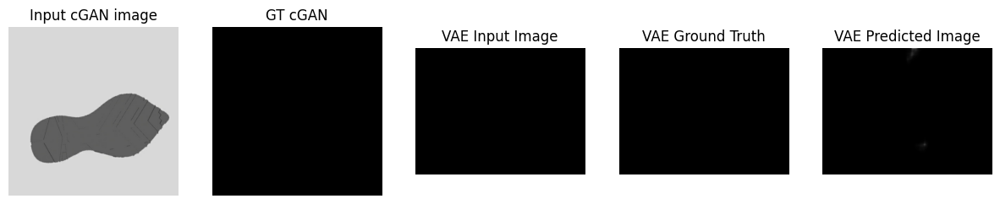

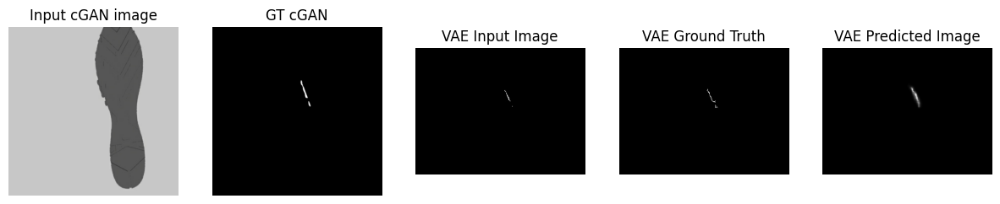

In [ ]:
# Plot test results
# Test the simulation (artificial) images
test_combined_ds = tf.data.Dataset.zip((cgan_test_dataset_sim, vae_test_dataset_sim))

for (data1, data2) in test_combined_ds:
  cgan_input_image, cgan_target = data1
  input_image, target = data2
  generate_images(model,cgan_input_image, cgan_target, input_image, target)

Test the simulated images taken directly from gazebo

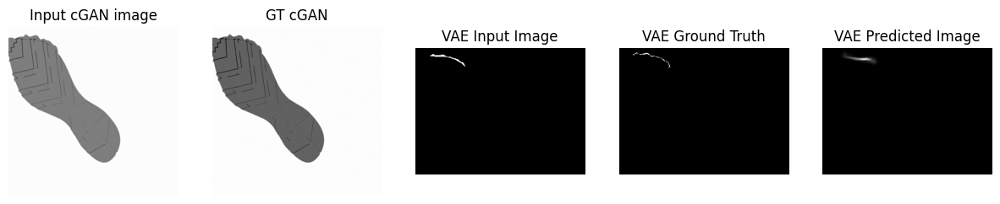

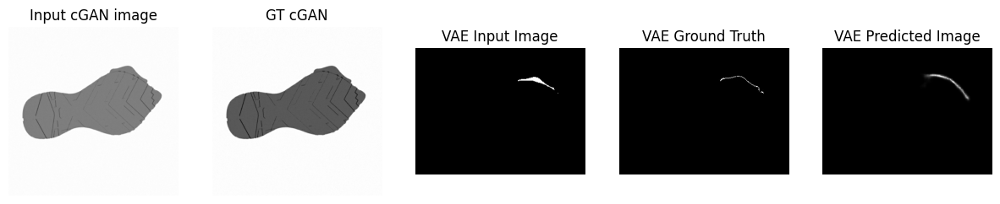

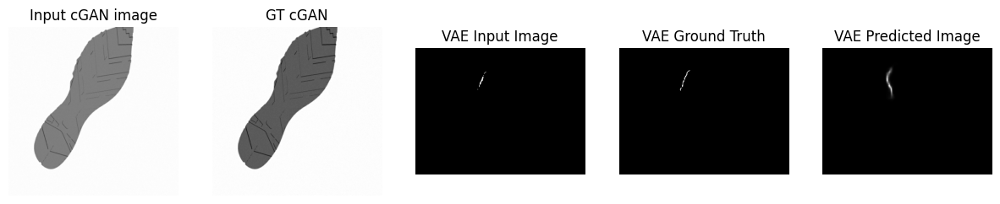

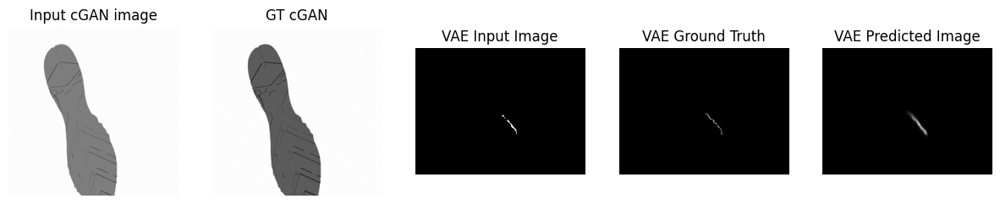

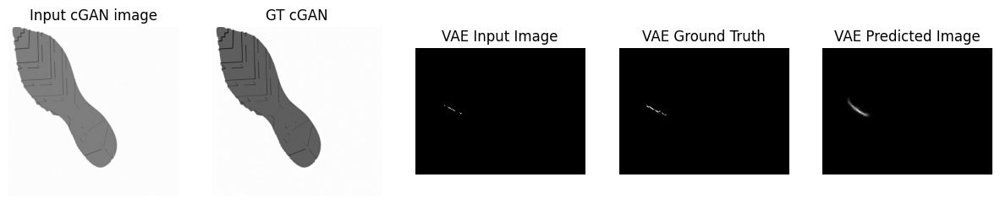

...

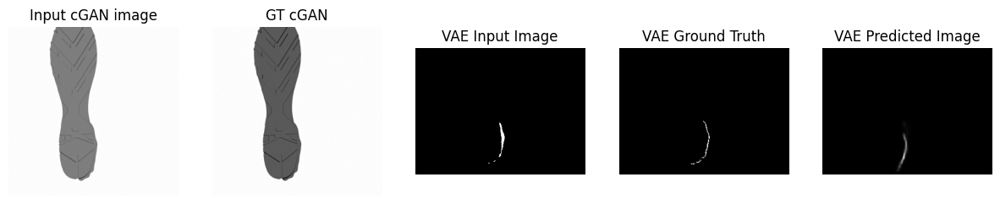

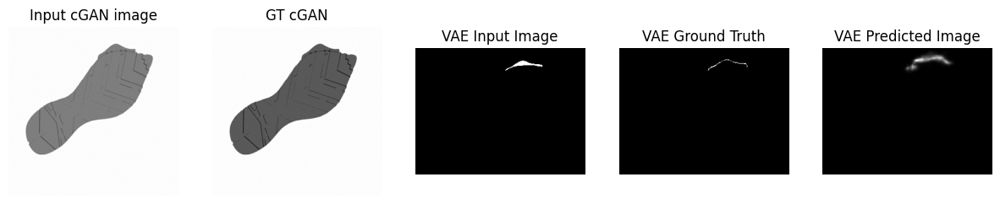

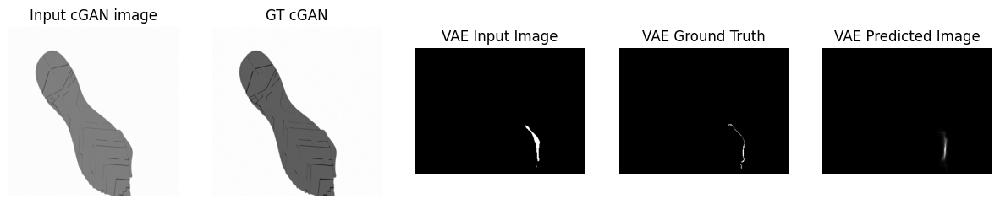

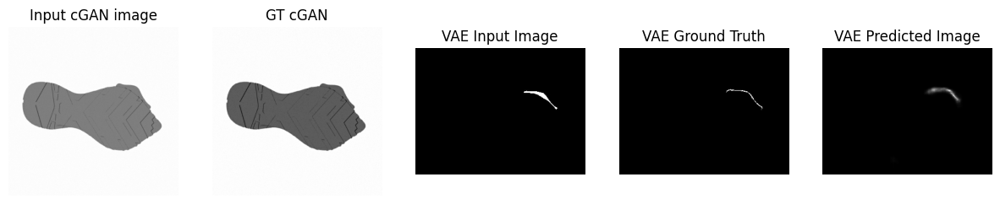

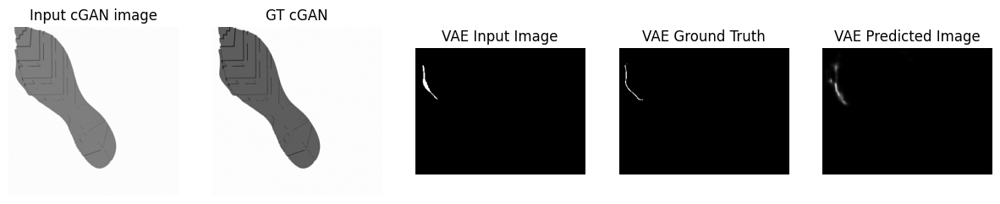

In [ ]:

test_combined_ds = tf.data.Dataset.zip((cgan_test_dataset_sim_from_gazebo, vae_test_dataset_sim_from_gazebo))

for (data1, data2) in test_combined_ds:
  cgan_input_image, cgan_target = data1
  input_image, target = data2
  generate_images(model,cgan_input_image, cgan_target, input_image, target)

Test the real images

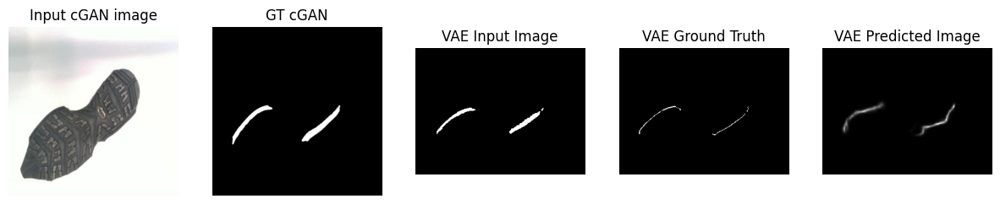

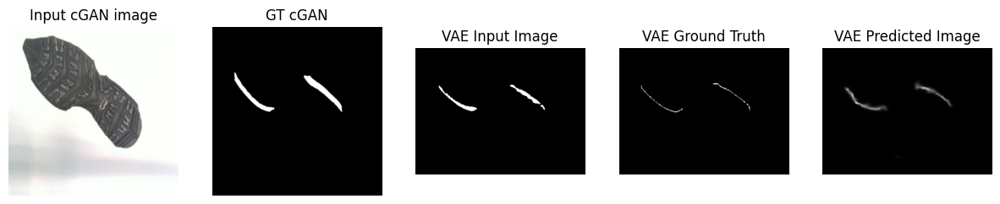

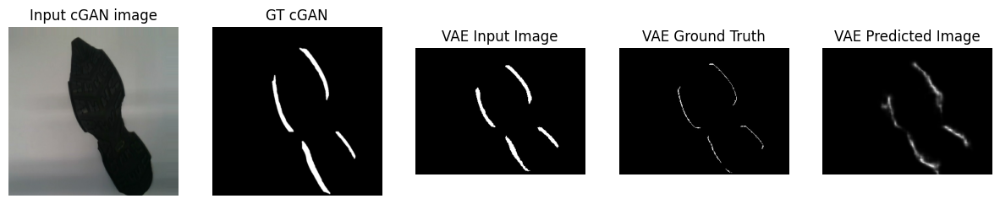

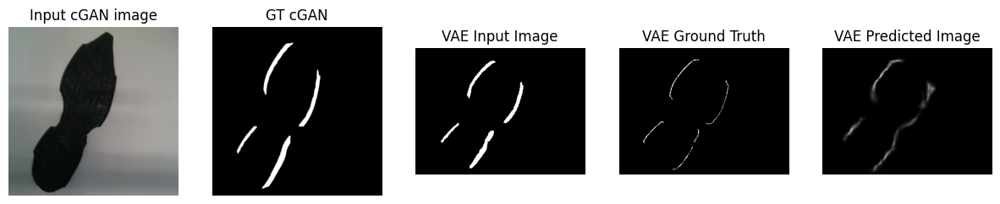

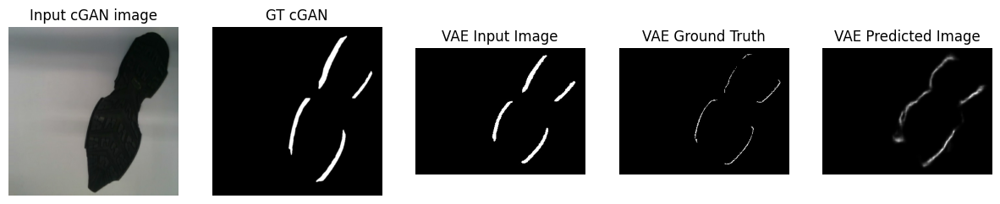

...

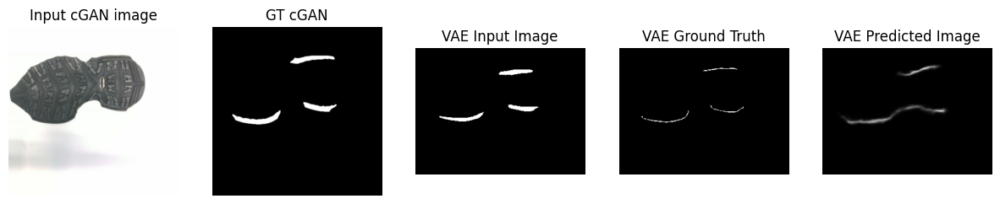

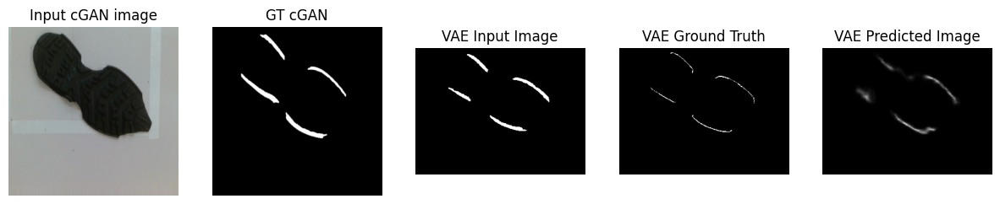

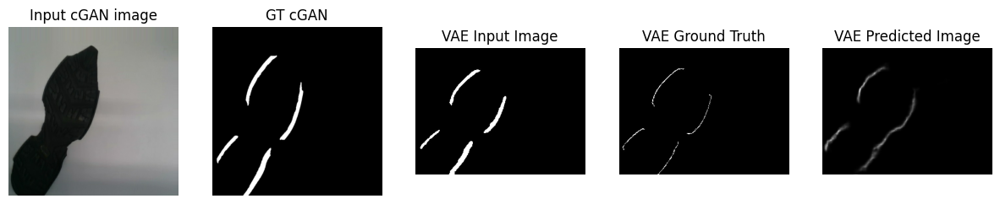

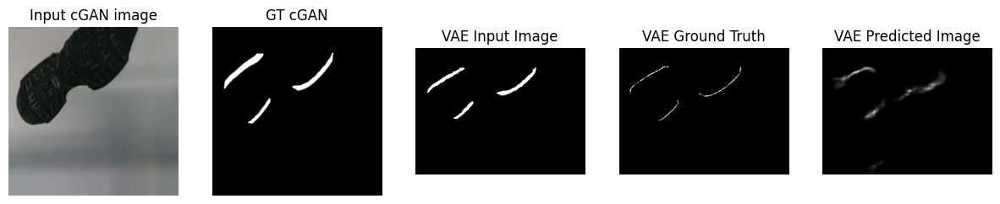

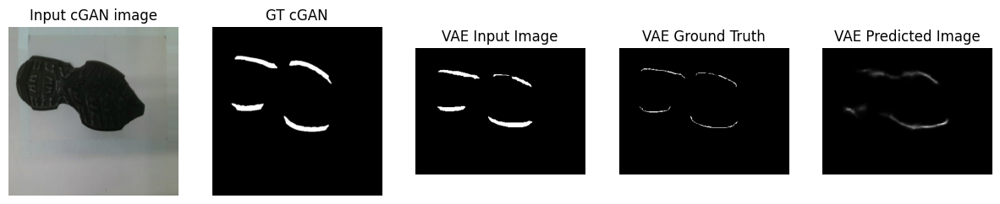

In [ ]:
# Test the real images
test_combined_ds = tf.data.Dataset.zip((cgan_test_dataset_real, vae_test_dataset_real))

for (data1, data2) in test_combined_ds:
  cgan_input_image, cgan_target = data1
  input_image, target = data2
  generate_images(model,cgan_input_image, cgan_target, input_image, target)

# Latent space Analysis

In [ ]:
dataset_latent_space = vae_train_dataset #tf.data.Dataset.concatenate(vae_val_dataset, vae_train_dataset_real) #1000 images(500 sim,500 real)
collect_l_vectors = False # (False you load them from previously saved latent_vectors)

### Visualization, encoding and decoding functions

In [ ]:
def collect_latent_vectors(model, dataset):
    latent_vectors = []
    for it, (input_image, _) in dataset.enumerate():
        # Predict latent vector using the model
        mean, logvar = model.encode(input_image)
        latent_vector = model.reparameterize(mean, logvar)
        # Append the predicted latent vector
        latent_vectors.append(latent_vector)
        if it % 1000 == 0 and it!=0:
          print(f"Collected vectors:{it//1000}k")
    # Convert to numpy array
    latent_vectors = np.array(latent_vectors)
    return latent_vectors

In [ ]:
!pip install umap-learn
import umap

def use_pca(n_reduce_comp, latent_vectors=None, latent_reduced=None, pca=None, direction='forward'):
    if direction == 'forward':
        # Apply PCA for dimensionality reduction
        pca = PCA(n_components=n_reduce_comp)
        latent_reduced = pca.fit_transform(latent_vectors)
        return pca, latent_reduced
    elif direction == 'inverse':
        # Apply inverse transformation to restore orginal latent vector dimension
        reconstructed_latent_vector = pca.inverse_transform(latent_reduced)
        return reconstructed_latent_vector

def use_umap(n_reduce_comp,  latent_vectors=None, latent_reduced=None, umap_model=None, direction='forward', n_neighbors=15):
    if direction == 'forward':
        # Apply umap for dimensionality reduction
        umap_model = umap.UMAP(n_components=n_reduce_comp)
        latent_reduced = umap_model.fit_transform(latent_vectors)
        return umap_model, latent_reduced
    elif direction == 'inverse':
        # Apply inverse transformation to restore orginal latent vector dimension
        reconstructed_latent_vector = umap_model.inverse_transform(latent_reduced)
        # Add some noise to avoid singular matrix
        reconstructed_latent_vector += np.random.normal(0, 0.1, size=reconstructed_latent_vector.shape)
        return reconstructed_latent_vector


def plot_latent_space(latent_vectors, n_blocks, n_reduce_comp, method='pca'):

    if method == 'pca':
        red_model, latent_reduced = use_pca(n_reduce_comp, latent_vectors=latent_vectors)
    if method == 'umap':
        red_model, latent_reduced = use_umap(n_reduce_comp, latent_vectors=latent_vectors)
    block_boundaries = []
    if latent_reduced.shape[1] == 2:
        latent_2d = latent_reduced
        # Plot the 2D representation of the latent space
        plt.scatter(latent_2d[:, 0], latent_2d[:, 1])
        plt.title('2D Visualization of Latent Space')
        plt.xlabel('Dimension 1')
        plt.ylabel('Dimension 2')
        plt.gca().set_aspect('equal', adjustable='box')

        # Get boundaries of each block
        x_min, x_max = latent_2d[:, 0].min(), latent_2d[:, 0].max()
        y_min, y_max = latent_2d[:, 1].min(), latent_2d[:, 1].max()

        x_step = (x_max - x_min) / np.sqrt(n_blocks)
        y_step = (y_max - y_min) / np.sqrt(n_blocks)


        for i in range(int(np.sqrt(n_blocks))):
            for j in range(int(np.sqrt(n_blocks))):
                block_boundaries.append((x_min + i * x_step, x_min + (i+1) * x_step,
                                        y_min + j * y_step, y_min + (j+1) * y_step))
                plt.axvline(x=x_min + (i+1) * x_step, color='r', linestyle='--', linewidth=0.5)
                plt.axhline(y=y_min + (j+1) * y_step, color='r', linestyle='--', linewidth=0.5)
        plt.tight_layout()
        plt.show()
    else:
        # Plot each dimension of the reduced latent space separately
        fig, axs = plt.subplots(n_reduce_comp, 1, figsize=(10, 2 * n_reduce_comp))
        for i in range(n_reduce_comp):
            axs[i].plot(latent_reduced[:, i], label=f'Dimension {i+1}')
            axs[i].set_title(f'Dimension {i+1} Spectrum')
            axs[i].set_xlabel('Samples')
            axs[i].set_ylabel('Value')
            axs[i].legend()
        plt.tight_layout()
        plt.show()

    return red_model, block_boundaries, latent_reduced

In [ ]:
# For 2d case, generate the decoded images for random points taken in each block area of the latent
def generate_gif_for_block(red_model, model, block_boundaries, saving_path, n_frames=10, frame_duration=1000, method='pca'):
    n_reduce_comp = 2 # 2d reduction case
    # Extract block boundaries
    x_min, x_max, y_min, y_max = block_boundaries

    # Generate random 2D points within the block
    random_points = []
    for _ in range(n_frames):
        x = np.random.uniform(x_min, x_max)
        y = np.random.uniform(y_min, y_max)
        random_points.append([x, y])
    random_points = np.array(random_points)

    # Create frames for the animation
    frames = []
    fig, ax = plt.subplots()
    for point in random_points:
        # Perform inverse transformation from reduced to original latent space
        if method == 'pca':
            reconstructed_latent_vector = use_pca(n_reduce_comp, latent_reduced=point.reshape(1, -1), pca=red_model, direction='inverse')
        if method == 'umap':
            reconstructed_latent_vector = use_umap(n_reduce_comp, latent_reduced=point.reshape(1, -1), umap_model=red_model, direction='inverse')

        #reconstructed_latent_vector = reconstructed_latent_vector.reshape(1, reconstructed_latent_vector.shape[0])

        # Decode the reconstructed latent vector into an image
        decoded_image = model.sample(reconstructed_latent_vector)

        # Ensure the decoded image has the correct shape and data type
        decoded_image = decoded_image.numpy()[0] # Convert to numpy array and remove single-dimensional entries

        # Display the decoded image
        ax.imshow(decoded_image, cmap='gray')
        ax.axis('off')

        # Save the current frame as a PIL image
        fig.canvas.draw()
        frame = np.array(fig.canvas.renderer.buffer_rgba())
        frame = Image.fromarray(frame)
        frames.append(frame)
    # Close the figure to prevent it from being displayed later
    plt.close(fig)
    # Save frames as GIF
    frames[0].save(saving_path, save_all=True, append_images=frames[1:], loop=0, duration=frame_duration)
    return random_points

# for pca with num_components >2
def generate_gif_for_spectrum(red_model, model, latent_red, num_components, saving_path, n_frames=10, frame_duration=1000, method='pca'):
    num_samples, total_num_components = latent_red.shape
    mean_values = np.mean(latent_red, axis=0)
    frame_points_dims = []

    for dimension in range(num_components):
        dim_rnd_points = []
        frames = []
        fig, ax = plt.subplots()

        # Generate random values for the current dimension
        min_val = np.min(latent_red[:, dimension])
        max_val = np.max(latent_red[:, dimension])

        for _ in range(n_frames):
            rand_value = np.random.uniform(min_val, max_val)
            dim_rnd_points.append(rand_value)
            frame_latent_red = mean_values.copy()
            frame_latent_red[dimension] = rand_value

            # Invert frame_latent_red to original latent dimension (frame_latent)
            if method == 'pca':
                frame_latent = use_pca(num_components, latent_reduced=frame_latent_red.reshape(1, -1), pca=red_model, direction='inverse')
            if method == 'umap':
                frame_latent = use_umap(num_components, latent_reduced=frame_latent_red.reshape(1, -1), umap_model=red_model, direction='inverse')


            # Decode frame_latent to image
            decoded_image = model.sample(frame_latent)

            # Ensure the decoded image has the correct shape and data type
            decoded_image = decoded_image.numpy()[0]

            # Display the decoded image
            ax.imshow(decoded_image, cmap='gray')
            ax.axis('off')

            # Save the current frame as a PIL image
            fig.canvas.draw()
            frame = np.array(fig.canvas.renderer.buffer_rgba())
            frame = Image.fromarray(frame)
            frames.append(frame)
        # Close the figure to prevent it from being displayed later
        plt.close(fig)
        gif_path = f"{saving_path}_dim_{dimension}.gif"
        # Save frames as GIF
        frames[0].save(gif_path, save_all=True, append_images=frames[1:], loop=0, duration=frame_duration)

        # Save the random values for this dimension
        frame_points_dims.append(dim_rnd_points)

    return frame_points_dims

In [ ]:
# for 2d case
def generate_latent_space_gif(latent_2d, random_points_blocks, saving_path, n_blocks, n_frames=10, frame_duration=1000):
    # Get boundaries of the latent space plot
    x_min, x_max = latent_2d[:, 0].min(), latent_2d[:, 0].max()
    y_min, y_max = latent_2d[:, 1].min(), latent_2d[:, 1].max()

    # Calculate the step size for each block
    x_step = (x_max - x_min) / np.sqrt(n_blocks)
    y_step = (y_max - y_min) / np.sqrt(n_blocks)

    # Create frames for the animation
    frames = []
    fig, ax = plt.subplots()
    for frame_index in range(n_frames):
        ax.clear()  # Clear the axis before plotting for each frame

        # Plot the latent space
        ax.scatter(latent_2d[:, 0], latent_2d[:, 1])

        # Add block boundaries and block numbers
        for i in range(int(np.sqrt(n_blocks))):
            for j in range(int(np.sqrt(n_blocks))):
                ax.axvline(x=x_min + (i+1) * x_step, color='r', linestyle='--', linewidth=0.5)
                ax.axhline(y=y_min + (j+1) * y_step, color='r', linestyle='--', linewidth=0.5)
                text_x = x_min + i * x_step + 0.02 * (x_max - x_min)  # Adjusting the x position
                text_y = y_min + (j+1) * y_step - 0.03 * (y_max - y_min)  # Adjusting the y position
                ax.text(text_x, text_y, f'Block {i * int(np.sqrt(n_blocks)) + j + 1}', fontsize=6)
               # Plot random points for each block for the current frame
        for block_index, random_points in enumerate(random_points_blocks):
            for point_index, (x, y) in enumerate(random_points):
                if point_index == frame_index:  # Only plot points for the current frame
                    ax.scatter(x, y, color='red')

        ax.set_title('2D Visualization of Latent Space')
        ax.set_xlabel('Dimension 1')
        ax.set_ylabel('Dimension 2')
        ax.set_aspect('equal', adjustable='box')
        ax.autoscale(True)

        # Save the current frame as a PIL image
        fig.canvas.draw()
        frame = np.array(fig.canvas.renderer.buffer_rgba())
        frame = Image.fromarray(frame)
        frames.append(frame)
    # Close the figure to prevent it from being displayed later
    plt.close(fig)
    # Save frames as GIF
    frames[0].save(saving_path, save_all=True, append_images=frames[1:], loop=0, duration=frame_duration)

#for pca with more than 2 components
def generate_gif_for_dimensions(latent_reduced, frame_points_dims, saving_path, num_components, num_frames=10, frame_duration=1000):
    for dimension in range(num_components):
        fig, ax = plt.subplots()
        frames = []
        for frame_index in range(num_frames):
            ax.clear()  # Clear the axis before plotting for each frame
            # Plot the original spectrum
            ax.plot(latent_reduced[:, dimension], color='blue', label='Original Spectrum')

            # Plot the changing values on top of the original spectrum
            changing_values = np.full_like(latent_reduced[:, dimension], frame_points_dims[dimension][frame_index])
            ax.scatter(np.arange(len(latent_reduced)), changing_values, color='red', label='Changing Value')

            # Set the title and subtitle as the plot title
            ax.set_title(f'Dimension {dimension + 1}\nFixed mean spectra values for the other latent dimensions')


            ax.set_xlabel('Samples')
            ax.set_ylabel('Value')
            ax.legend()

            # Save the current frame as a PIL image
            fig.canvas.draw()
            frame = np.array(fig.canvas.renderer.buffer_rgba())
            frame = Image.fromarray(frame)
            frames.append(frame)

        # Close the figure to prevent it from being displayed later
        plt.close(fig)

        # Save frames as GIF
        gif_path = f"{saving_path}_dim_{dimension}.gif"
        frames[0].save(gif_path, save_all=True, append_images=frames[1:], loop=0, duration=frame_duration)


In [ ]:
# for 2d components
def display_latent_space_and_block_gifs(latent_space_gif_path, block_gif_paths, n_blocks):
    # Calculate number of rows and columns for the grid
    rows = int(np.ceil(np.sqrt(n_blocks)))
    cols = int(np.ceil(n_blocks / rows))

    # Create HTML content for the latent space GIF and grid of block GIFs
    html_content = f'<div style="display: flex;">'

    # Latent space GIF
    with open(latent_space_gif_path, "rb") as f:
        latent_space_gif_data = base64.b64encode(f.read()).decode("utf-8")
    html_content += f'<div style="margin-right: 20px;"><img src="data:image/gif;base64,{latent_space_gif_data}"></div>'

    # Grid of block GIFs
    html_content += '<div>'
    html_content += '<table style="border-collapse: collapse;">'
    for row in range(rows):
        html_content += '<tr>'
        for col in range(cols):
            block_index = col * rows + (rows - row)
            if block_index <= n_blocks:
                gif_index = block_index - 1
                with open(block_gif_paths[gif_index], "rb") as f:
                    gif_data = base64.b64encode(f.read()).decode("utf-8")
                html_content += f'<td style="border: 1px solid black; text-align: center;">Block {block_index}<br><img src="data:image/gif;base64,{gif_data}" width="200" height="200"></td>'
        html_content += '</tr>'
    html_content += '</table>'
    html_content += '</div>'

    # Close the flex container
    html_content += '</div>'

    # Display the HTML content
    display(HTML(html_content))

# for pca num_components>2
def display_latent_space_and_decoded_gifs(latent_gif_path, decoded_gif_path,  num_components):
    # Create HTML content for the latent space GIFs and decoded GIFs
    html_content = ''

    for i in range(num_components):
        latent_path = f"{latent_gif_path}_dim_{i}.gif"
        decoded_path = f"{decoded_gif_path}_dim_{i}.gif"

        # Latent space GIF
        with open(latent_path, "rb") as f_latent:
            latent_gif_data = base64.b64encode(f_latent.read()).decode("utf-8")

        # Decoded GIF
        with open(decoded_path, "rb") as f_decoded:
            decoded_gif_data = base64.b64encode(f_decoded.read()).decode("utf-8")

        # Construct HTML for the current dimension
        html_content += f'<div style="display: flex; margin-bottom: 20px;">'
        html_content += f'<div style="margin-right: 20px;"><img src="data:image/gif;base64,{latent_gif_data}"></div>'
        html_content += f'<div><img src="data:image/gif;base64,{decoded_gif_data}"></div>'
        html_content += f'</div>'

    # Display the HTML content
    display(HTML(html_content))

In [ ]:
# to check the performance and original reconstruction capability of the pca
def check_reduction(latent_vectors, latent_red, red_model, model, method='pca'):
    # Select a latent vector randomly
    random_index = np.random.randint(len(latent_vectors))
    latent_vector = latent_vectors[random_index]

    # Decode image directly from the selected latent vector
    decoded_direct = model.sample(latent_vector.reshape(1, -1)).numpy()[0]

    # Perform reduction and inverse transform
    latent_red_vec = latent_red[random_index]
    num_red_comp = len(latent_red_vec)
    print('Length of latent_vector before reduction:', len(latent_vector))
    print('Length of latent_vector after reduction:', num_red_comp )

    # Invert reduced latent vector to original latent dimension
    if method == 'pca':
        reconstructed_latent_vector = use_pca(num_red_comp, latent_reduced=latent_red_vec.reshape(1, -1), pca=red_model, direction='inverse')
    if method == 'umap':
        reconstructed_latent_vector = use_umap(num_red_comp, latent_reduced=latent_red_vec.reshape(1, -1), umap_model=red_model, direction='inverse')


    # Decode image from the reconstructed latent vector
    decoded_from_inv_t = model.sample(reconstructed_latent_vector).numpy()[0]

    # Plot images side by side
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].imshow(decoded_direct, cmap='gray')
    axes[0].set_title('Decoded Directly from Latent Vector')
    axes[0].axis('off')
    axes[1].imshow(decoded_from_inv_t, cmap='gray')
    axes[1].set_title('Decoded from reduced-transformed Latent Vector')
    axes[1].axis('off')
    plt.show()


Interactive sliders for pca with num_components>2

In [ ]:
def generate_decoded_image(latent_reduced, red_model, model, values, output_widget, method='pca'):

    #print("Values:", values)
    # Create a latent vector using the provided values
    latent_vector = np.array(values)
    # Invert reduced latent vector to original latent dimension
    if method == 'pca':
        reconstructed_latent_vector = use_pca(len(latent_vector), latent_reduced=latent_vector.reshape(1, -1), pca=red_model, direction='inverse')
    if method == 'umap':
        reconstructed_latent_vector = use_umap(len(latent_vector), latent_reduced=latent_vector.reshape(1, -1), umap_model=red_model, direction='inverse')

    # Decode the reconstructed latent vector into an image
    decoded_image = model.sample(reconstructed_latent_vector)

    # Ensure the decoded image has the correct shape and data type
    decoded_image = decoded_image.numpy()[0]

    # Display the decoded image
    with output_widget:
        clear_output(wait=True)
        plt.imshow(decoded_image, cmap='gray')
        plt.axis('off')
        plt.show()

def generate_slider_for_dimension(latent_reduced, red_model, model, num_components, method='pca'):
    # Create initial values for the latent vector (mean values for other dimensions)
    initial_values = [np.mean(latent_reduced[:, d]) for d in range(num_components)]

    # Create a slider widget for each dimension
    sliders = []
    for i in range(num_components):
        slider = widgets.FloatSlider(
            value=initial_values[i],
            min=np.min(latent_reduced[:, i]),
            max=np.max(latent_reduced[:, i]),
            description=f'Dimension {i+1}:',
            continuous_update=True,
            orientation='horizontal'  # Change orientation to horizontal
        )
        sliders.append(slider)

    # Create a box layout to arrange the sliders vertically
    sliders_layout = widgets.VBox(sliders, layout=widgets.Layout(
        display='flex',
        flex_flow='column',
        align_items='stretch',
        width='auto'
    ))

    # Create an output widget to display the decoded image
    output_widget = widgets.Output()

    # Define function to update decoded image based on slider values
    def update_image(*args):
        values = [slider.value for slider in sliders]
        generate_decoded_image(latent_reduced, red_model, model, values, output_widget, method=method)

    # Link sliders to update function
    for slider in sliders:
        slider.observe(update_image, names='value')

    # Display sliders vertically stacked on the left and the image on the right
    display(widgets.HBox([sliders_layout, output_widget], layout=widgets.Layout(
        display='flex',
        flex_flow='row',
        align_items='stretch',
        width='auto'
    )))


### Latent space visualization

In [ ]:
# Collect latent vectors from the dataset (the larger the datset the slower the collection process)
if collect_l_vectors:
  latent_vectors = collect_latent_vectors(model, dataset_latent_space)
  latent_vectors = latent_vectors.reshape(latent_vectors.shape[0], -1)
  save_list_to_pickle(latent_vectors, checkpoint_dir+"/latent_vector_ds.pickle")
else:
  latent_vectors = load_list_from_pickle(checkpoint_dir + "/latent_vector_ds.pickle")

print('Collected latent_vector shape: ', latent_vectors.shape)

Collected latent_vector shape:  (20500, 50)


### Use CompressionVAE to embed the latent vector into 2d dimension

### Train a small VAE to reduce the latent vectors to 2d dimension (for visualization)

In [ ]:
class LatentReducer(tf.keras.Model):
    """Autoencoder for reducing latent dimensionality."""

    def __init__(self, num_components):
        super(LatentReducer, self).__init__()
        self.num_components = num_components

        # Encoder
        self.encoder = tf.keras.Sequential([
            tf.keras.layers.InputLayer(input_shape=(latent_dim,)),
            tf.keras.layers.Dense(64, activation='relu'),
            tf.keras.layers.Dense(32, activation='relu'),
            tf.keras.layers.Dense(16, activation='relu'),
            tf.keras.layers.Dense(8, activation='relu'),
            tf.keras.layers.Dense(num_components * 2),
        ])

        # Decoder
        self.decoder = tf.keras.Sequential([
            tf.keras.layers.InputLayer(input_shape=(num_components,)),
            tf.keras.layers.Dense(8, activation='relu'),
            tf.keras.layers.Dense(16, activation='relu'),
            tf.keras.layers.Dense(32, activation='relu'),
            tf.keras.layers.Dense(64, activation='relu'),
            tf.keras.layers.Dense(latent_dim),
        ])

    @tf.function
    def sample(self, eps=None):
        if eps is None:
            eps = tf.random.normal(shape=(100, self.num_components))
        return self.decode(eps, apply_sigmoid=True)

    def encode(self, x):
        mean, logvar = tf.split(self.encoder(x), num_or_size_splits=2, axis=1)
        return mean, logvar

    def reparameterize(self, mean, logvar):
        eps = tf.random.normal(shape=mean.shape)
        return eps * tf.exp(logvar * .5) + mean

    def decode(self, z, apply_sigmoid=False):
        logits = self.decoder(z)
        if apply_sigmoid:
            probs = tf.sigmoid(logits)
            return probs
        return logits



# Loss functions and training fucntions

def log_normal_pdf(sample, mean, logvar, raxis=1):
    log2pi = tf.math.log(2. * np.pi)
    return tf.reduce_sum(
        -.5 * ((sample - mean) ** 2. * tf.exp(-logvar) + logvar + log2pi),
        axis=raxis)


def latent_reducer_loss_function(model, x):
    mean, logvar = model.encode(x)
    z = model.reparameterize(mean, logvar)
    x_recon = model.decode(z)
    mse_loss = tf.reduce_mean(tf.square(x - x_recon))
    return mse_loss


def initialize_latent_reducer(num_components, learning_rate):
    model = LatentReducer(num_components)
    optimizer = tf.keras.optimizers.Adam(learning_rate)
    return model, optimizer

@tf.function
def reducer_train_step(model, optimizer, x):
    with tf.GradientTape() as tape:
        loss = latent_reducer_loss_function(model, x)
    gradients = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(gradients, model.trainable_variables))
    return loss

def fit_latent_reducer(model, optimizer, latent_vectors, epochs):
    dataset = tf.data.Dataset.from_tensor_slices(latent_vectors)
    loss = tf.keras.metrics.Mean()

    for epoch in range(epochs):
        for step, latent_vector in dataset.enumerate():
            latent_vector = tf.expand_dims(latent_vector, axis=0)
            loss_value = reducer_train_step(model, optimizer, latent_vector)
            loss(loss_value)
            if step % 1000 == 0 and step != 0:
                print('Epoch: {}, Step: {}k, Loss: {}'.format(epoch+1, step//1000, loss.result()))
        print('Epoch: {}, Loss: {}'.format(epoch+1, loss.result()))

        # Save weights and optimizer's state
        # Create the directory
        latent_dir_path = os.path.join(checkpoint_dir, '/LatentReducer')

        # Check if the directory already exists
        if not os.path.exists(latent_dir_path):
            # Create the directory
            os.makedirs(latent_dir_path)
        checkpoint_prefix = os.path.join(latent_dir_path, "ckpt"+"_latent_red_epoch"+ str(epochs) + "_2d_components")
        model.save_weights(checkpoint_prefix)


In [ ]:
num_components = 5 # aim to 2d visualization
learning_rate = 1e-3
reducer_model, red_optimizer = initialize_latent_reducer(num_components, learning_rate)

In [ ]:
red_epochs = 2
fit_latent_reducer(reducer_model, red_optimizer, latent_vectors, red_epochs)

Epoch: 1, Step: 1k, Loss: 1.0297796726226807
Epoch: 1, Step: 2k, Loss: 1.0193521976470947
Epoch: 1, Step: 3k, Loss: 1.0086491107940674
Epoch: 1, Step: 4k, Loss: 0.9944285154342651
Epoch: 1, Step: 5k, Loss: 0.9944236874580383
Epoch: 1, Step: 6k, Loss: 0.9817689061164856
Epoch: 1, Step: 7k, Loss: 0.9691814184188843
Epoch: 1, Step: 8k, Loss: 0.9651795029640198
Epoch: 1, Step: 9k, Loss: 0.9592522382736206
Epoch: 1, Step: 10k, Loss: 0.9501111507415771
Epoch: 1, Step: 11k, Loss: 0.9466682076454163
Epoch: 1, Step: 12k, Loss: 0.940107524394989
Epoch: 1, Step: 13k, Loss: 0.9357641339302063
Epoch: 1, Step: 14k, Loss: 0.9315017461776733
Epoch: 1, Step: 15k, Loss: 0.9275216460227966
Epoch: 1, Step: 16k, Loss: 0.921484649181366
Epoch: 1, Step: 17k, Loss: 0.9168940782546997
Epoch: 1, Step: 18k, Loss: 0.9123450517654419
Epoch: 1, Step: 19k, Loss: 0.9079434871673584
Epoch: 1, Step: 20k, Loss: 0.9042915105819702
Epoch: 1, Loss: 0.9074757099151611
Epoch: 2, Step: 1k, Loss: 0.904232919216156
Epoch: 2, St

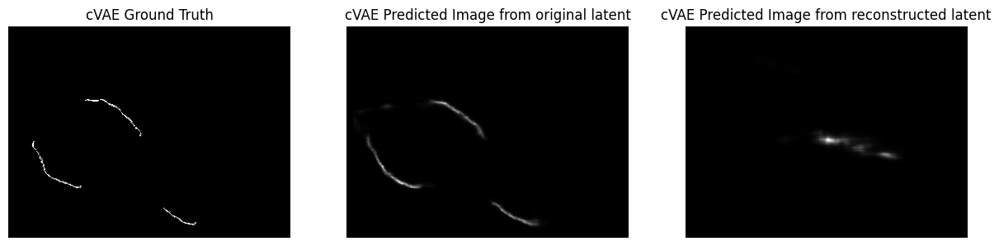

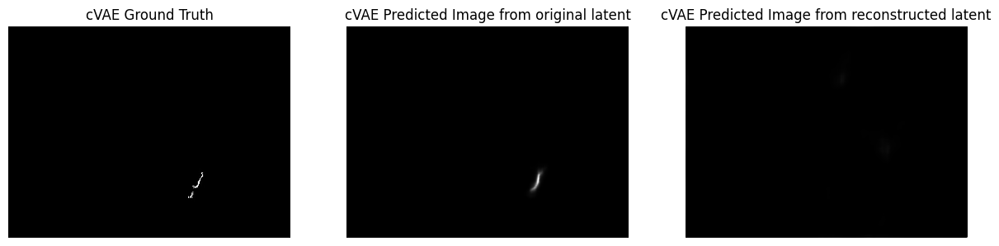

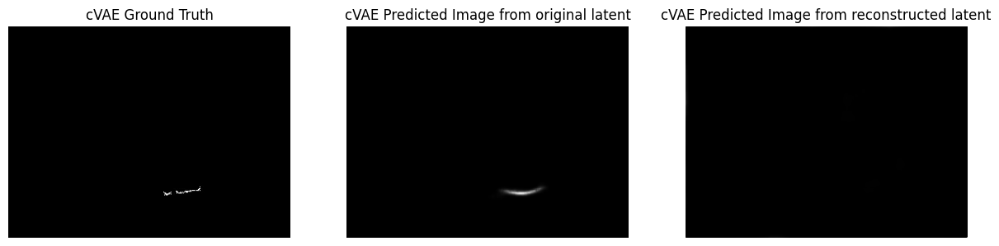

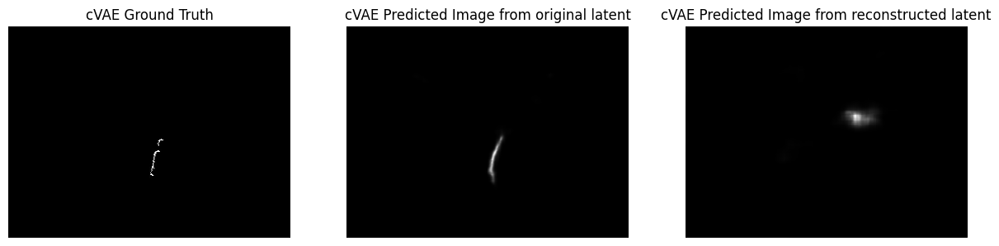

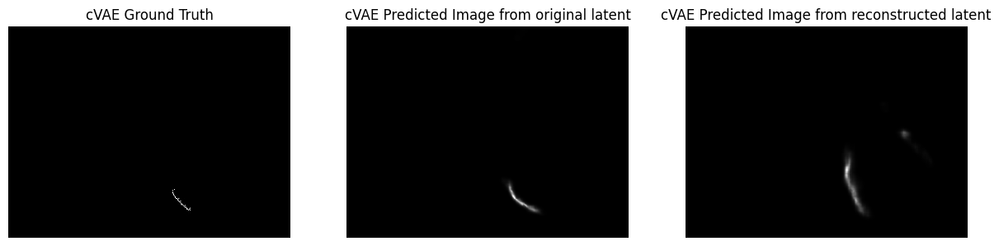

...

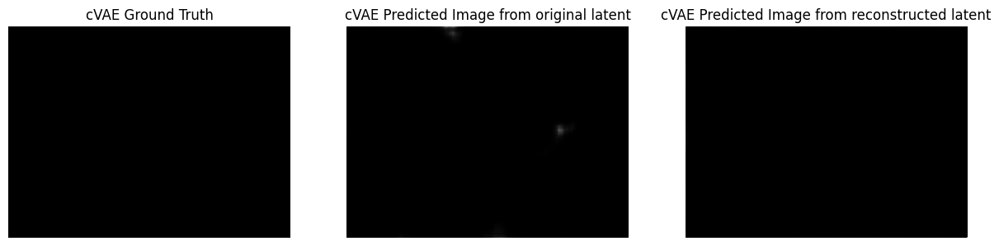

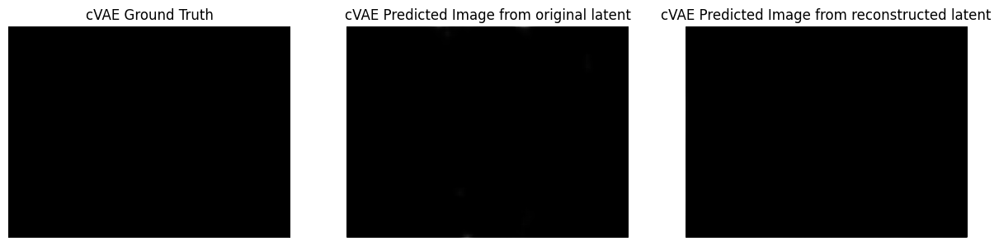

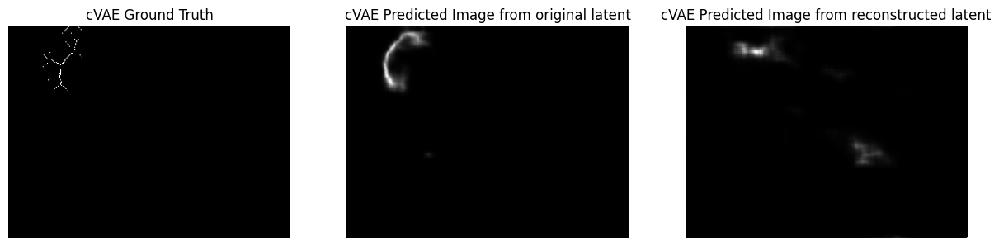

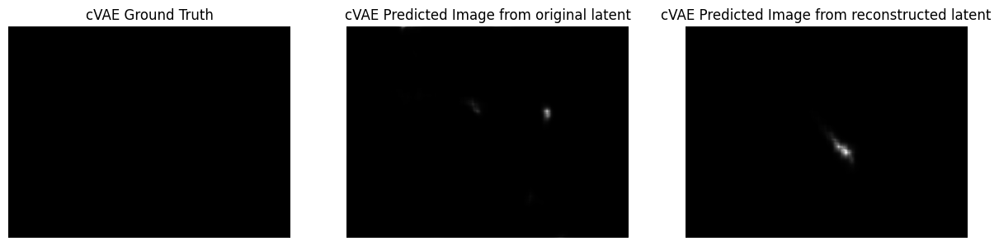

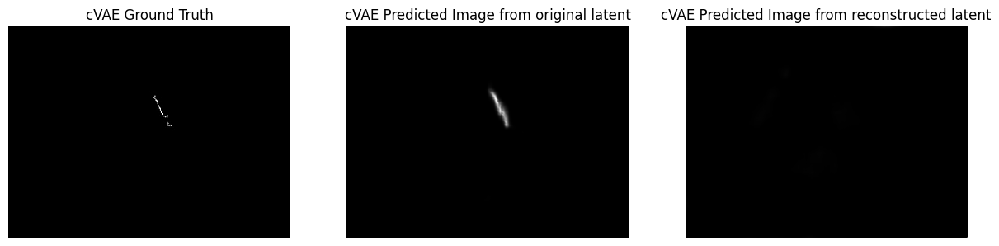

In [ ]:
# test the trained LatentReducer network

def test_latent_reducer(cvae, red_model, test_img_ds):
  # extract the test latent ds (of original length: latent_dim)
  test_latent_vectors = collect_latent_vectors(model, test_img_ds)
  #test_latent_vectors = test_latent_vectors.reshape(test_latent_vectors.shape[0], -1)
  latent_ds = tf.data.Dataset.from_tensor_slices(test_latent_vectors)
  test_combined_ds = tf.data.Dataset.zip((test_img_ds, latent_ds))
  for (data1, data2) in test_combined_ds:
      input_image, target = data1
      test_latent_v = data2
      # reconstruct latent vector of latent_dim with the traine LatentReducer
      mean, logvar = red_model.encode(test_latent_v)
      z = red_model.reparameterize(mean, logvar)
      long_latent_v = red_model.decode(z)
      # use the reconstructed latent vector of latent_dim to decode the image
      cvae_decoded_from_original = cvae.sample(test_latent_v)
      cvae_decoded_from_long = cvae.sample(long_latent_v)
      # show the
      plt.figure(figsize=(15, 15))
      display_list = [target[0], cvae_decoded_from_original[0], cvae_decoded_from_long[0]]
      title = ['cVAE Ground Truth', 'cVAE Predicted Image from original latent', 'cVAE Predicted Image from reconstructed latent']

      for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i], cmap='gray')
        plt.axis('off')
      plt.show()

test_latent_reducer(model, reducer_model,  vae_test_dataset_sim)

### Apply trained LatentReducer network to reduce latent vector dimension

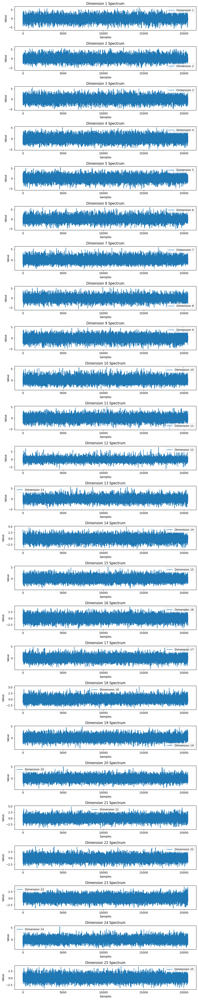

In [ ]:
# Plot latent space and get block boundaries
METHOD='pca' # reduction method (pca, umap) [PCA is faster and better, umap is suggested for a small numebr of components]
n_blocks=25 # divide the plot in n_blocks area for later 2D visualization (only if num_components=2)
n_reduce_comp = 25 # dimension of the reduced latent vectors
red_model, block_boundaries, latent_red = plot_latent_space(latent_vectors, n_blocks, n_reduce_comp, method=METHOD)



Check how the reduced representation affected the latent encoding

Length of latent_vector before reduction: 50
Length of latent_vector after reduction: 25


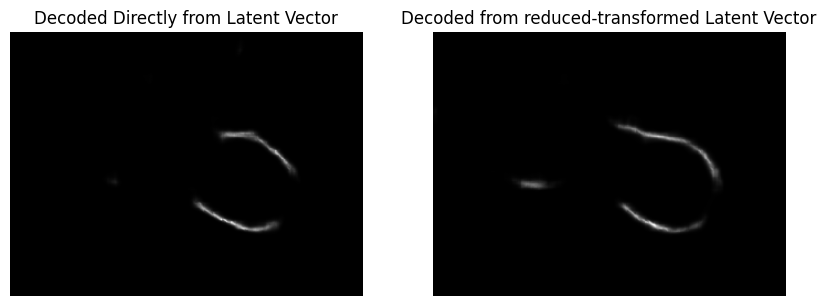

In [ ]:
check_reduction(latent_vectors, latent_red, red_model, model,method=METHOD)

In [ ]:
# Generate GIFs for each block
block_gif_paths = []
random_points_blocks = []
# Generate GIF for latent space
latent_space_gif_path = 'latent_space.gif'
if n_reduce_comp==2: # if it's actually 2d
  for i in range(n_blocks):
      block_gif_path = f'block_{i}.gif'
      random_points_per_block = generate_gif_for_block(red_model, model, block_boundaries[i], block_gif_path, n_frames=10, frame_duration=1000, method=METHOD) # random_point_per_block.shape = (n_frames,2)
      block_gif_paths.append(block_gif_path)
      random_points_blocks.append(random_points_per_block)
  generate_latent_space_gif(latent_red, random_points_blocks, latent_space_gif_path, n_blocks, n_frames=10, frame_duration=1000)
else:
  decode_path_name = 'decoded'
  latent_path_name = 'latent'
  random_values_for_dims = generate_gif_for_spectrum(red_model, model, latent_red, n_reduce_comp, decode_path_name, n_frames=10, frame_duration=1000, method=METHOD)
  generate_gif_for_dimensions(latent_red, random_values_for_dims, latent_path_name, n_reduce_comp,num_frames=10, frame_duration=1000)


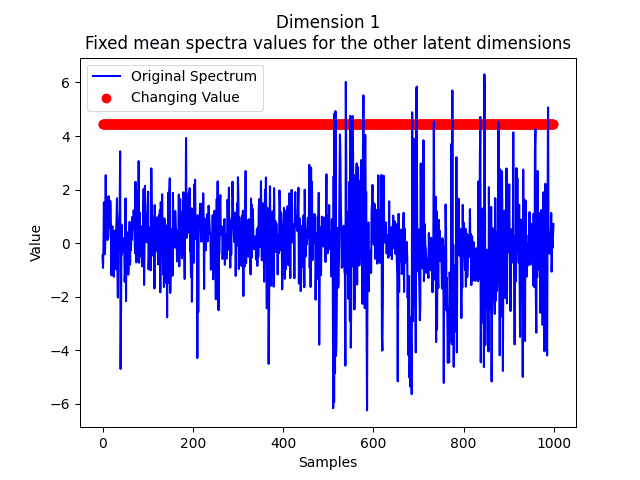
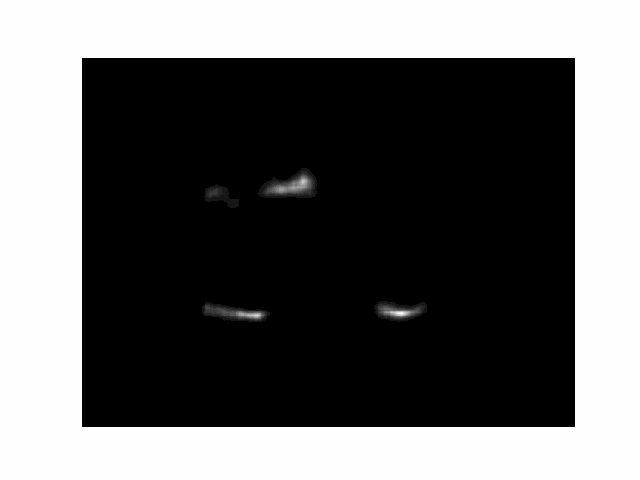
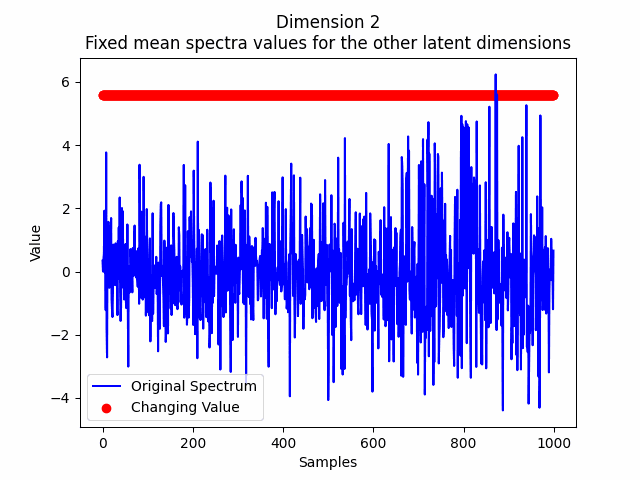
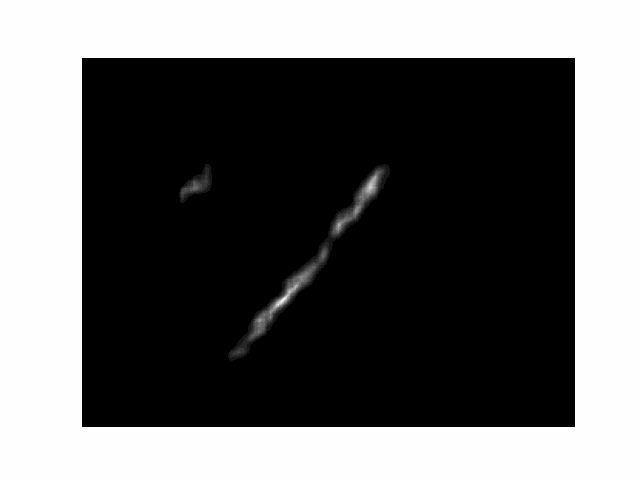
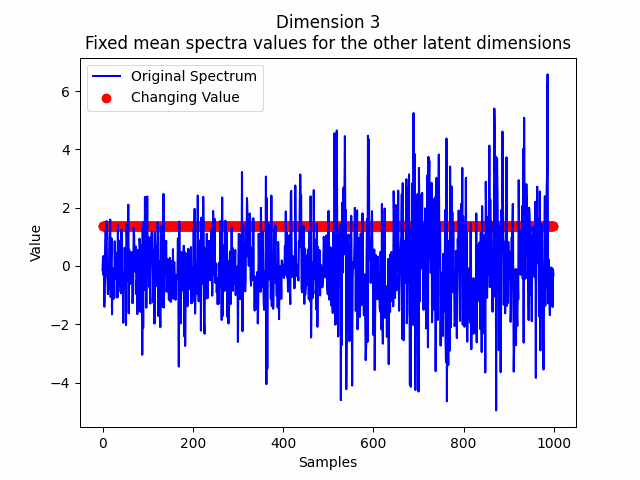
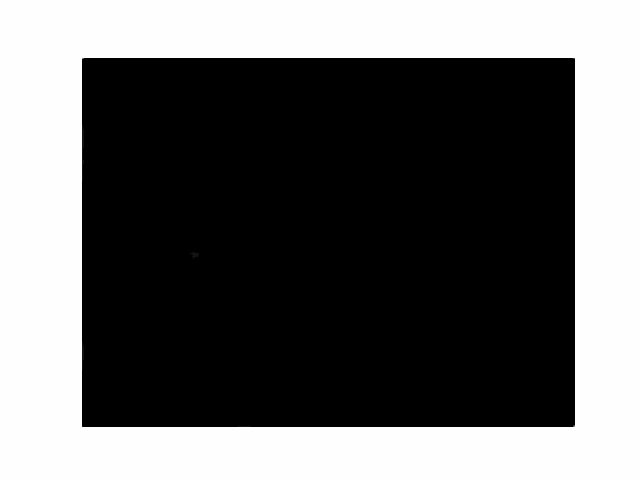
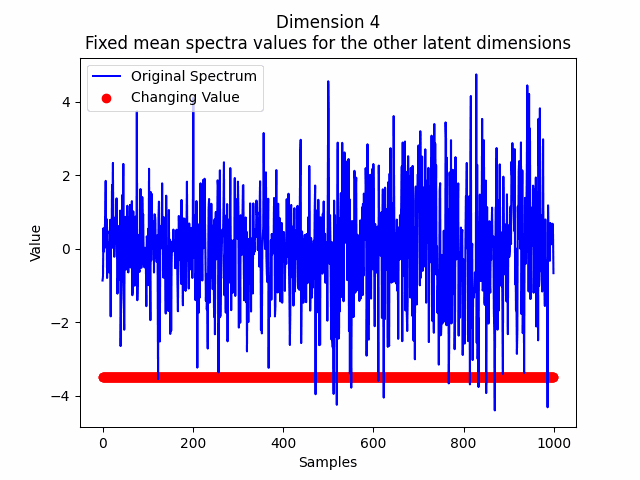
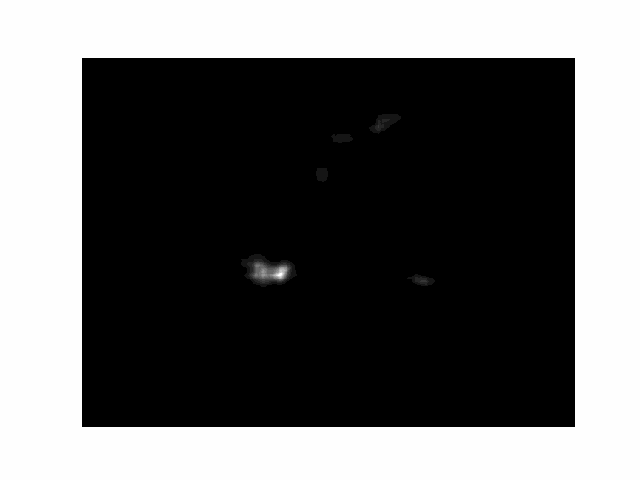
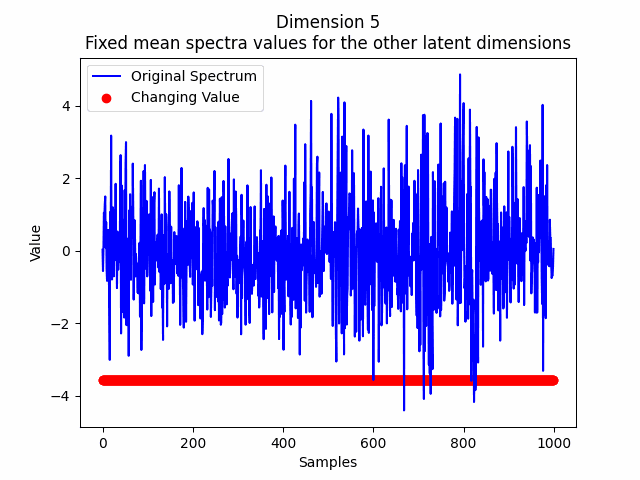
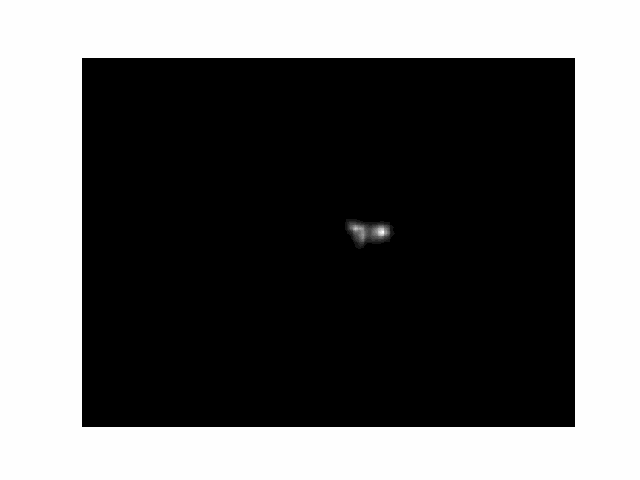

In [ ]:
# Display latent space and block GIFs
if n_reduce_comp==2: # if it's actually 2d
  display_latent_space_and_block_gifs(latent_space_gif_path, block_gif_paths, n_blocks)
else:
  display_latent_space_and_decoded_gifs(latent_path_name, decode_path_name,  n_reduce_comp)

In [ ]:
if n_reduce_comp>2:
  generate_slider_for_dimension(latent_red, red_model, model, n_reduce_comp, method=METHOD)